In [1]:
import torch.nn as nn
import torch.nn.functional as F
import torch

import sys 
import numpy as np 
import matplotlib.pyplot as plt

from torch.utils.data.sampler import SubsetRandomSampler
import torch
import torchvision 
import torch.optim as optim
import torch.nn as nn
from torch.autograd import Variable
from six import add_metaclass
from contextlib import contextmanager
import random
import pickle
import os
import time
import functools

print("Python: %s" % sys.version)
print("Pytorch: %s" % torch.__version__)

Python: 3.6.10 |Anaconda, Inc.| (default, Mar 25 2020, 23:51:54) 
[GCC 7.3.0]
Pytorch: 1.3.1


Files already downloaded and verified
Files already downloaded and verified


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


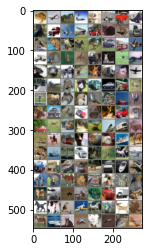

In [2]:
batch_size = 128
# determine device to run network on (runs on gpu if available)
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

# define series of transforms to pre process images 
transform = torchvision.transforms.Compose([
    torchvision.transforms.ToTensor(),

    torchvision.transforms.Normalize((0.4914, 0.4822, 0.4465), (0.2023, 0.1994, 0.2010))
])
    

classes = ["airplane", "automobile", "bird", "cat", "deer", "dog", "frog", "horse", "ship", "truck"]

# load training set 
cifar10_trainset = torchvision.datasets.CIFAR10('/home/fmejia/fmejia/Cypercat/cyphercat/datasets//', train=True, transform=transform, download=True)
cifar10_trainloader = torch.utils.data.DataLoader(cifar10_trainset, batch_size=batch_size, shuffle=True, num_workers=2)

# load test set 
cifar10_testset = torchvision.datasets.CIFAR10('/home/fmejia/fmejia/Cypercat/cyphercat/datasets//', train=False, transform=transform, download=True)
cifar10_testloader = torch.utils.data.DataLoader(cifar10_testset, batch_size=batch_size, shuffle=True, num_workers=2)

testset_list = []
test_batch_size = 128
for i in range(int(5 * test_batch_size / batch_size)):
    testset_list.append(cifar10_testset)

cifar10_testset5 = torch.utils.data.ConcatDataset(testset_list)
cifar10_testloader5 = torch.utils.data.DataLoader(cifar10_testset5, batch_size=test_batch_size, shuffle=True, num_workers=2)


# helper function to unnormalize and plot image 
def imshow(img, filename = None):
    mean = torch.tensor((0.4914, 0.4822, 0.4465)).to(device)
    mean = mean.view(-1,1,1).cpu().detach().numpy()
    var = torch.tensor((0.2023, 0.1994, 0.2010)).to(device)
    var = var.view(-1,1,1).cpu().detach().numpy()
    
    img = np.array(img)
    img = (img*var) + mean
    img = np.moveaxis(img, 0, -1)
    plt.imshow(img)
    try:
        plt.savefig(filename)
        plt.show()
    except:
        plt.show()
    
    
# display sample from dataset 
imgs,labels = iter(cifar10_trainloader).next()
imshow(torchvision.utils.make_grid(imgs))  

In [3]:
##############################################################################
# ReparamModule
##############################################################################


class PatchModules(type):
    def __call__(cls, *args, **kwargs):
        r"""Called when you call ReparamModule(...) """
        net = type.__call__(cls, *args, **kwargs)

        # collect weight (module, name) pairs
        # flatten weights
        w_modules_names = []

        for m in net.modules():
            for n, p in m.named_parameters(recurse=False):
                if p is not None:
                    w_modules_names.append((m, n))
            for n, b in m.named_buffers(recurse=False):
                if b is not None:
                    print((
                        '{} contains buffer {}. The buffer will be treated as '
                        'a constant and assumed not to change during gradient '
                        'steps. If this assumption is violated (e.g., '
                        'BatchNorm*d\'s running_mean/var), the computation will '
                        'be incorrect.').format(m.__class__.__name__, n))

        net._weights_module_names = tuple(w_modules_names)

        # Put to correct device before we do stuff on parameters
        net = net.to(device)

        ws = tuple(m._parameters[n].detach() for m, n in w_modules_names)

        assert len(set(w.dtype for w in ws)) == 1

        # reparam to a single flat parameter
        net._weights_numels = tuple(w.numel() for w in ws)
        net._weights_shapes = tuple(w.shape for w in ws)
        with torch.no_grad():
            flat_w = torch.cat([w.reshape(-1) for w in ws], 0)

        # remove old parameters, assign the names as buffers
        for m, n in net._weights_module_names:
            delattr(m, n)
            m.register_buffer(n, None)

        # register the flat one
        net.register_parameter('flat_w', nn.Parameter(flat_w, requires_grad=True))

        return net


@add_metaclass(PatchModules)
class ReparamModule(nn.Module):
    def _apply(self, *args, **kwargs):
        rv = super(ReparamModule, self)._apply(*args, **kwargs)
        return rv

    def get_param(self, clone=False):
        if clone:
            return self.flat_w.detach().clone().requires_grad_(self.flat_w.requires_grad)
        return self.flat_w
    
    @contextmanager
    def unflatten_weight(self, flat_w):
        ws = (t.view(s) for (t, s) in zip(flat_w.split(self._weights_numels), self._weights_shapes))
        for (m, n), w in zip(self._weights_module_names, ws):
            setattr(m, n, w)
        yield
        for m, n in self._weights_module_names:
            setattr(m, n, None)            

    def forward_with_param(self, inp, new_w):
        with self.unflatten_weight(new_w):
            return nn.Module.__call__(self, inp)

    def __call__(self, inp):
        return self.forward_with_param(inp, self.flat_w)

    # make load_state_dict work on both
    # singleton dicts containing a flattened weight tensor and
    # full dicts containing unflattened weight tensors...
    def load_state_dict(self, state_dict, *args, **kwargs):
        if len(state_dict) == 1 and 'flat_w' in state_dict:
            return super(ReparamModule, self).load_state_dict(state_dict, *args, **kwargs)
        with self.unflatten_weight(self.flat_w):
            flat_w = self.flat_w
            del self.flat_w
            super(ReparamModule, self).load_state_dict(state_dict, *args, **kwargs)
        self.register_parameter('flat_w', flat_w)

    def reset(self, inplace=True):
        if inplace:
            flat_w = self.flat_w
        else:
            flat_w = torch.empty_like(self.flat_w).requires_grad_()
        with torch.no_grad():
            with self.unflatten_weight(flat_w):
                weights_init(self)
        return flat_w

In [4]:
class VGG(ReparamModule):

    def __init__(self, num_classes = 10):
        super(VGG, self).__init__()
        
        cfg =  [64, 64, 'M', 128, 128, 'M', 256, 256, 256, 'M', 512, 512, 512, 'M', 512, 512, 512, 'M']
        layers = []
        in_channels = 3
        for v in cfg:
            if v == 'M':
                layers += [nn.MaxPool2d(kernel_size=2, stride=2)]
#                 layers += [nn.Conv2d(in_channels, in_channels, kernel_size = 2, stride = 2, padding = 0)]
            else:
                conv2d = nn.Conv2d(in_channels, v, kernel_size=3, padding=1)                
                layers += [conv2d, nn.ReLU(inplace=True)]
                in_channels = v
        self.features = nn.Sequential(*layers)
#         self.avgpool = nn.AdaptiveAvgPool2d((7, 7))
        
        self.classifier = nn.Sequential(    
            nn.Linear(512, 64),
            nn.ReLU(True),
#             nn.Dropout(),
            nn.Linear(64, 64),
            nn.ReLU(True),
#             nn.Dropout(),
            nn.Linear(64, num_classes),
        )

    
    def forward(self, x):
        x = self.features(x)
#         x = self.avgpool(x)
#         x = torch.flatten(x, 1)
        x = x.view(x.size(0), -1)
        x = self.classifier(x)
        return x

net = VGG()


In [5]:
def weights_init(m):
    def init_func(m):
        classname = m.__class__.__name__
        if classname.startswith('Conv') or classname == 'Linear':
            if getattr(m, 'bias', None) is not None:
                nn.init.constant_(m.bias, 0.0)
            if getattr(m, 'weight', None) is not None:
                if classname == 'Linear':           
                    nn.init.xavier_normal_(m.weight)
                if classname.startswith('Conv'):
                    nn.init.kaiming_normal_(m.weight, mode='fan_out', nonlinearity='relu')

        elif 'Norm' in classname:
            if getattr(m, 'weight', None) is not None:
                m.weight.data.fill_(1)
            if getattr(m, 'bias', None) is not None:
                m.bias.data.zero_()
    m.apply(init_func)
    return(m)

# net.apply(weights_init)
net.reset()


Parameter containing:
tensor([-0.0078,  0.0796,  0.0239,  ...,  0.0000,  0.0000,  0.0000],
       device='cuda:0', requires_grad=True)

In [6]:
def train(net, data_loader, test_loader, optimizer, criterion, n_epochs, classes=None, verbose=False):
    losses = []
    train_accuracy = []
    test_accuracy = []
    
    for epoch in range(n_epochs):
        net.train()
        total = 0
        correct = 0
        for i, batch in enumerate(data_loader):

            imgs, labels = batch
            imgs, labels = imgs.to(device), labels.to(device)
#             if i == 0:
#                 imshow(imgs[0,:,:,:].squeeze().cpu().detach().numpy()) 
            optimizer.zero_grad()

            outputs = net(imgs)
            
            ## accuracy calc
            predicted = outputs.argmax(dim=1)
            total += imgs.size(0)
            correct += predicted.eq(labels).sum().item()
            ##

            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()

            losses.append(loss.item())

#             if verbose:
#                 print("[%d/%d][%d/%d] loss = %f" % (epoch, n_epochs, i, len(data_loader), loss.item()))

        # evaluate performance on testset at the end of each epoch
        print("[%d/%d]" %(epoch, n_epochs))
#         train_accuracy.append(eval_target_net(net, data_loader, classes=classes))
        train_accuracy.append(correct/total*100)
        test_accuracy.append(eval_target_net(net, test_loader, classes=classes))
        print("Train Accuracy %f" %(correct/total*100))
#         print(train_accuracy)
        plt.plot(losses)
        plt.show()
        plt.plot(train_accuracy,'bo-',label="train accuracy")
        plt.plot(test_accuracy,'ro-',label="validation accuracy")
        
        # Place a legend to the right of this smaller subplot.
        plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

        plt.show()
def eval_target_net(net, testloader, classes=None):

    if classes is not None:
        class_correct = np.zeros(10)
        class_total = np.zeros(10)
    total = 0
    correct = 0
    with torch.no_grad():
        net.eval()
        for i, (imgs, lbls) in enumerate(testloader):

            imgs, lbls = imgs.to(device), lbls.to(device)

            output = net(imgs)

            predicted = output.argmax(dim=1)

            total += imgs.size(0)
            correct += predicted.eq(lbls).sum().item()

            if classes is not None:
                for prediction, lbl in zip(predicted, lbls):

                    class_correct[lbl] += prediction == lbl
                    class_total[lbl] += 1
             
    if classes is not None:
        for i in range(len(classes)):
            print('Accuracy of %s : %.2f %%' % (classes[i], 100 * class_correct[i] / class_total[i]))
    print("\nTotal accuracy = %.2f %%\n\n" % (100*(correct/total)) )
    
    return((100*(correct/total)))

In [7]:
criterion = nn.CrossEntropyLoss()
net.to(device)
optimizer_model = optim.SGD(net.parameters(), lr = 0.01, momentum=0.9)
# train(net, cifar10_trainloader, cifar10_testloader, optimizer_model, criterion, n_epochs = 30, classes=classes, verbose=False)

## Auto-encoder

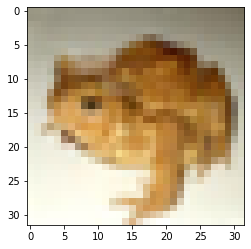

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


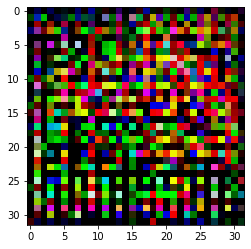

In [8]:
class UnetGenerator(nn.Module):
    """Create a Unet-based generator"""

    def __init__(self, input_nc, output_nc, num_downs, ngf=64, norm_layer=nn.BatchNorm2d, use_dropout=False):
        """Construct a Unet generator
        Parameters:
            input_nc (int)  -- the number of channels in input images
            output_nc (int) -- the number of channels in output images
            num_downs (int) -- the number of downsamplings in UNet. For example, # if |num_downs| == 7,
                                image of size 128x128 will become of size 1x1 # at the bottleneck
            ngf (int)       -- the number of filters in the last conv layer
            norm_layer      -- normalization layer
        We construct the U-Net from the innermost layer to the outermost layer.
        It is a recursive process.
        """
        super(UnetGenerator, self).__init__()
        # construct unet structure
        unet_block = UnetSkipConnectionBlock(ngf * 8, ngf * 8, input_nc=None, submodule=None, norm_layer=norm_layer, innermost=True)  # add the innermost layer
        for i in range(num_downs - 5):          # add intermediate layers with ngf * 8 filters
            unet_block = UnetSkipConnectionBlock(ngf * 8, ngf * 8, input_nc=None, submodule=unet_block, norm_layer=norm_layer, use_dropout=use_dropout)
        # gradually reduce the number of filters from ngf * 8 to ngf
        unet_block = UnetSkipConnectionBlock(ngf * 4, ngf * 8, input_nc=None, submodule=unet_block, norm_layer=norm_layer)
        unet_block = UnetSkipConnectionBlock(ngf * 2, ngf * 4, input_nc=None, submodule=unet_block, norm_layer=norm_layer)
        unet_block = UnetSkipConnectionBlock(ngf, ngf * 2, input_nc=None, submodule=unet_block, norm_layer=norm_layer)
        self.model = UnetSkipConnectionBlock(output_nc, ngf, input_nc=input_nc, submodule=unet_block, outermost=True, norm_layer=norm_layer)  # add the outermost layer

    def forward(self, input):
        """Standard forward"""
        return self.model(input)


class UnetSkipConnectionBlock(nn.Module):
    """Defines the Unet submodule with skip connection.
        X -------------------identity----------------------
        |-- downsampling -- |submodule| -- upsampling --|
    """

    def __init__(self, outer_nc, inner_nc, input_nc=None,
                 submodule=None, outermost=False, innermost=False, norm_layer=nn.BatchNorm2d, use_dropout=False):
        """Construct a Unet submodule with skip connections.
        Parameters:
            outer_nc (int) -- the number of filters in the outer conv layer
            inner_nc (int) -- the number of filters in the inner conv layer
            input_nc (int) -- the number of channels in input images/features
            submodule (UnetSkipConnectionBlock) -- previously defined submodules
            outermost (bool)    -- if this module is the outermost module
            innermost (bool)    -- if this module is the innermost module
            norm_layer          -- normalization layer
            use_dropout (bool)  -- if use dropout layers.
        """
        super(UnetSkipConnectionBlock, self).__init__()
        self.outermost = outermost
        if type(norm_layer) == functools.partial:
            use_bias = norm_layer.func == nn.InstanceNorm2d
        else:
            use_bias = norm_layer == nn.InstanceNorm2d
        if input_nc is None:
            input_nc = outer_nc
        downconv = nn.Conv2d(input_nc, inner_nc, kernel_size=4,
                             stride=2, padding=1, bias=use_bias)
        downrelu = nn.LeakyReLU(0.2, True)
        downnorm = norm_layer(inner_nc)
        uprelu = nn.ReLU(True)
        upnorm = norm_layer(outer_nc)

        if outermost:
            upconv = nn.ConvTranspose2d(inner_nc * 2, outer_nc,
                                        kernel_size=4, stride=2,
                                        padding=1)
            down = [downconv]
            up = [uprelu, upconv, nn.Tanh()]
            model = down + [submodule] + up
        elif innermost:
            upconv = nn.ConvTranspose2d(inner_nc, outer_nc,
                                        kernel_size=4, stride=2,
                                        padding=1, bias=use_bias)
            down = [downrelu, downconv]
            up = [uprelu, upconv, upnorm]
            model = down + up
        else:
            upconv = nn.ConvTranspose2d(inner_nc * 2, outer_nc,
                                        kernel_size=4, stride=2,
                                        padding=1, bias=use_bias)
            down = [downrelu, downconv, downnorm]
            up = [uprelu, upconv, upnorm]

            if use_dropout:
                model = down + [submodule] + up + [nn.Dropout(0.5)]
            else:
                model = down + [submodule] + up

        self.model = nn.Sequential(*model)
        self.mean = torch.tensor((0.4914, 0.4822, 0.4465)).to(device)
        self.mean = self.mean.view(-1,1,1)
        self.var = torch.tensor((0.2023, 0.1994, 0.2010)).to(device)
        self.var = self.var.view(-1,1,1)

    def forward(self, x):
        if self.outermost:
            x = self.model(x)
#             x = x * 20/255*2.78
            x = (x - self.mean)/self.var
            return x
        else:   # add skip connections
            return torch.cat([x, self.model(x)], 1)

            
            
            
use_dropout = True
norm_layer = functools.partial(nn.BatchNorm2d, affine=True, track_running_stats=True)
# norm_layer = functools.partial(nn.InstanceNorm2d)
input_nc = 3
output_nc = 3
ngf = 64
ndf = 64

Generator = UnetGenerator(input_nc, output_nc, 5, ngf, norm_layer=norm_layer, use_dropout=use_dropout).to(device)

im = Generator(imgs.to(device))

imshow(imgs[0,:,:,:].squeeze().cpu().detach().numpy()) 
imshow(im[0,:,:,:].squeeze().cpu().detach().numpy()) 

In [9]:
def eval_target_net(net, testloader, w, classes=None):

    if classes is not None:
        class_correct = np.zeros(10)
        class_total = np.zeros(10)
    total = 0
    correct = 0
    with torch.no_grad():
        net.eval()
        for i, (imgs, lbls) in enumerate(testloader):

            imgs, lbls = imgs.to(device), lbls.to(device)

#             output = net(imgs)
            output = net.forward_with_param(imgs, w)

            predicted = output.argmax(dim=1)

            total += imgs.size(0)
            correct += predicted.eq(lbls).sum().item()

            if classes is not None:
                for prediction, lbl in zip(predicted, lbls):

                    class_correct[lbl] += prediction == lbl
                    class_total[lbl] += 1
             
    if classes is not None:
        for i in range(len(classes)):
            print('Accuracy of %s : %.2f %%' % (classes[i], 100 * class_correct[i] / class_total[i]))
    print("\nTotal accuracy = %.2f %%\n\n" % (100*(correct/total)) )
    
    return((100*(correct/total)))

def eval_target_net2(net, testloader, w, classes=None):

    if classes is not None:
        class_correct = np.zeros(10)
        class_total = np.zeros(10)
    total = 0
    correct = 0
    with torch.no_grad():
        net.eval()
        for i, (imgs, lbls, _) in enumerate(testloader):

            imgs, lbls = imgs.to(device), lbls.to(device)

#             output = net(imgs)
            output = net.forward_with_param(imgs, w)

            predicted = output.argmax(dim=1)

            total += imgs.size(0)
            correct += predicted.eq(lbls).sum().item()

            if classes is not None:
                for prediction, lbl in zip(predicted, lbls):

                    class_correct[lbl] += prediction == lbl
                    class_total[lbl] += 1
             
    if classes is not None:
        for i in range(len(classes)):
            print('Accuracy of %s : %.2f %%' % (classes[i], 100 * class_correct[i] / class_total[i]))
    print("\nTotal accuracy = %.2f %%\n\n" % (100*(correct/total)) )
    
    return((100*(correct/total)))

## split datasets

In [10]:
criterionL1 = torch.nn.L1Loss()

In [11]:
class MyDataset():
    def __init__(self, dataset):
        self.dataset = dataset
        
    def __getitem__(self, index):
        data, target = self.dataset[index]        
        return data, target, index

    def __len__(self):
        return len(self.dataset)
    
    
def split_dataset():
    
    data_acc = []
    cifar10_trainset = torchvision.datasets.CIFAR10('/home/fmejia/fmejia/Cypercat/cyphercat/datasets//', train=True, transform=transform, download=True)
    trainset = MyDataset(cifar10_trainset)

    # create lists of index of each class
    label_list =[]
    for i in range(len(classes)):
        label_list.append([])

    for i, batch in enumerate(trainset):
        imgs, labels,index = batch
        label_list[labels].append(i)

    # half of the data
    n_misslabeled = int(2500)
    
    train_idx = []
    test_idx = []
    for i in range(len(classes)):        
        random.shuffle(label_list[i])
        train_idx += (label_list[i][:n_misslabeled])
        test_idx += (label_list[i][n_misslabeled:])
        
    train_sampler = SubsetRandomSampler(train_idx)
    test_sampler = SubsetRandomSampler(test_idx)
    
    cifar10_trainloader = torch.utils.data.DataLoader(trainset, batch_size = batch_size, 
                                                      sampler = train_sampler, num_workers=2)
    cifar10_testloader = torch.utils.data.DataLoader(trainset, batch_size = batch_size, 
                                                      sampler = test_sampler, num_workers=2)
    return cifar10_trainloader, cifar10_testloader

In [12]:
with open('w_list.pickle', 'rb') as f:
    w_list = pickle.load(f)
with open('w_list2.pickle', 'rb') as f:
    w_list2 = pickle.load(f)
for w in w_list2[0]:
    w_list[0].append(w)
    
with open('w_list3.pickle', 'rb') as f:
    w_list3 = pickle.load(f)
for w in w_list3[0]:
    w_list[0].append(w)
    

In [13]:
# l0_full = []
# for w in w_list[0]:
#     for w1 in w_list[0]:
#         l0 = - (w1*w).sum() / (torch.sqrt((w1*w1).sum()) * torch.sqrt((w*w).sum())) 
#         if l0 > -0.9:
#             l0_full.append(l0.item())
# plt.hist(l0_full)
# plt.show()

[0/10]


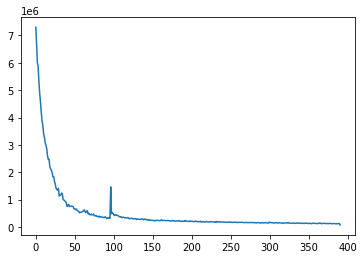

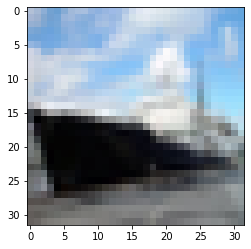

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


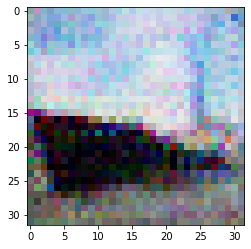

[1/10]


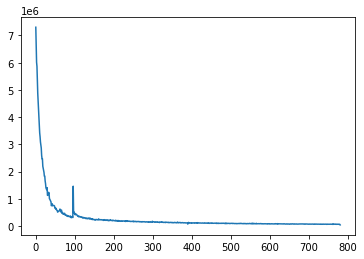

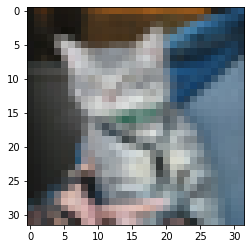

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


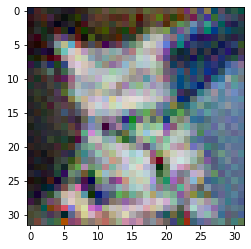

[2/10]


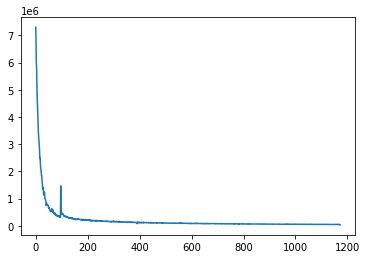

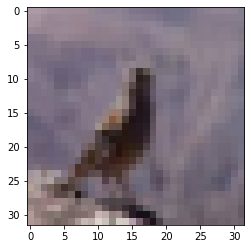

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


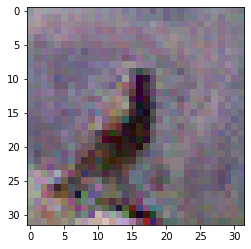

[3/10]


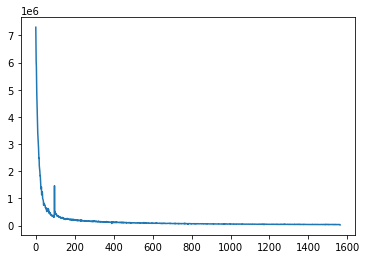

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


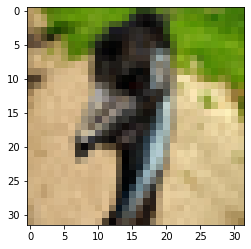

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


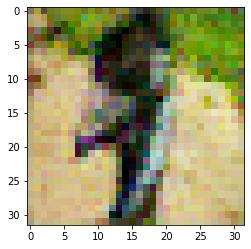

In [ ]:
losses = []
n_epochs = 10
lr = 0.01
beta1 = 0.5
lr_adam = 1e-04
Generator = UnetGenerator(input_nc, output_nc, 5, ngf, norm_layer=norm_layer, use_dropout=use_dropout).to(device)

optimizer_g = optim.Adam(Generator.parameters(), lr = lr_adam, betas = (beta1, 0.999))
for epoch in range(n_epochs):

    for batch in (cifar10_trainloader):

        imgs, labels = batch
        imgs, labels = imgs.to(device), labels.to(device)

        ### autoencoder classifier
#             im_ae = Generator(imgs) + imgs             
        im_noise = Generator(imgs)
        loss_ae = ((im_noise - imgs)**2).sum()        
        loss_ae.backward()
        optimizer_g.step()
        Generator.zero_grad()
        losses.append(loss_ae.item())

        # evaluate performance on testset at the end of each epoch
    print("[%d/%d]" %(epoch, n_epochs))

    plt.plot(losses)
    plt.show()
    out_img = Generator(imgs)
    imshow(imgs[0,:,:,:].squeeze().cpu().detach().numpy())   
    imshow(out_img[0,:,:,:].squeeze().cpu().detach().numpy()) 


In [ ]:
# losses = []
# gradient_losses = []
# losses2 = []
# n_epochs = 1
# n_restarts = 1
# class_criterion = nn.CrossEntropyLoss()
# lr = 0.01
# beta1 = 0.5
# lr_adam = 1e-04
# # Generator = UnetGenerator(input_nc, output_nc, 5, ngf, norm_layer=norm_layer, use_dropout=use_dropout).to(device)

# optimizer_g = optim.Adam(Generator.parameters(), lr = lr_adam, betas = (beta1, 0.999))
# # optimizer_g = optim.SGD(Generator.parameters(), lr = lr_adam, momentum=0.9)#, weight_decay=0.0002)

# #     w = torch.tensor(net.get_param().cpu().detach().numpy(), requires_grad = True).to(device) 
# w = w_list[0][0]
# w_mom = torch.zeros(w.size(), requires_grad = False).to(device) 


# imgs,labels = iter(cifar10_trainloader).next()

# imgs, labels = imgs.to(device), labels.to(device)

# for batch_test in cifar10_testloader:
#     imgs_test, labels_test = batch_test
#     imgs_test, labels_test = imgs_test.to(device), labels_test.to(device)
#     ### autoencoder classifier
# #             im_ae = Generator(imgs) + imgs             
#     im_noise = Generator(imgs)      
#     im_ae = im_noise  #+ imgs        
#     loss_ae = criterionL1(im_noise,imgs)
#     with torch.enable_grad():
#         outputs = net.forward_with_param(im_ae, w)
#         loss = class_criterion(outputs, labels)                
#     gw, = torch.autograd.grad(loss, w, grad_outputs = torch.tensor(lr).to(device),create_graph=True) 

#     ## test loss
#     outputs = net.forward_with_param(imgs_test, w)
#     loss_test = class_criterion(outputs, labels_test) 
#     dw, = torch.autograd.grad(loss_test, (w,))
#     gw1 = (0.9 * w_mom + gw)

#     l0 = - (gw1*dw).sum() / (torch.sqrt((gw1*gw1).sum()) * torch.sqrt((dw*dw).sum())) 

#     l_full = l0 #+ loss_ae
#     l_full.backward()

#     optimizer_g.step()
#     Generator.zero_grad()
#     net.zero_grad()
#     gradient_losses.append(l0.data)               
#     plt.plot(gradient_losses)
#     plt.grid(True)
#     plt.show()
#     out_img = Generator(imgs)
#     imshow(imgs[0,:,:,:].squeeze().cpu().detach().numpy())   
#     imshow(out_img[0,:,:,:].squeeze().cpu().detach().numpy()) 


In [ ]:
# losses = []
# gradient_losses = []
# losses2 = []
# n_epochs = 10
# n_restarts = 1
# class_criterion = nn.CrossEntropyLoss()
# lr = 0.01
# lr_synthetic = 1e3

# for restart in range(n_restarts):
# #     net = VGG()
# #     net.reset() 
# #     net.train()            
# #     w = torch.tensor(net.get_param().cpu().detach().numpy(), requires_grad = True).to(device) 
#     w = w_list[0][0]
#     w_mom = torch.zeros(w.size(), requires_grad = False).to(device) 
#     imgs,labels = iter(cifar10_trainloader).next()
#     im_noise = torch.zeros(imgs.size(), requires_grad = True).to(device)
#     im_noise_mom = torch.zeros(imgs.size()).to(device)
#     count = 0
# #     im_noise = torch.zeros(imgs.size(), requires_grad = True)
# #     im_noise_mom = torch.zeros(imgs.size())
# #     cifar10_trainloader, cifar10_valloader = split_dataset()
#     for epoch in range(n_epochs):
        
#         total = 0
#         correct = 0

# #         for batch in (cifar10_trainloader):

# #             imgs, labels = batch
#         imgs, labels = imgs.to(device), labels.to(device)
#         cc = 0 
#         for batch_test in cifar10_testloader:
#             imgs_test, labels_test = batch_test
#             imgs_test, labels_test = imgs_test.to(device), labels_test.to(device)

#             ### autoencoder classifier
# #             im_ae = Generator(imgs) + imgs             
# #             im_noise = Generator(imgs)      
#             im_ae = torch.clamp(nn.Tanh()(im_noise)  + imgs, -2.4291, 2.7537)
# #             loss_ae = criterionL1(im_noise,imgs)
#             with torch.enable_grad():
#                 outputs = net.forward_with_param(im_ae, w)
#                 loss = class_criterion(outputs, labels)                
#             gw, = torch.autograd.grad(loss, w, grad_outputs = torch.tensor(lr).to(device),create_graph=True) 

#             ## test loss
#             outputs = net.forward_with_param(imgs_test, w)
#             loss_test = class_criterion(outputs, labels_test) 
#             dw, = torch.autograd.grad(loss_test, (w,))
#             dgw = dw.neg()
            
# #             hvp_grad = torch.autograd.grad(
# #                 outputs=(gw,),
# #                 inputs=[im_noise],
# #                 grad_outputs=(dgw,)
# #             )
#             l0 = - (gw*dw).sum() / (torch.sqrt((gw*gw).sum()) * torch.sqrt((dw*dw).sum())) 
#             hvp_grad = torch.autograd.grad(
#                 outputs=(l0,),
#                 inputs=[im_noise],
#             )

#             im_noise_mom.data = 0.9 * im_noise_mom.data + lr_synthetic * hvp_grad[0]
#             im_noise.data = im_noise.data - im_noise_mom.data

            

#             net.zero_grad()
#             gradient_losses.append(l0.data)

#             count+=1
            
#             if count%100==0:                
#                 plt.plot(gradient_losses)
#                 plt.grid(True)
#                 plt.show()
#                 im_ae = im_noise  + imgs   
#                 imshow(imgs[0,:,:,:].squeeze().cpu().detach().numpy())   
#                 imshow(im_ae[0,:,:,:].squeeze().cpu().detach().numpy())   
#                 imshow(im_noise[0,:,:,:].squeeze().cpu().detach().numpy()) 
#                 plt.hist(hvp_grad[0].view(-1).squeeze().cpu().detach().numpy())
#                 plt.show()
#                 plt.hist(im_noise.view(-1).squeeze().cpu().detach().numpy())
#                 plt.show()

In [ ]:
len(w_list[0])

In [ ]:
losses = []
gradient_losses = []
losses2 = []
n_epochs = 100
n_restarts = 1
class_criterion = nn.CrossEntropyLoss()
lr = 0.01
beta1 = 0.5
lr_adam = 1e-04
optimizer_g = optim.Adam(Generator.parameters(), lr = lr_adam, betas = (beta1, 0.999))

for restart in range(n_restarts):
#     net = VGG()
#     net.reset() 
#     net.train()            
#     w = torch.tensor(net.get_param().cpu().detach().numpy(), requires_grad = True).to(device) 
    w = w_list[0][0]
    w_mom = torch.zeros(w.size(), requires_grad = False).to(device) 
    imgs,labels = iter(cifar10_trainloader).next()
#     cifar10_trainloader, cifar10_valloader = split_dataset()
    count = 0
    for epoch in range(n_epochs):
        
        total = 0
        correct = 0
        
#         for batch in (cifar10_trainloader):

#             imgs, labels = batch
        imgs, labels = imgs.to(device), labels.to(device)
        cc = 0 
        for batch_test in cifar10_testloader:
            
            w = w_list[0][count%len(w_list[0])]
            imgs_test, labels_test = batch_test
            imgs_test, labels_test = imgs_test.to(device), labels_test.to(device)

            ### autoencoder classifier
#             im_ae = Generator(imgs) + imgs             
            im_noise = Generator(imgs)      
            im_ae = im_noise  #+ imgs        
            loss_ae = criterionL1(im_noise,imgs)
            with torch.enable_grad():
                outputs = net.forward_with_param(im_ae, w)
                loss = class_criterion(outputs, labels)                
            gw, = torch.autograd.grad(loss, w, grad_outputs = torch.tensor(lr).to(device),create_graph=True) 

            ## test loss
            outputs = net.forward_with_param(imgs_test, w)
            loss_test = class_criterion(outputs, labels_test) 
            dw, = torch.autograd.grad(loss_test, (w,))
            gw1 = gw#(0.9 * w_mom + gw)
            Generator.zero_grad()
            l0 = - (gw1*dw).sum() / (torch.sqrt((gw1*gw1).sum()) * torch.sqrt((dw*dw).sum())) 

            l_full = l0 #+ loss_ae/5
            l_full.backward()

            optimizer_g.step()
            Generator.zero_grad()
            net.zero_grad()
            gradient_losses.append(l0.data)
#                 if cc == 0:
#                     dw0 = dw.detach()
#                     cc += 1
#             with torch.no_grad():
#                 w_mom = 0.9 * w_mom + dw0 * lr
#                 w = w.sub(w_mom).requires_grad_()
# #                 w.grad.zero_()

            # evaluate performance on testset at the end of each epoch
            print("[%d/%d] [%d/%d]" %(epoch, n_epochs, count, 390))
            count+=1

            if count%100==0:                
                plt.plot(gradient_losses)
                plt.grid(True)
                plt.show()
                out_img = Generator(imgs)
                imshow(imgs[0,:,:,:].squeeze().cpu().detach().numpy())   
                imshow(out_img[0,:,:,:].squeeze().cpu().detach().numpy()) 
#             break
#         eval_target_net(net, cifar10_testloader, w, classes = classes)       

#                 w = w.sub(gw).requires_grad_()
#         
#         eval_target_net2(net, cifar10_valloader, w, classes = classes)
#             break
#     if epoch%10 == 0:
#         torch.save(net, 'CIFAR10_VGG_trained_robust%i.pt' %epoch)


In [16]:
# im_noise_full = torch.zeros(50000,3,32,32).to(device)
# im_noise_mom_full = torch.zeros(50000,3,32,32).to(device)

 

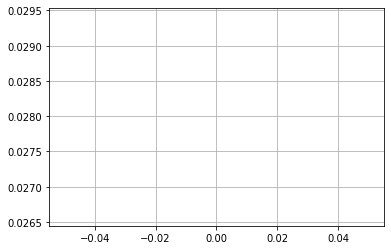

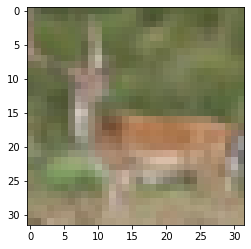

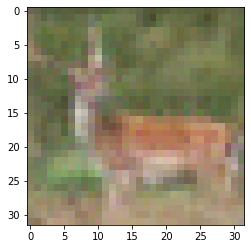

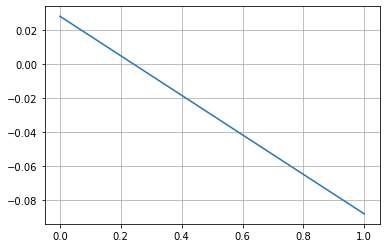

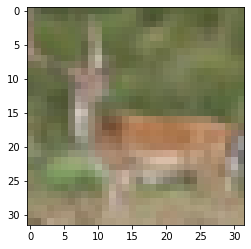

...

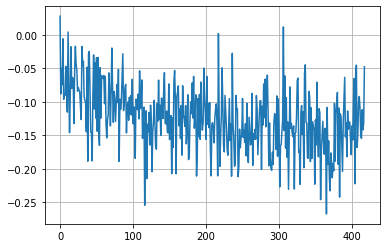

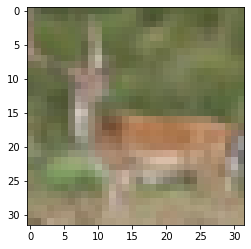

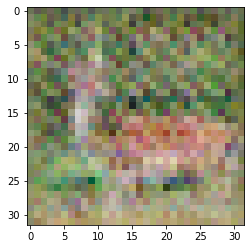

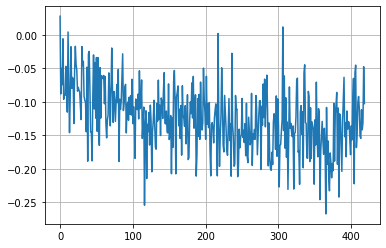

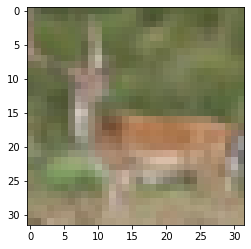

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


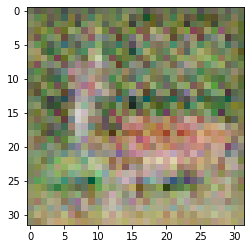

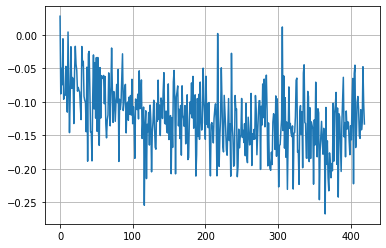

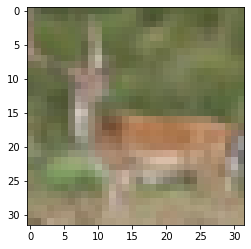

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


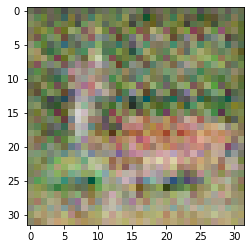

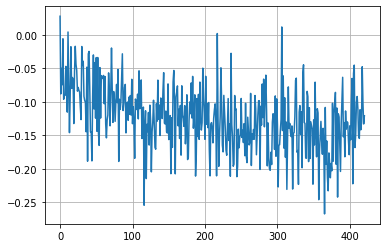

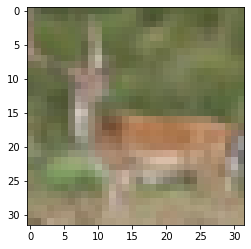

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


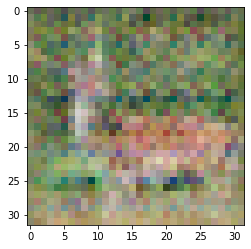

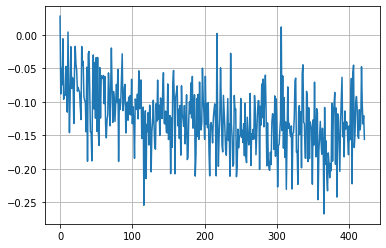

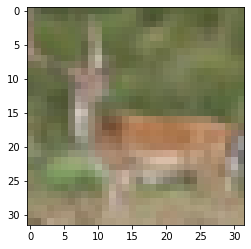

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


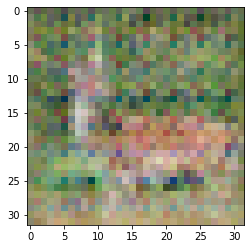

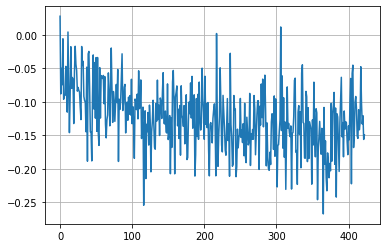

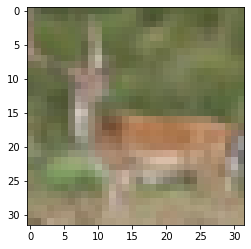

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


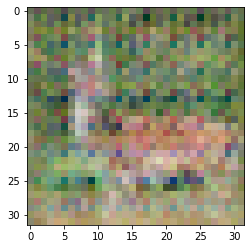

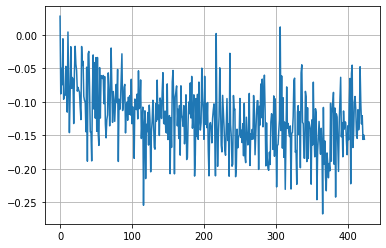

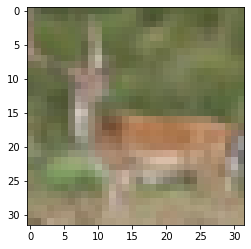

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


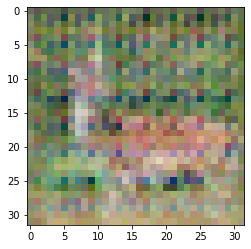

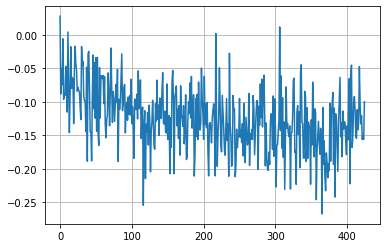

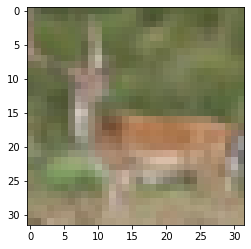

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


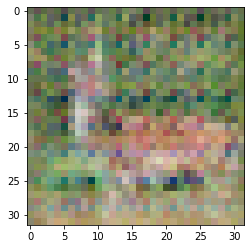

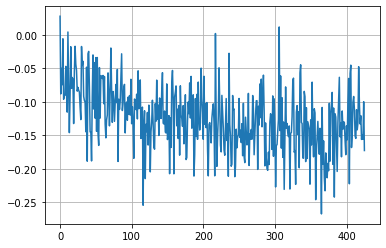

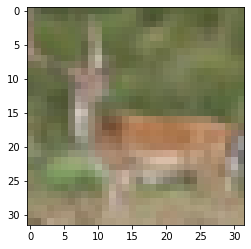

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


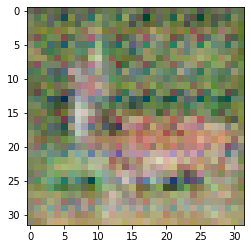

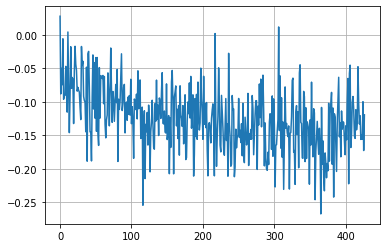

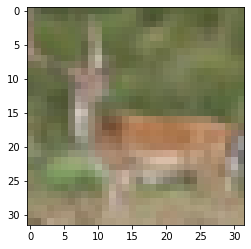

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


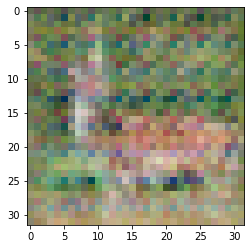

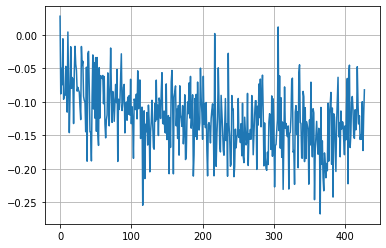

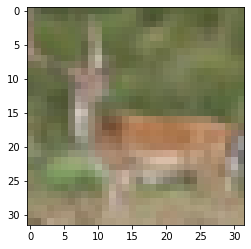

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


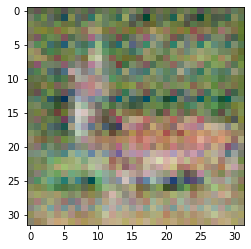

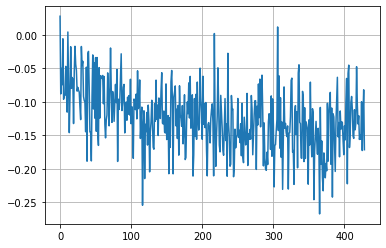

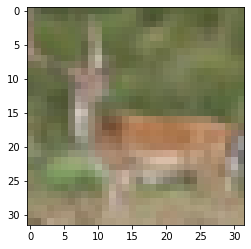

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


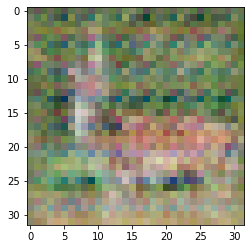

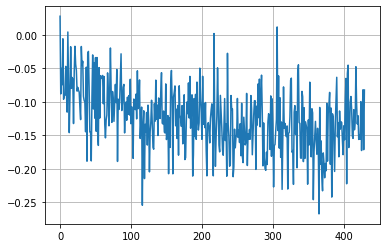

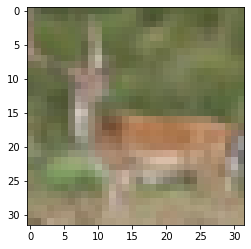

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


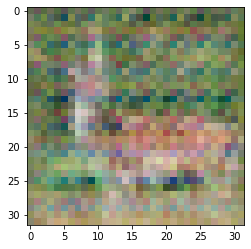

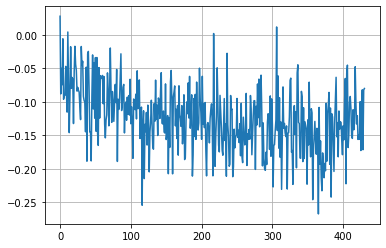

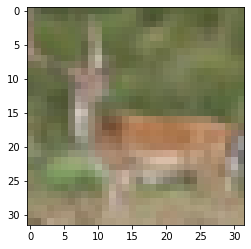

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


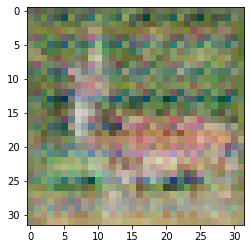

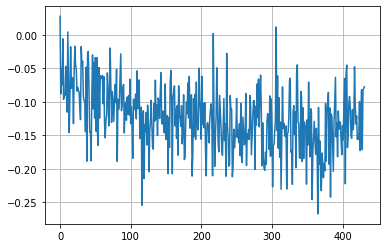

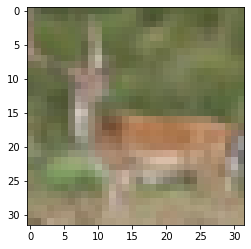

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


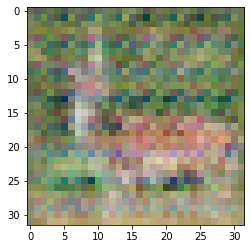

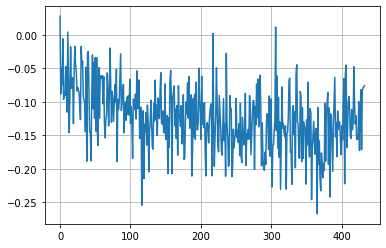

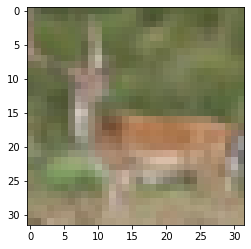

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


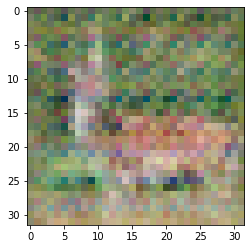

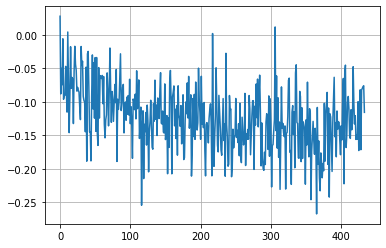

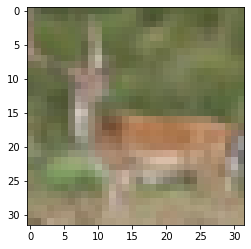

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


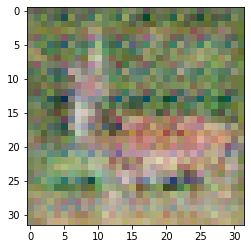

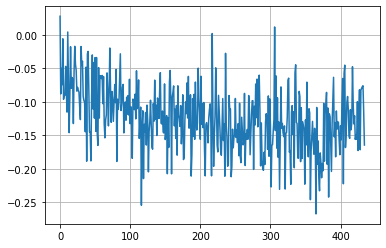

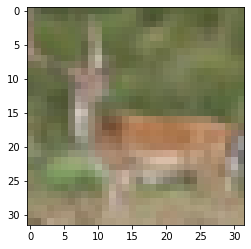

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


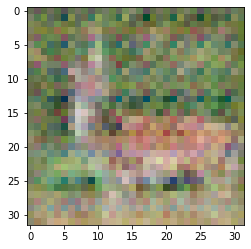

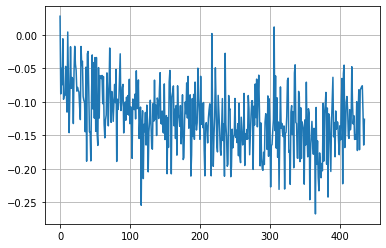

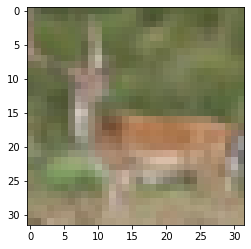

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


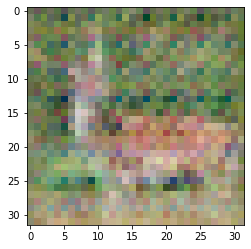

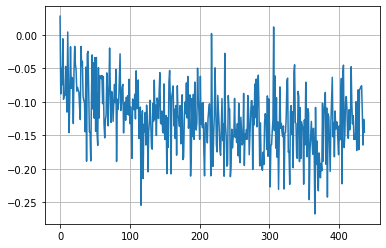

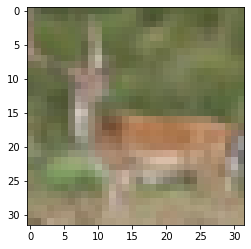

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


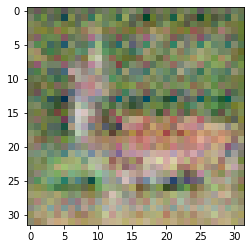

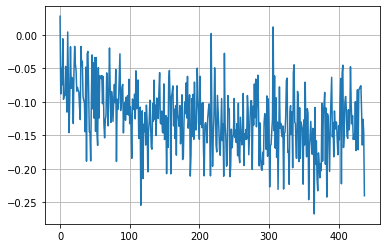

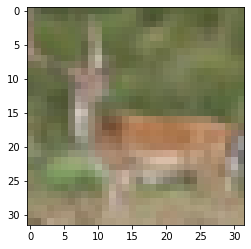

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


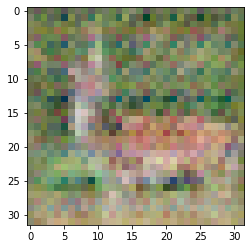

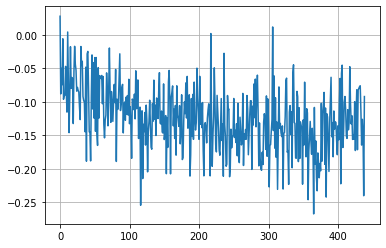

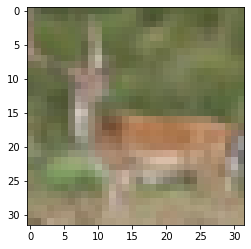

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


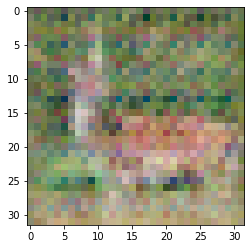

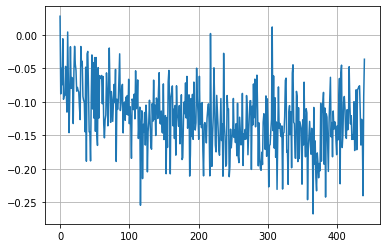

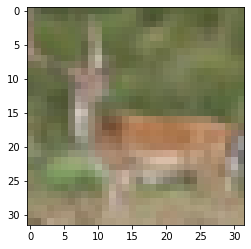

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


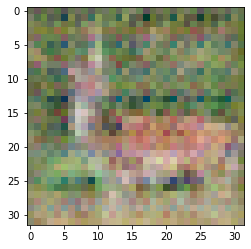

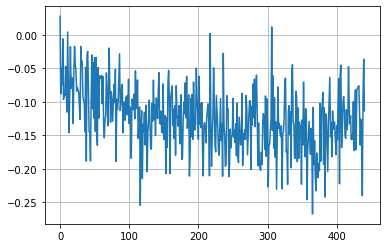

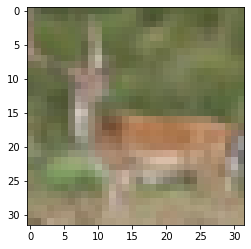

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


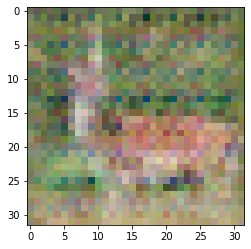

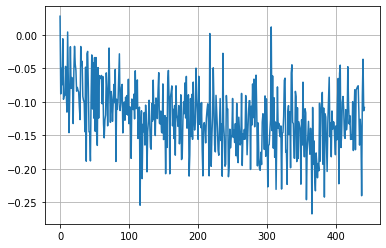

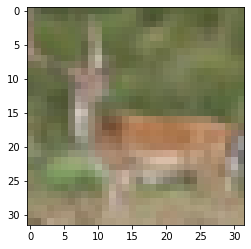

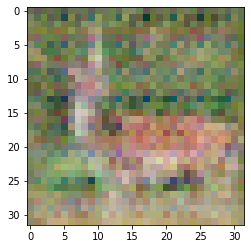

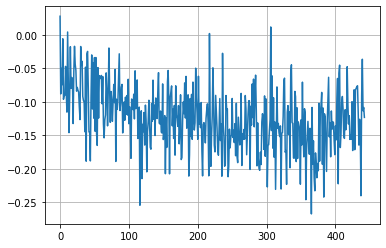

...

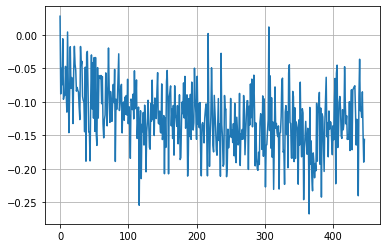

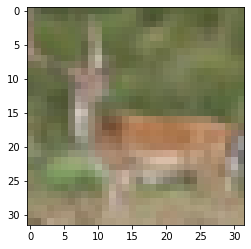

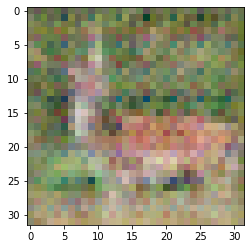

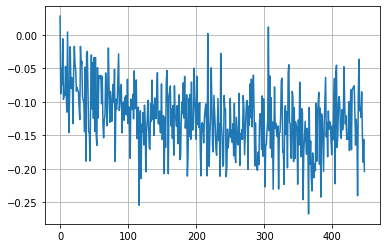

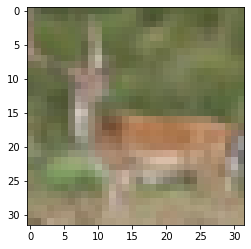

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


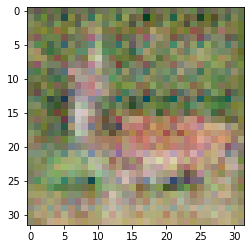

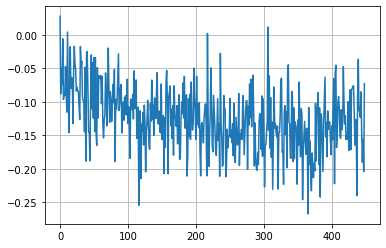

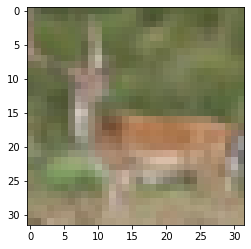

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


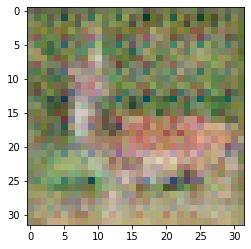

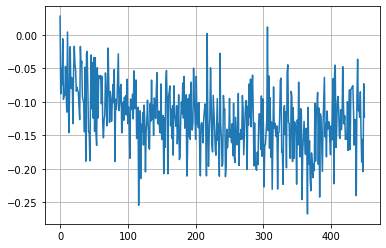

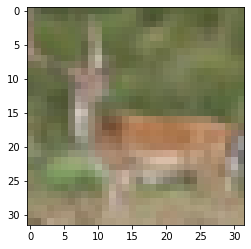

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


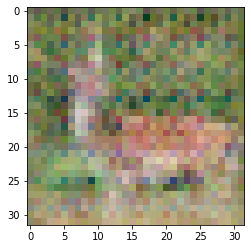

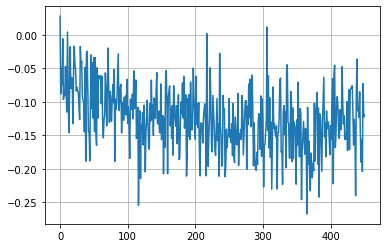

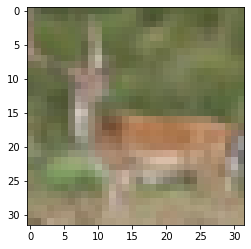

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


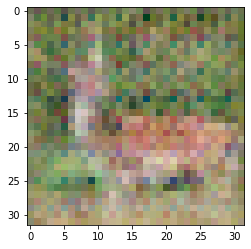

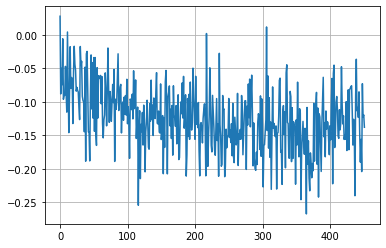

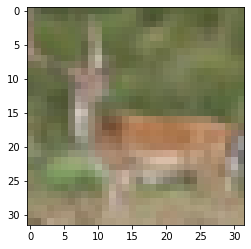

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


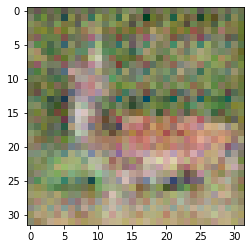

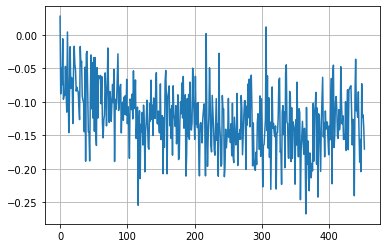

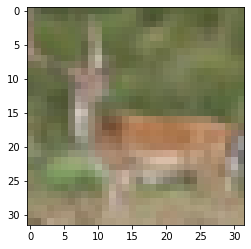

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


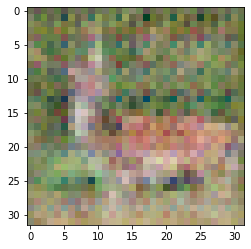

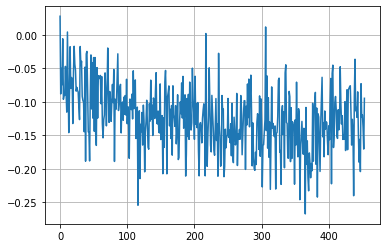

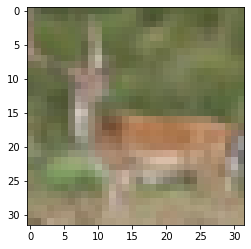

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


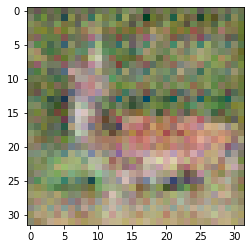

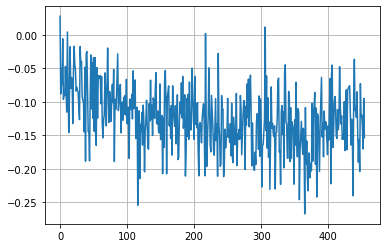

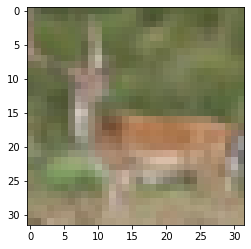

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


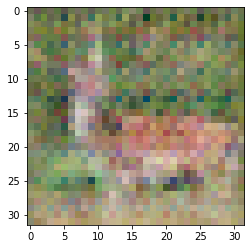

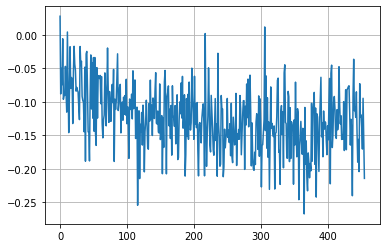

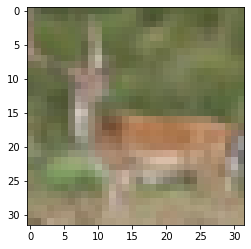

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


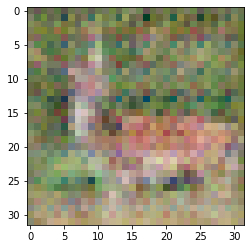

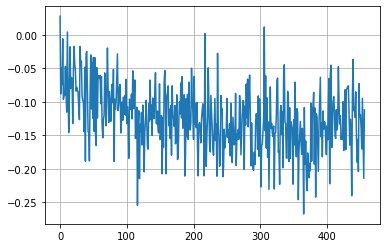

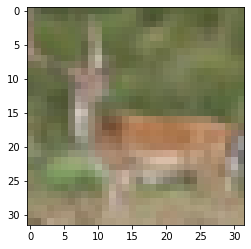

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


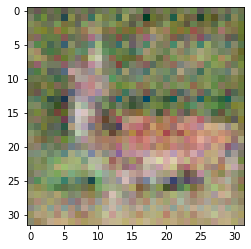

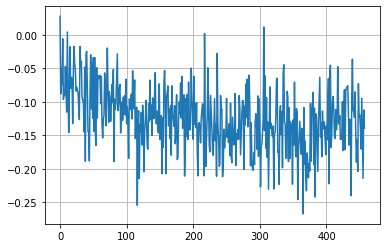

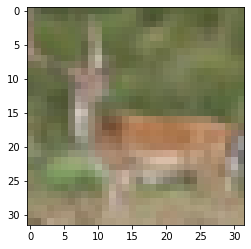

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


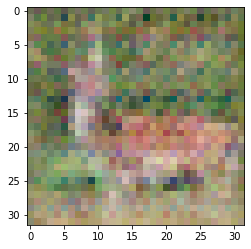

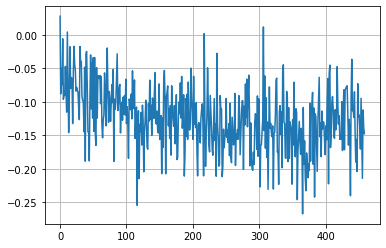

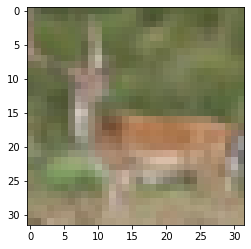

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


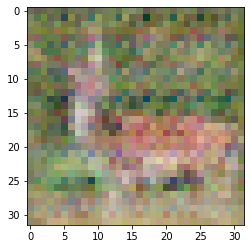

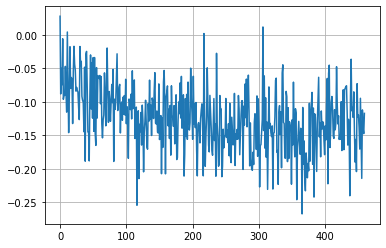

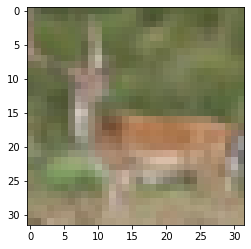

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


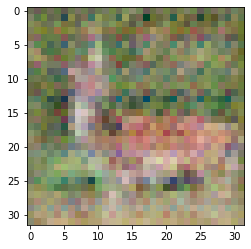

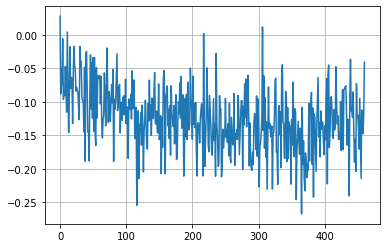

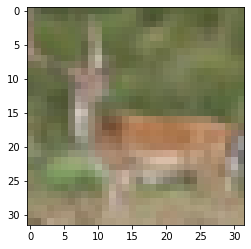

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


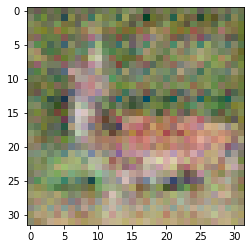

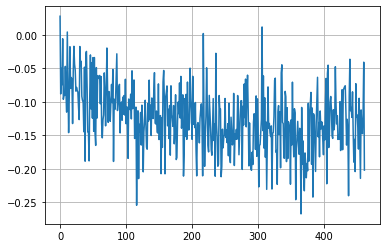

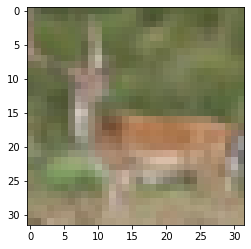

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


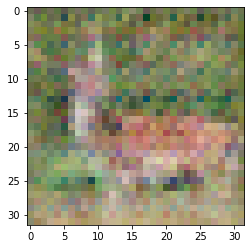

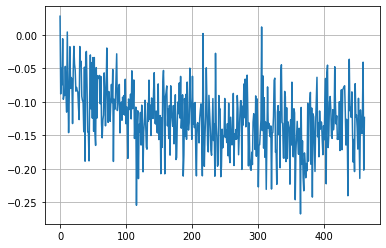

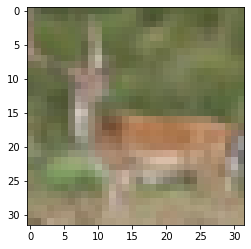

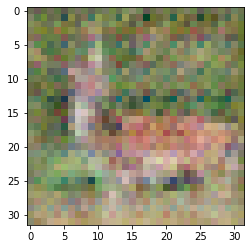

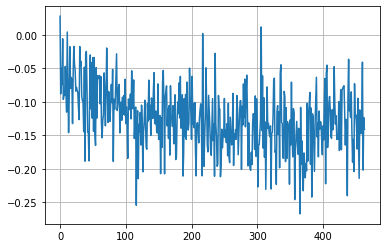

...

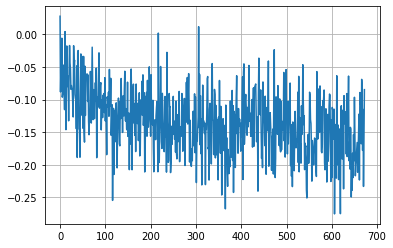

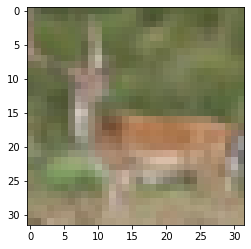

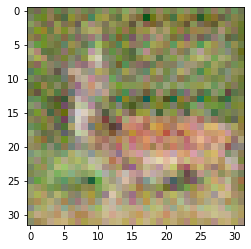

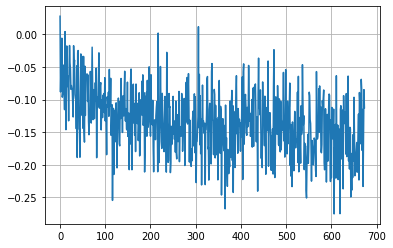

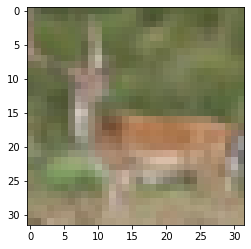

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


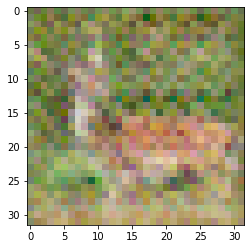

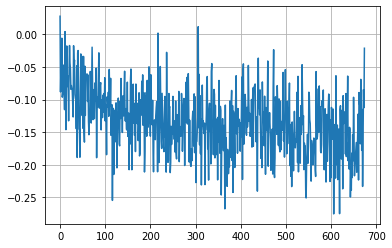

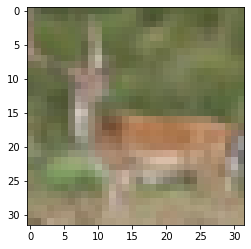

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


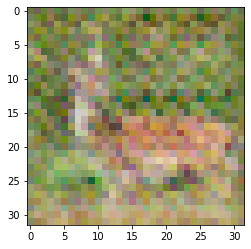

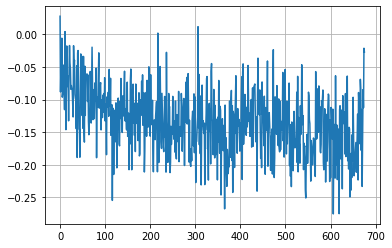

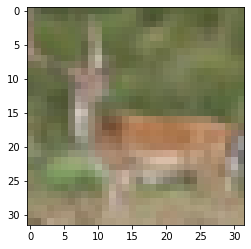

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


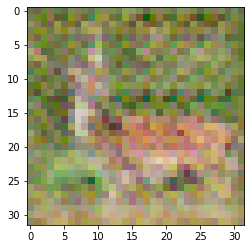

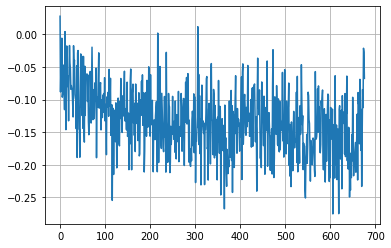

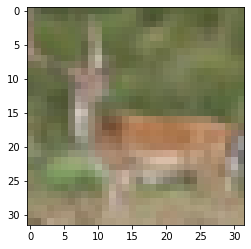

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


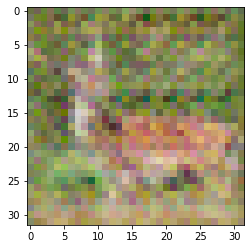

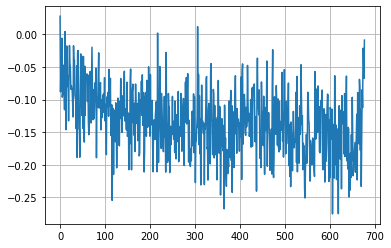

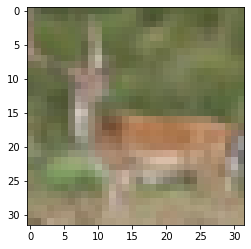

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


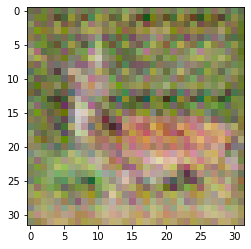

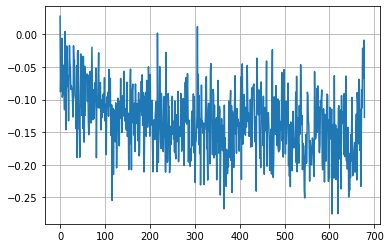

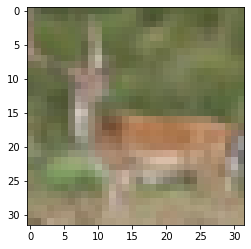

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


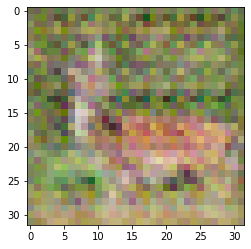

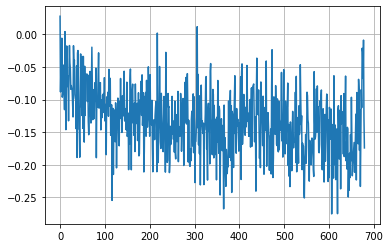

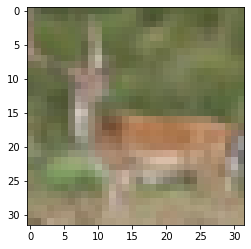

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


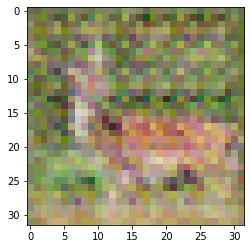

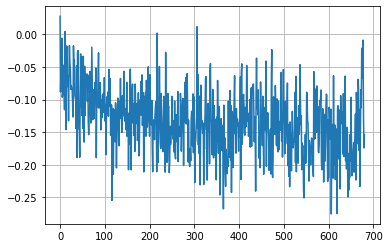

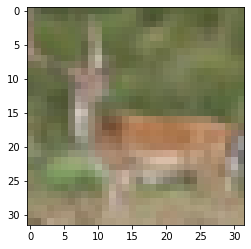

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


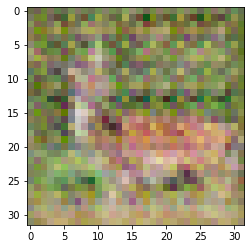

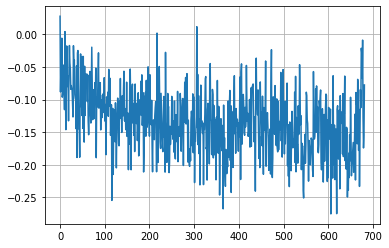

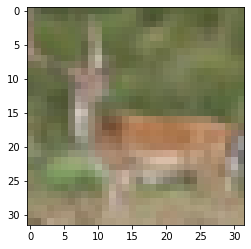

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


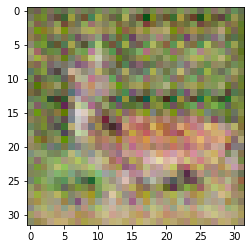

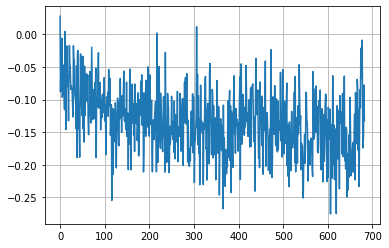

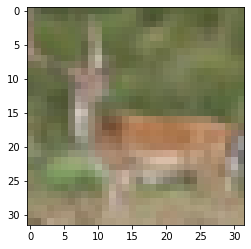

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


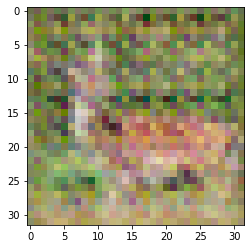

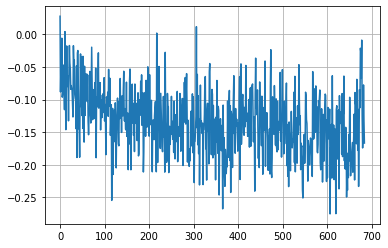

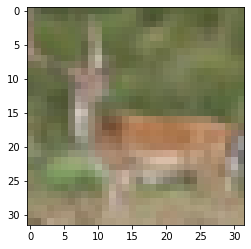

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


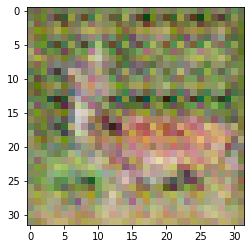

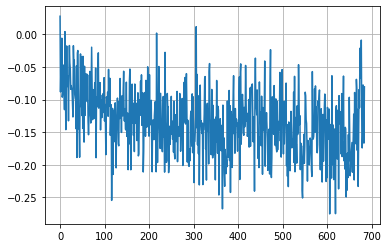

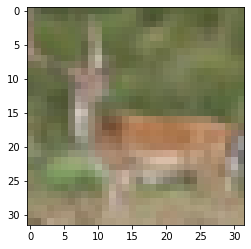

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


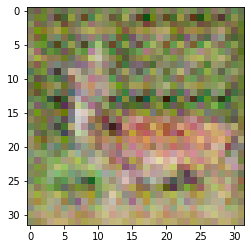

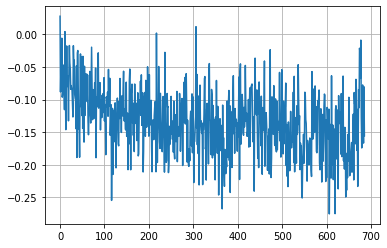

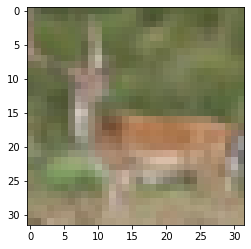

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


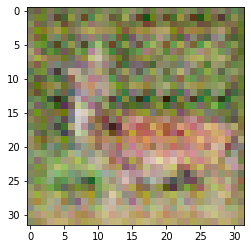

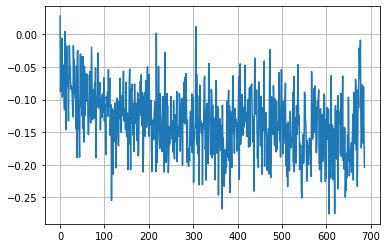

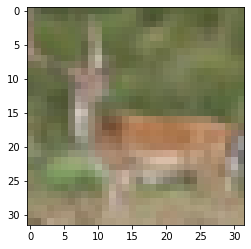

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


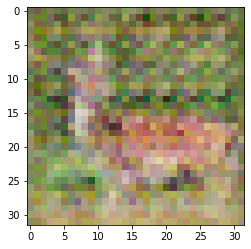

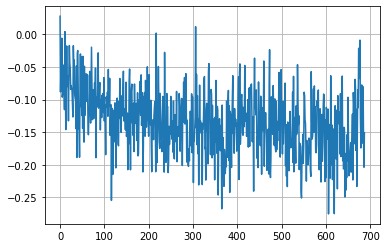

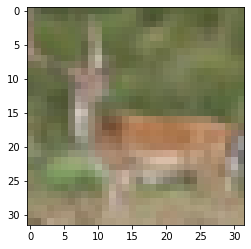

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


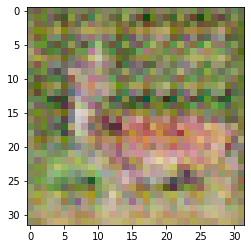

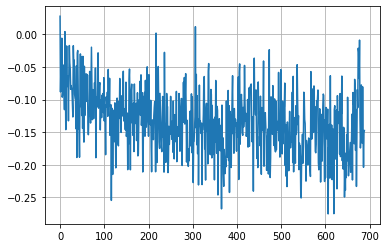

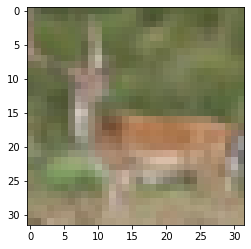

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


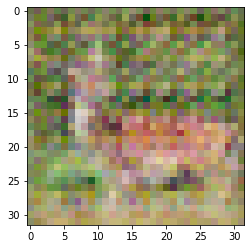

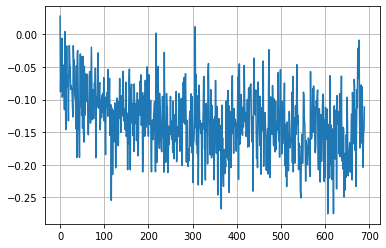

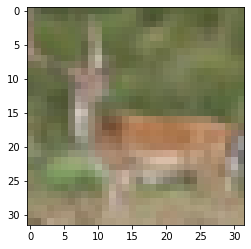

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


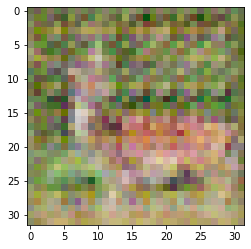

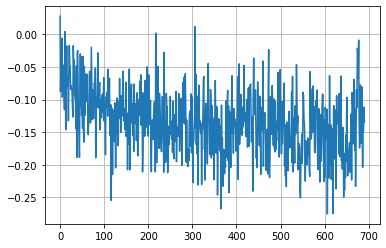

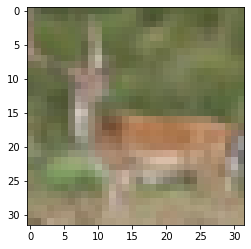

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


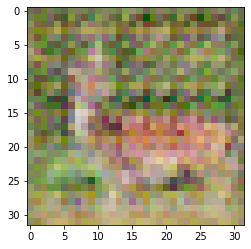

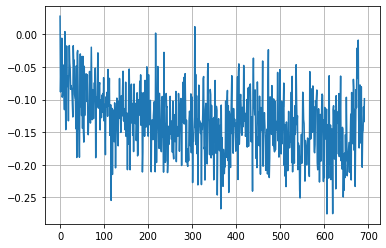

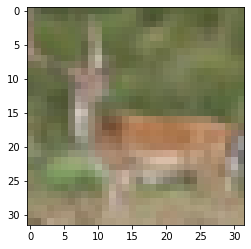

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


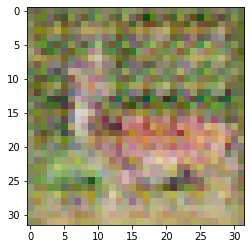

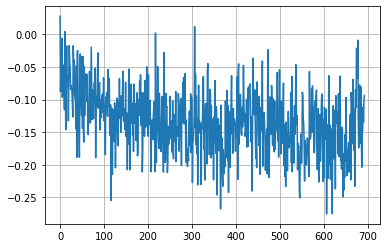

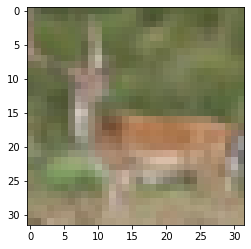

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


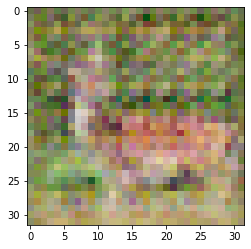

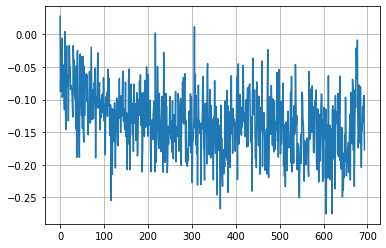

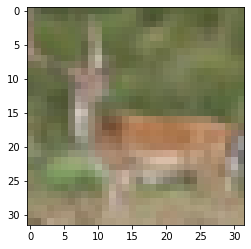

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


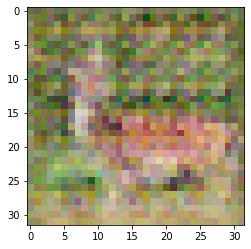

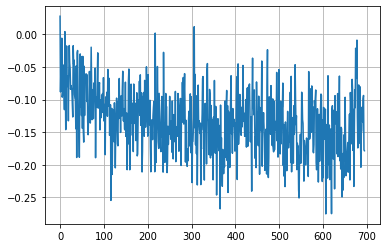

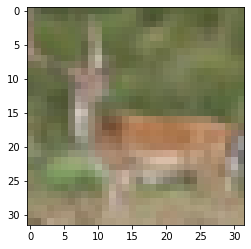

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


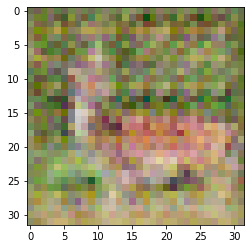

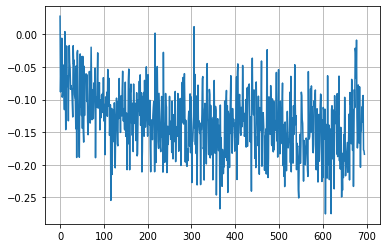

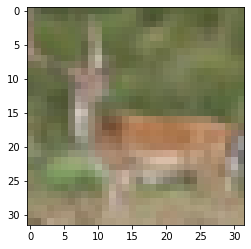

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


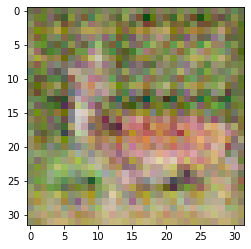

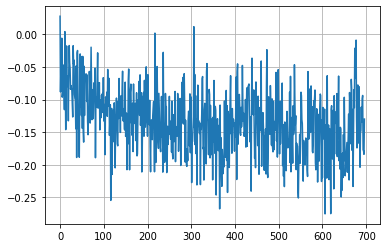

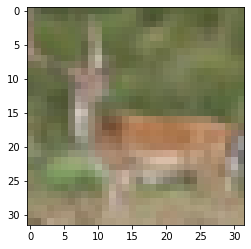

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


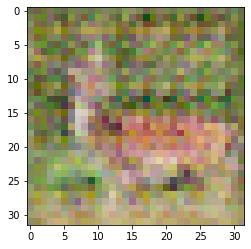

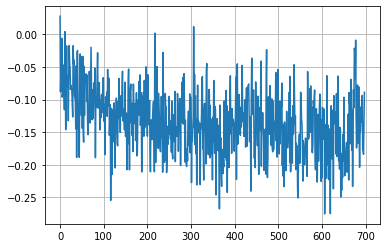

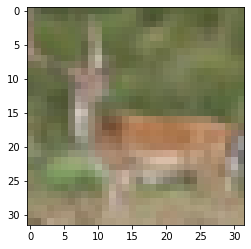

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


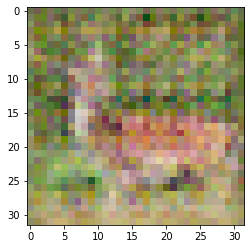

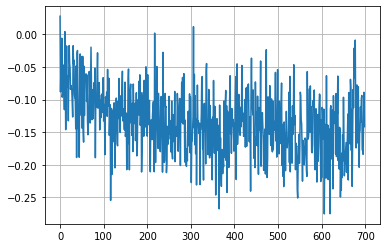

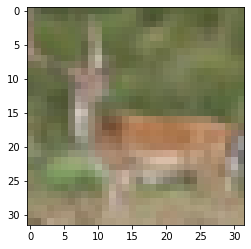

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


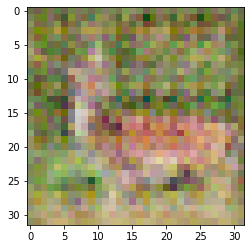

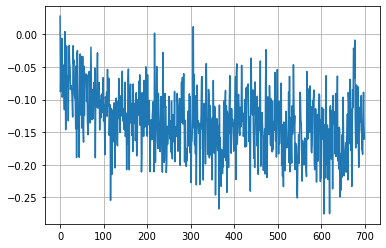

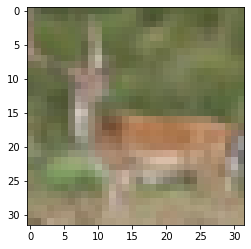

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


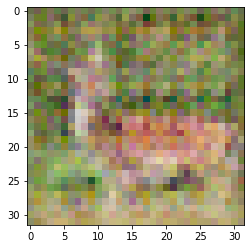

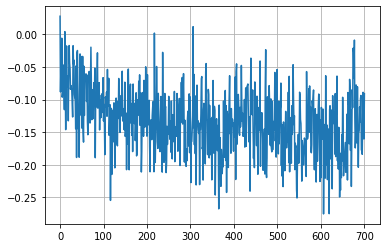

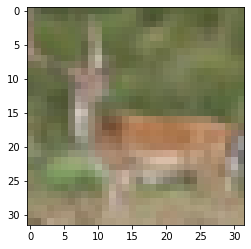

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


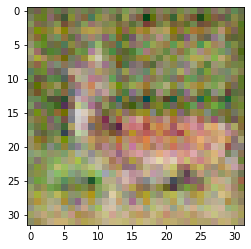

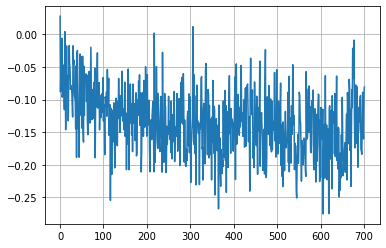

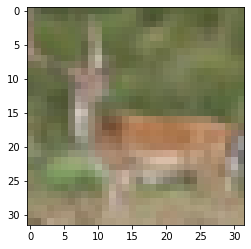

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


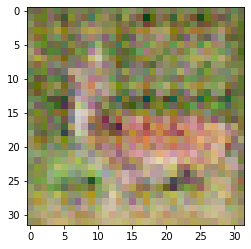

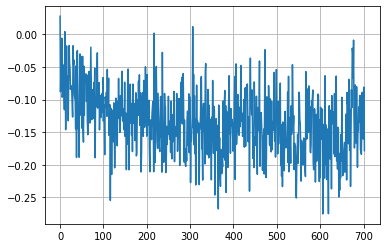

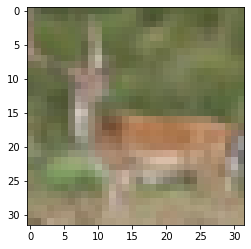

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


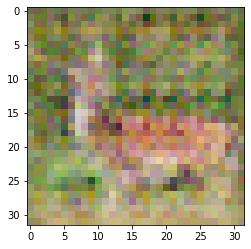

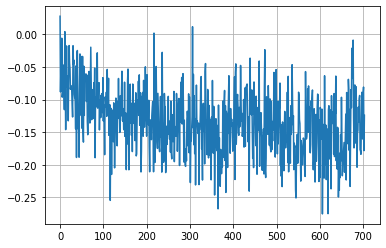

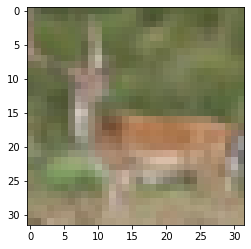

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


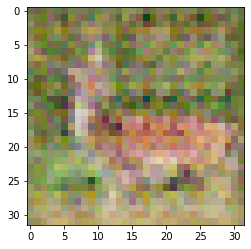

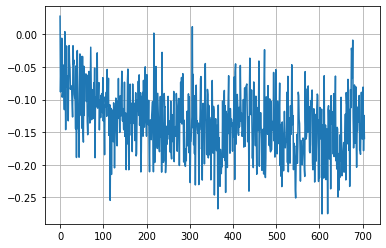

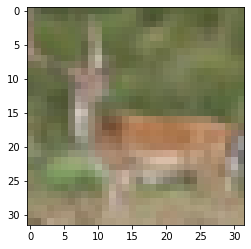

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


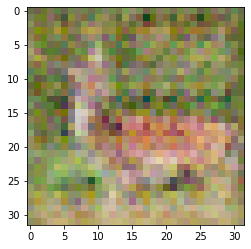

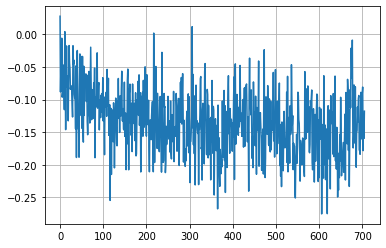

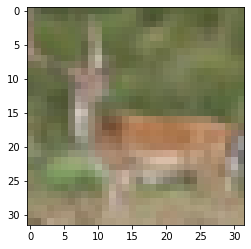

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


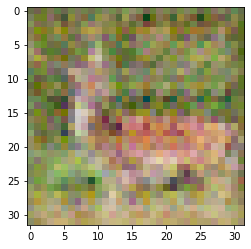

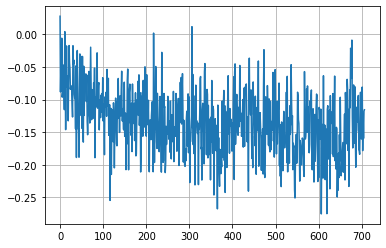

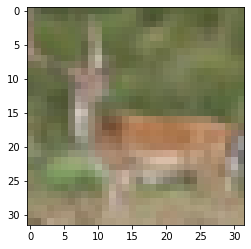

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


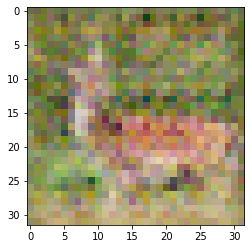

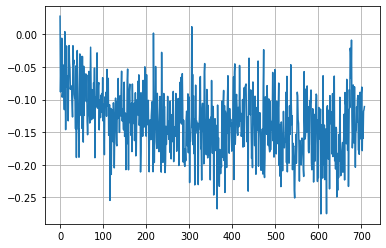

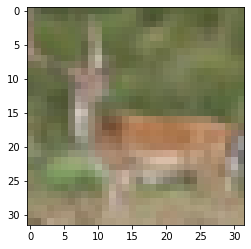

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


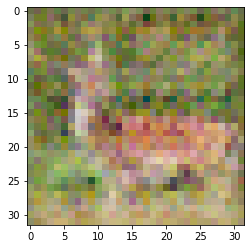

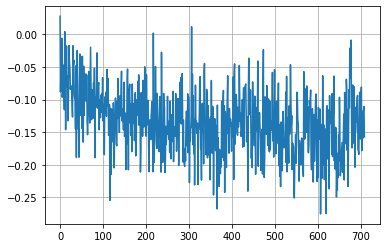

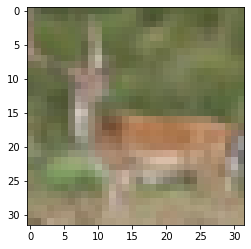

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


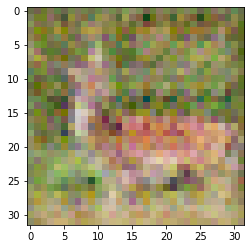

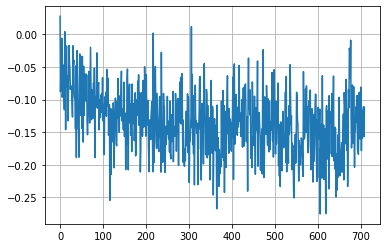

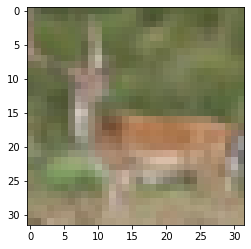

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


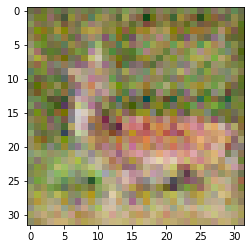

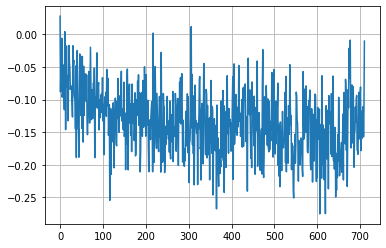

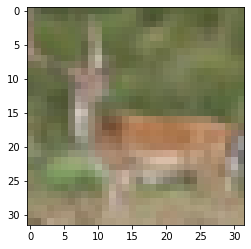

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


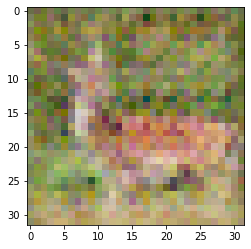

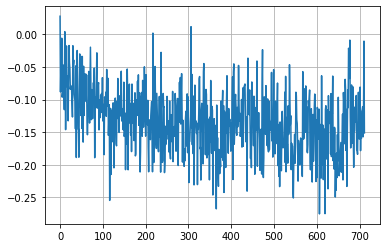

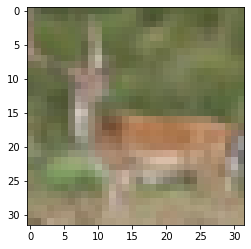

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


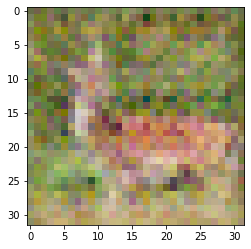

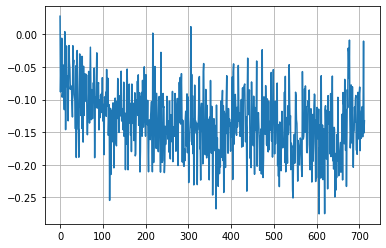

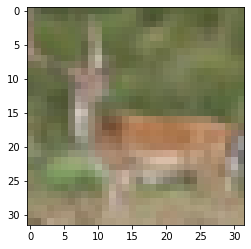

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


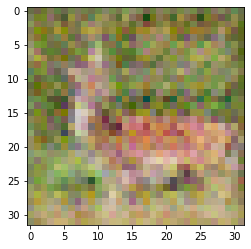

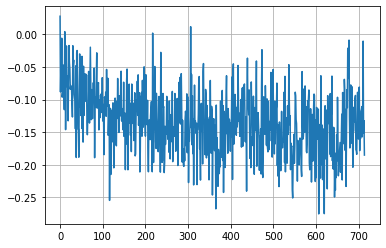

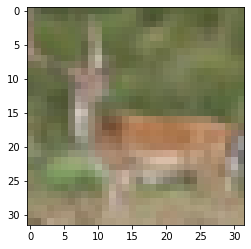

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


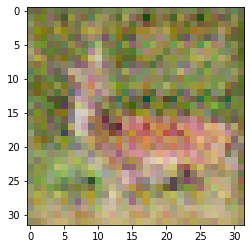

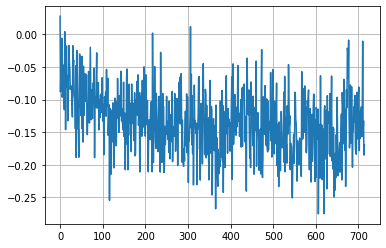

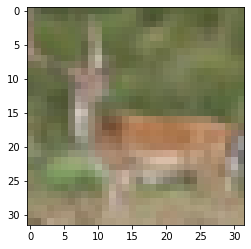

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


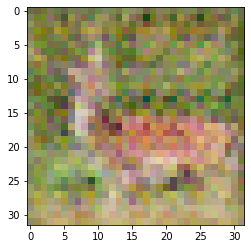

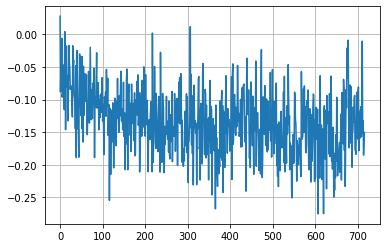

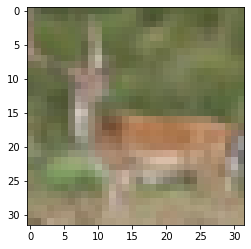

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


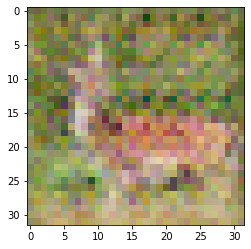

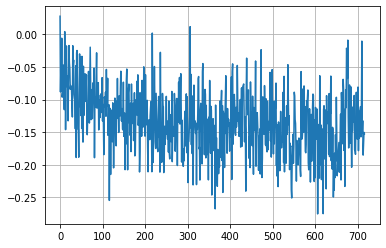

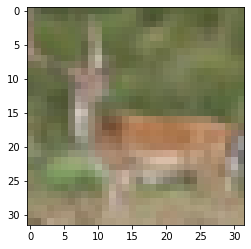

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


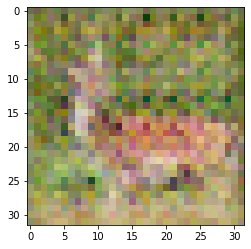

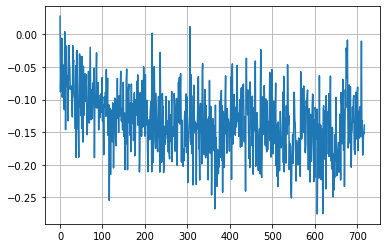

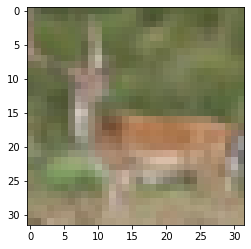

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


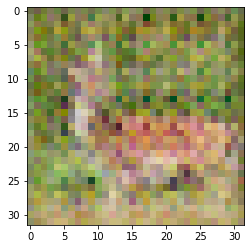

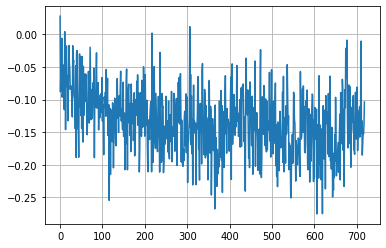

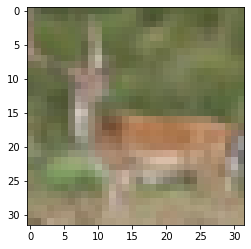

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


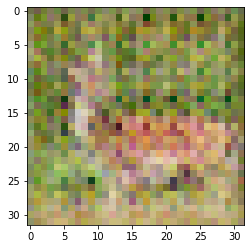

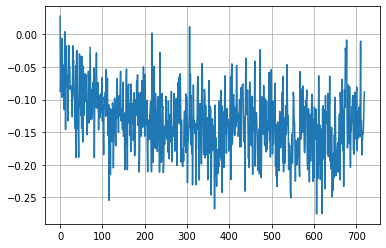

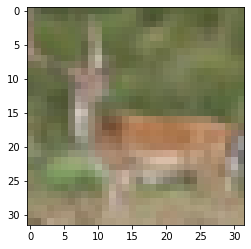

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


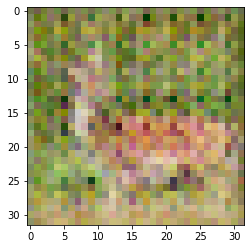

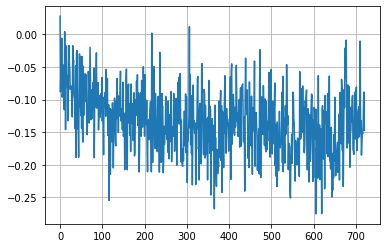

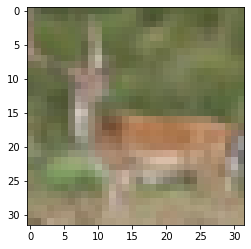

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


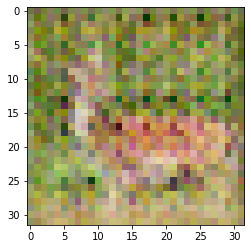

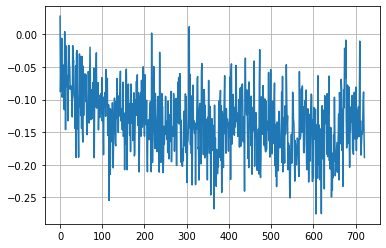

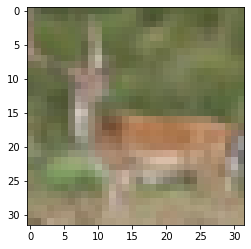

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


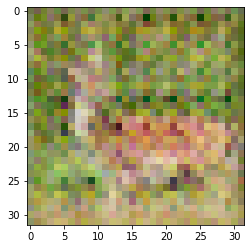

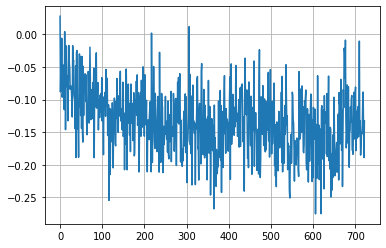

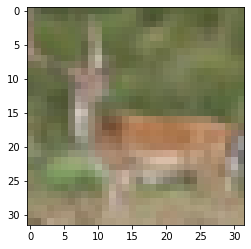

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


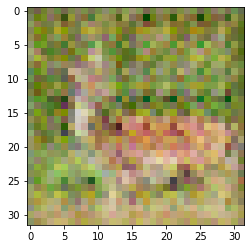

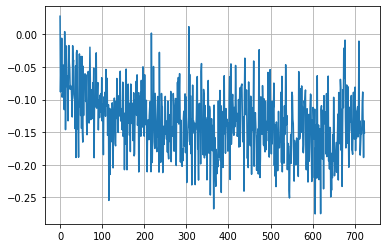

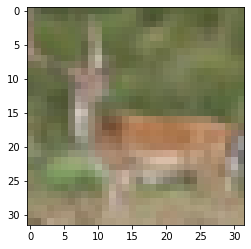

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


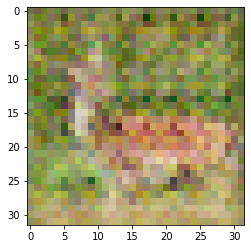

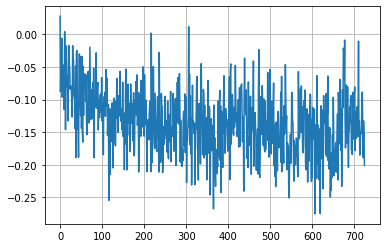

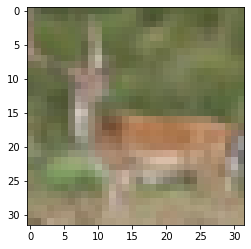

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


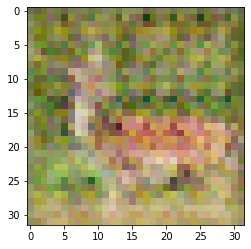

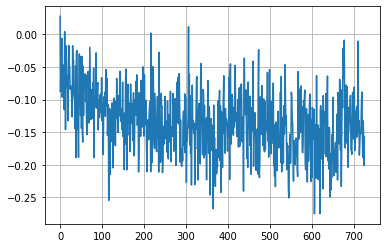

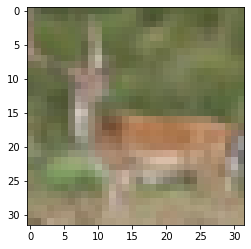

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


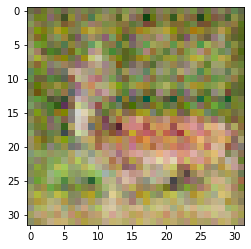

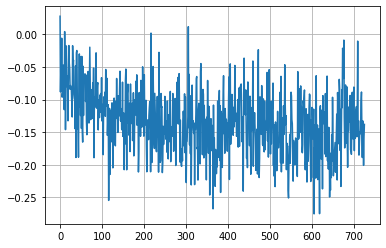

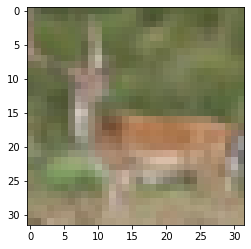

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


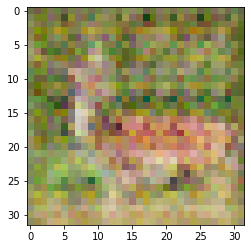

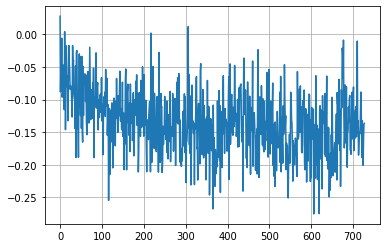

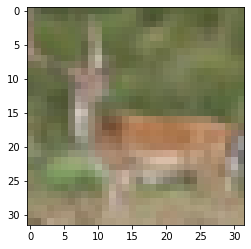

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


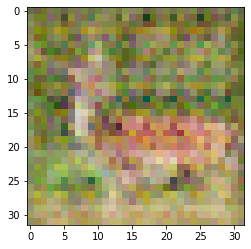

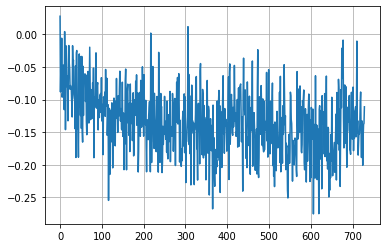

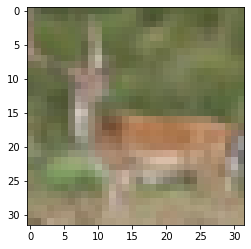

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


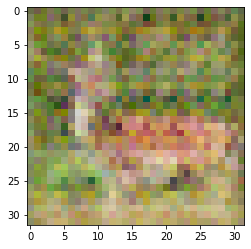

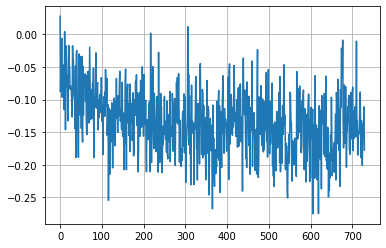

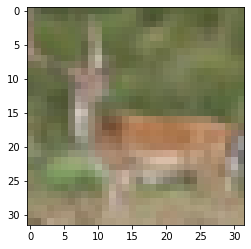

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


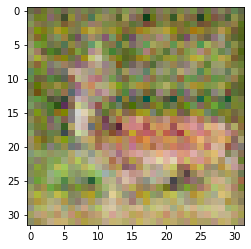

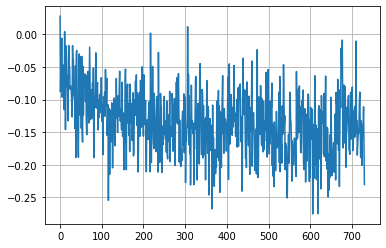

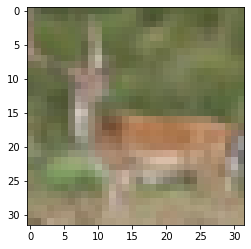

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


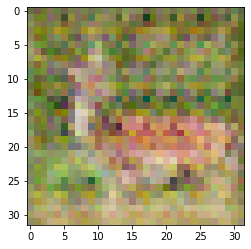

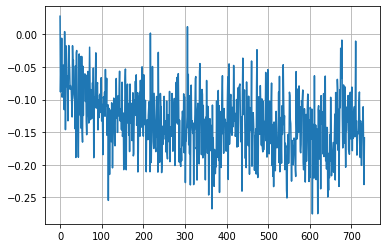

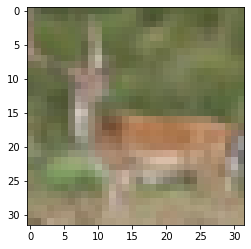

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


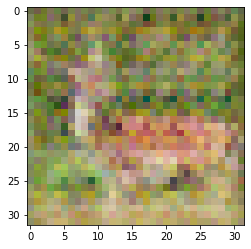

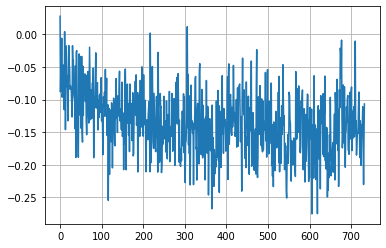

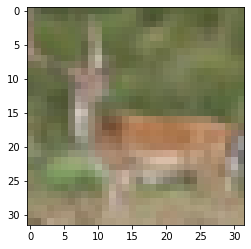

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


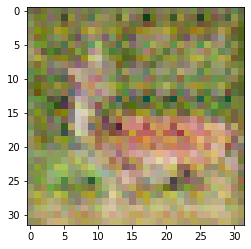

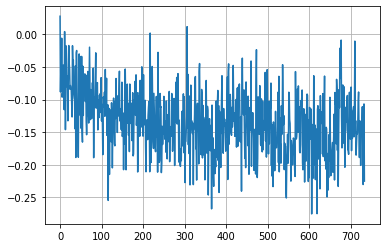

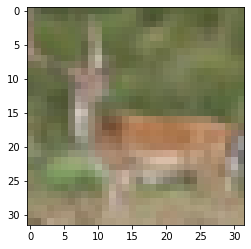

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


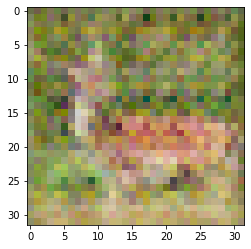

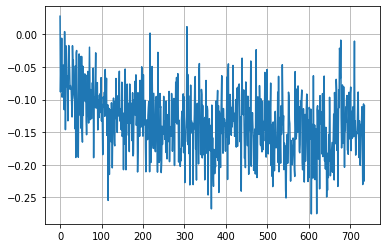

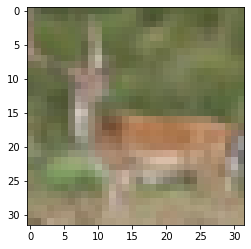

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


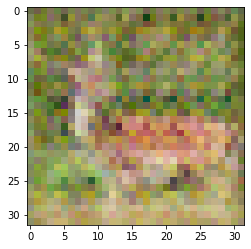

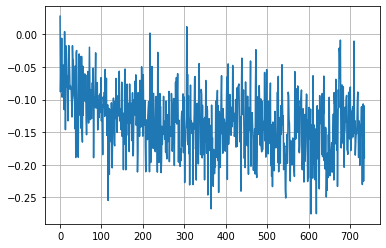

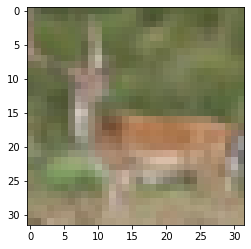

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


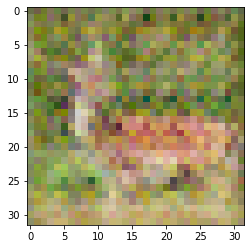

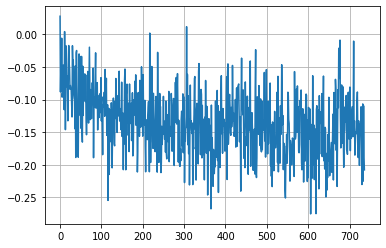

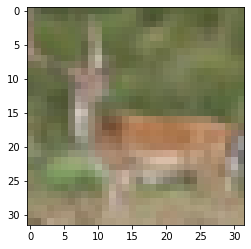

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


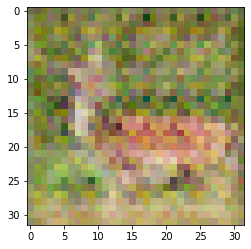

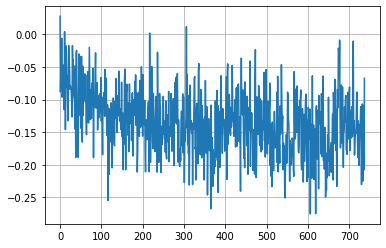

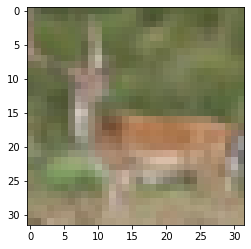

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


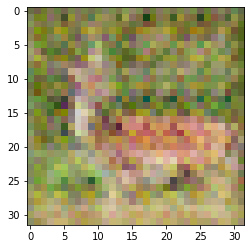

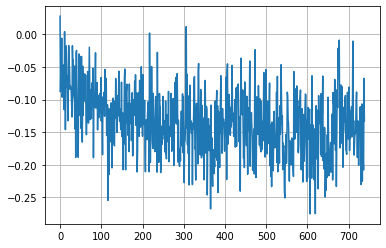

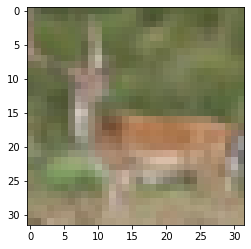

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


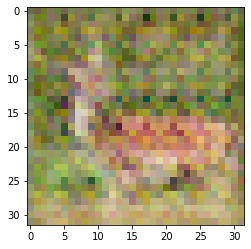

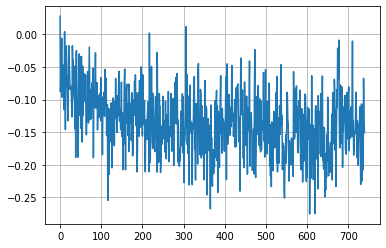

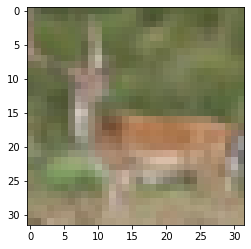

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


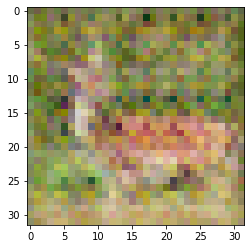

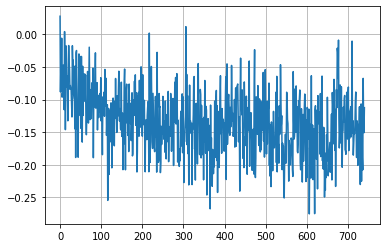

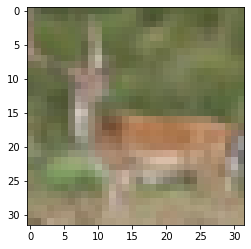

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


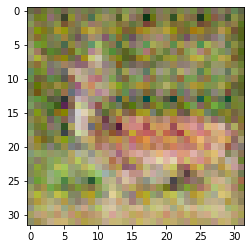

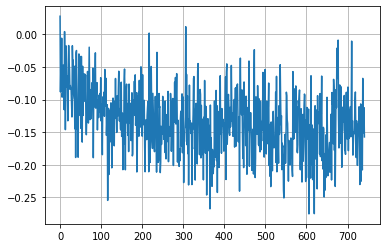

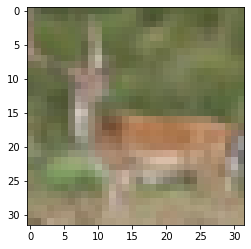

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


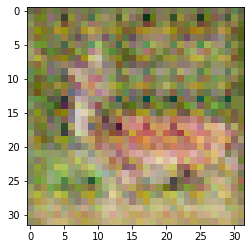

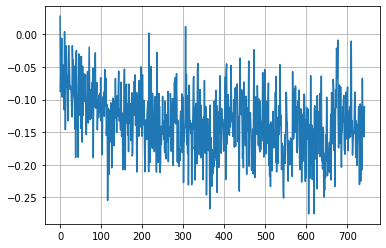

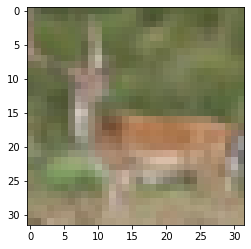

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


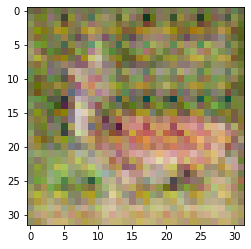

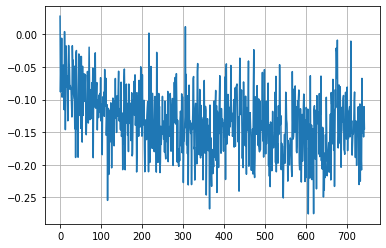

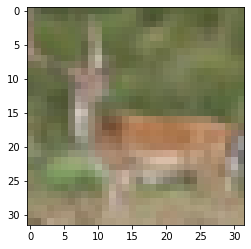

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


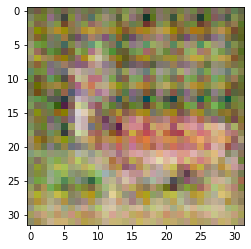

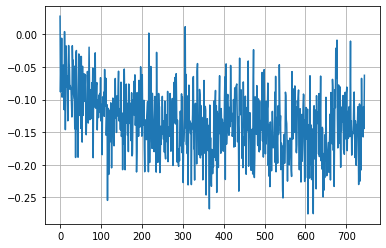

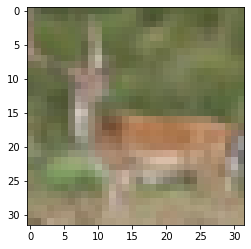

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


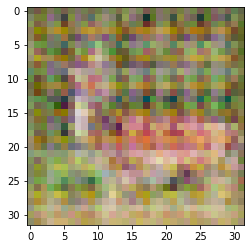

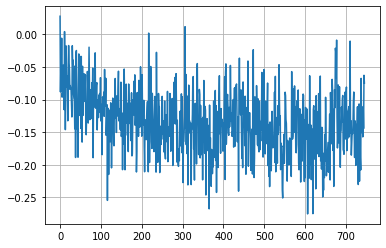

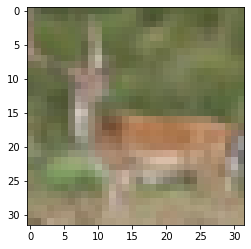

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


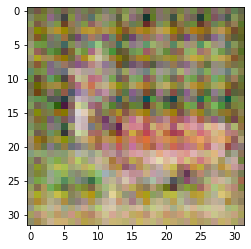

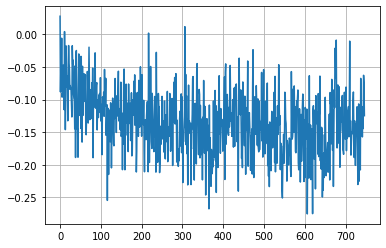

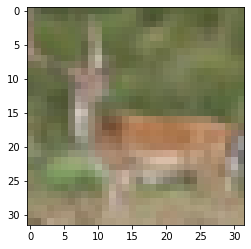

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


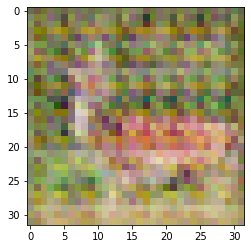

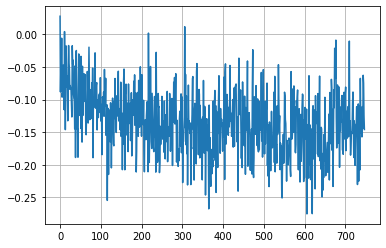

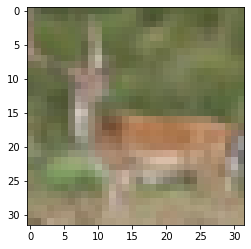

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


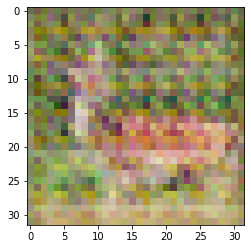

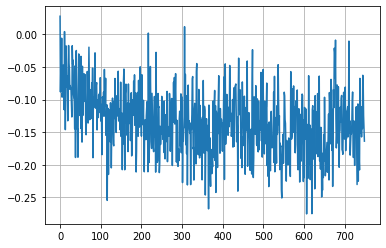

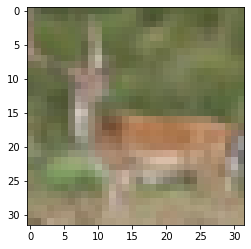

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


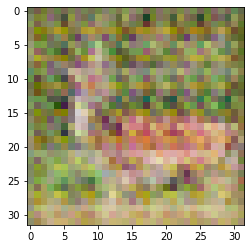

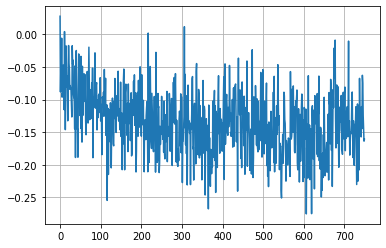

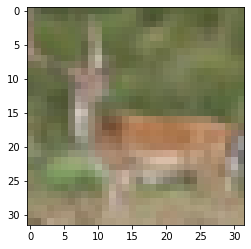

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


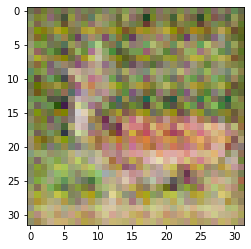

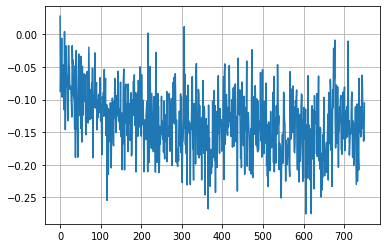

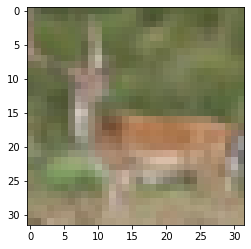

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


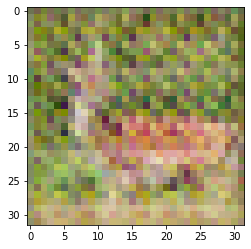

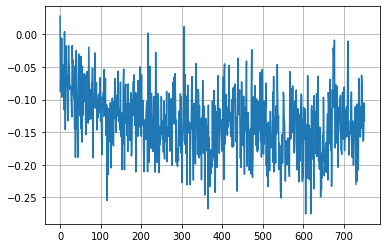

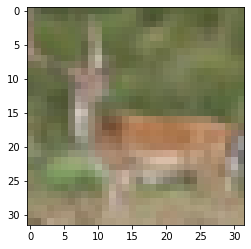

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


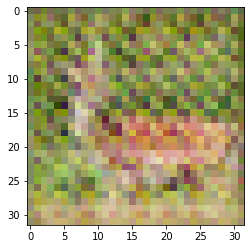

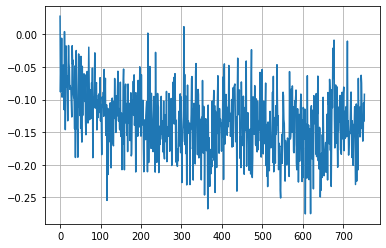

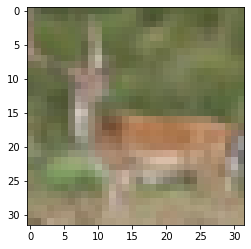

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


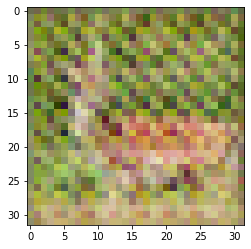

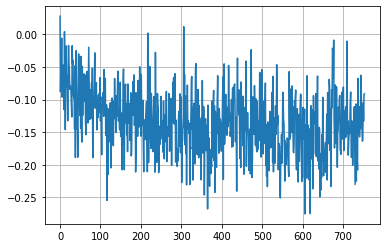

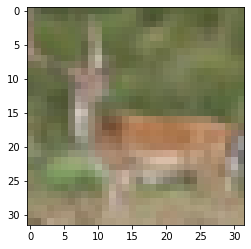

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


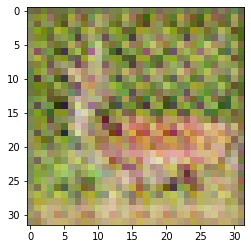

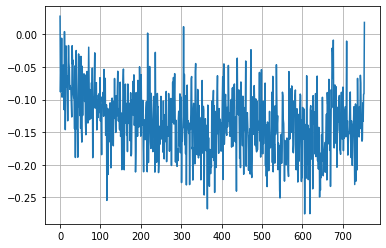

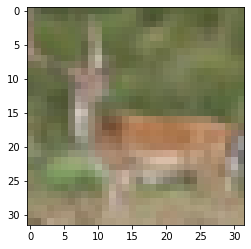

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


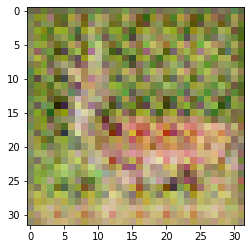

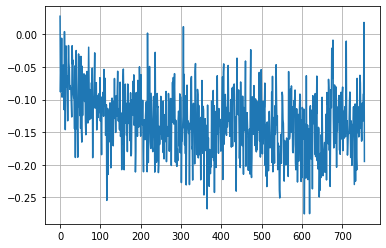

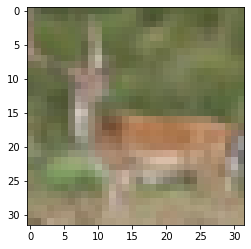

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


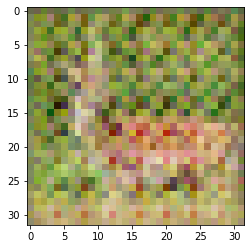

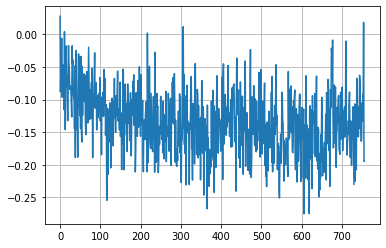

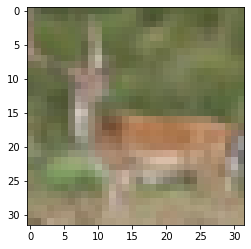

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


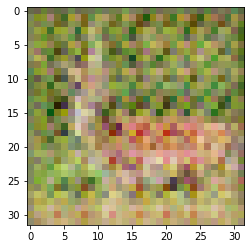

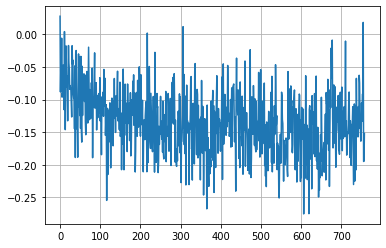

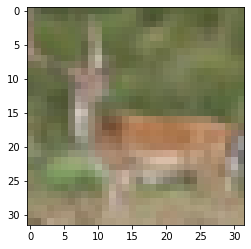

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


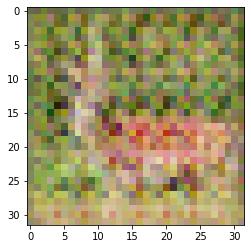

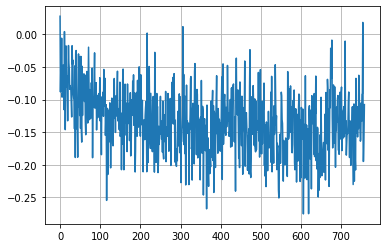

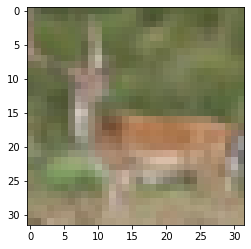

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


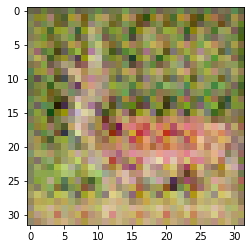

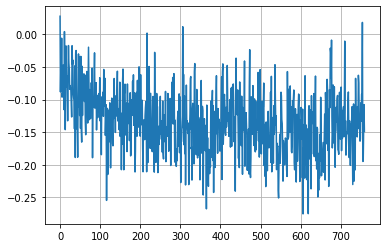

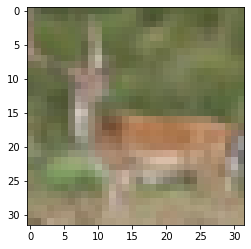

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


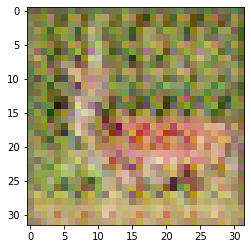

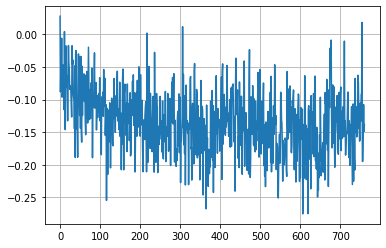

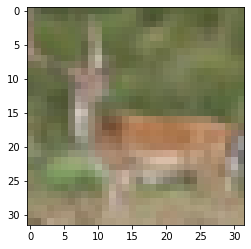

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


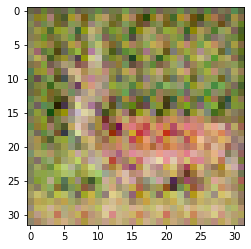

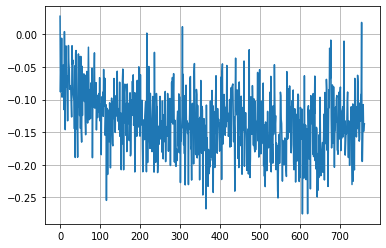

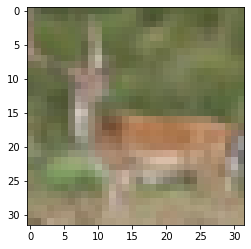

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


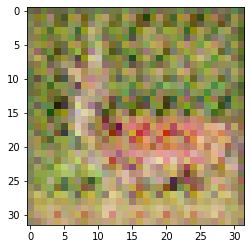

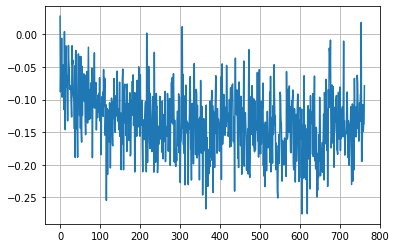

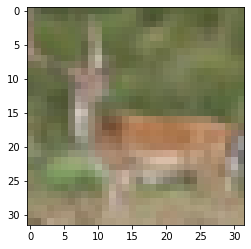

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


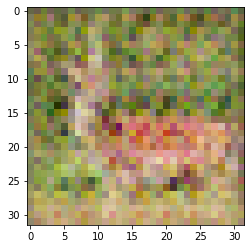

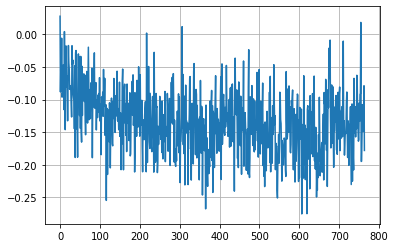

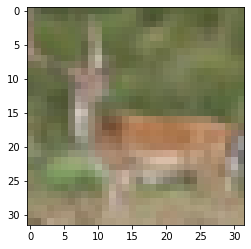

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


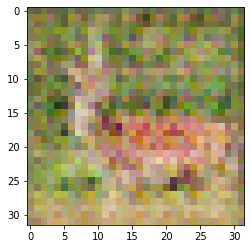

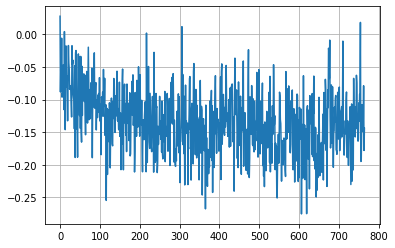

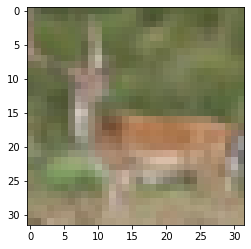

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


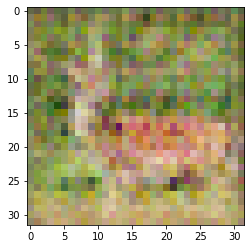

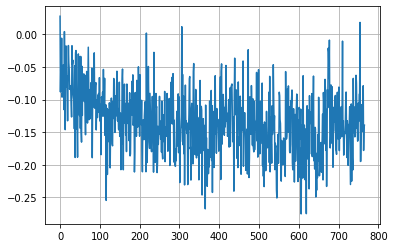

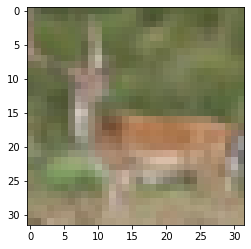

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


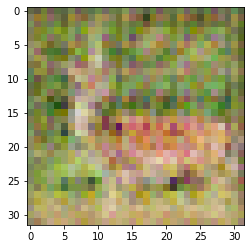

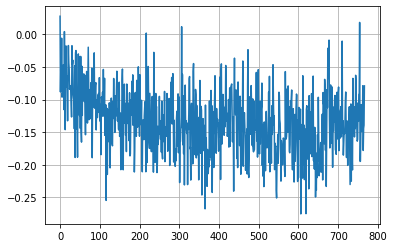

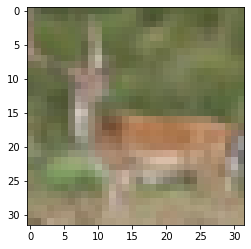

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


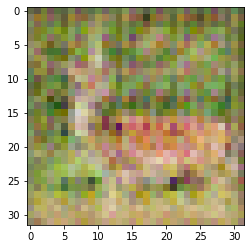

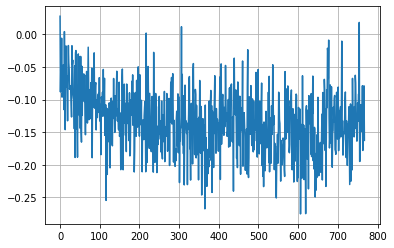

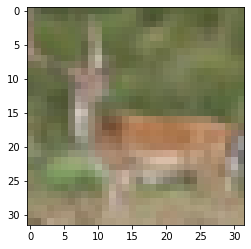

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


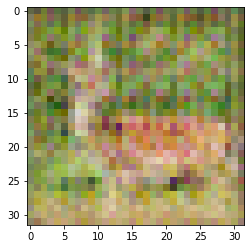

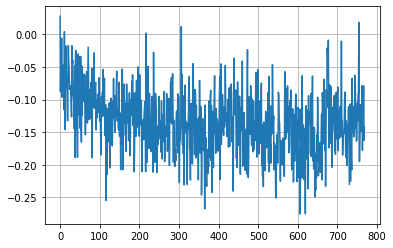

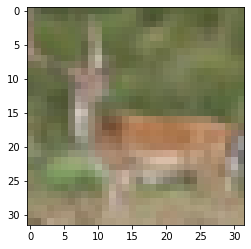

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


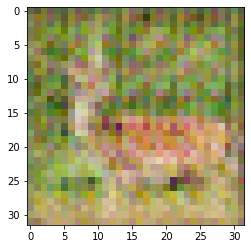

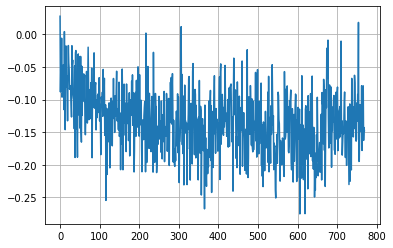

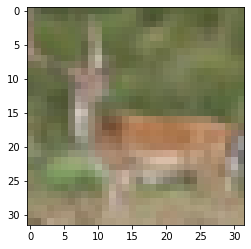

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


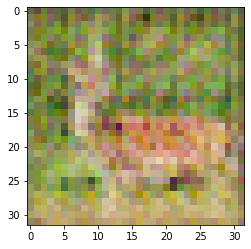

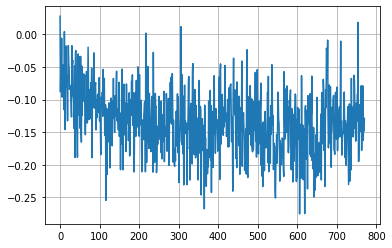

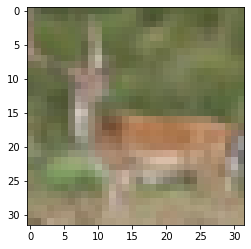

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


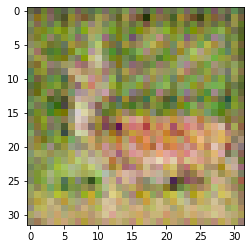

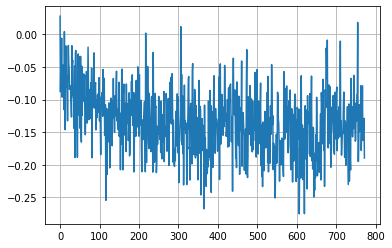

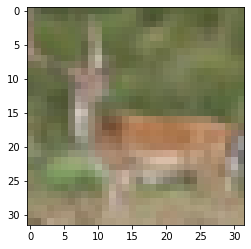

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


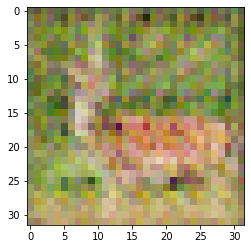

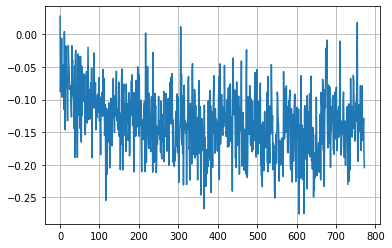

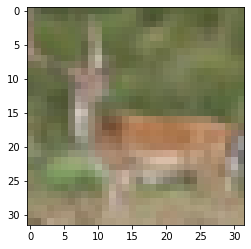

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


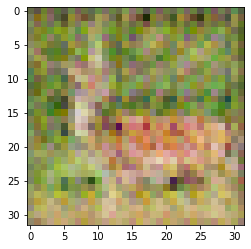

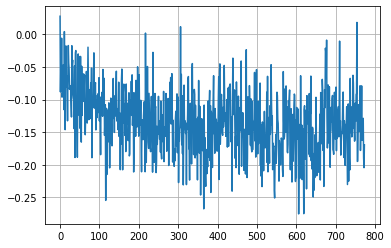

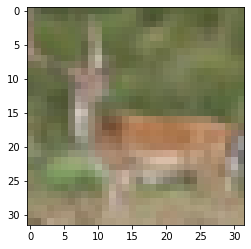

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


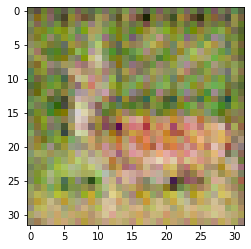

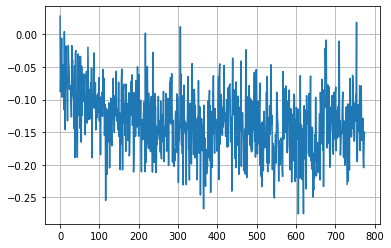

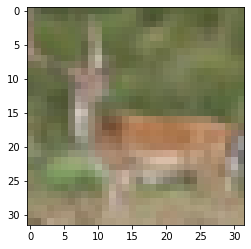

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


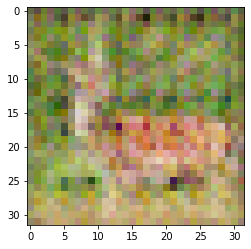

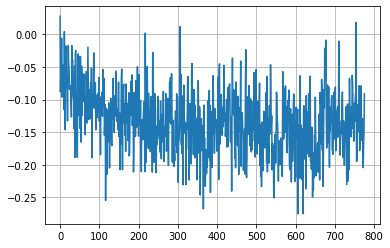

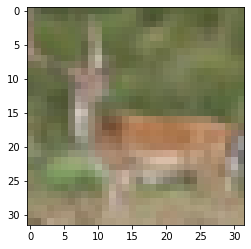

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


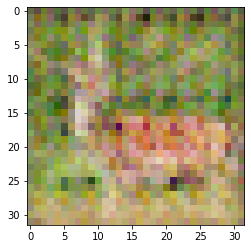

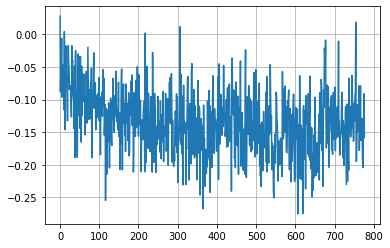

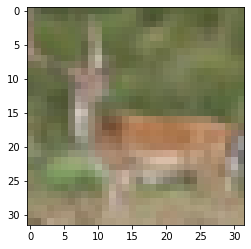

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


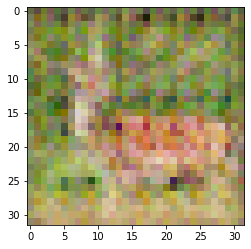

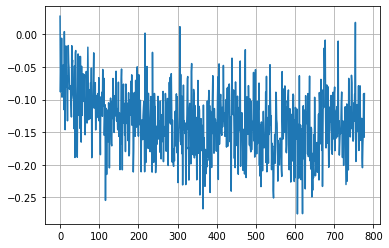

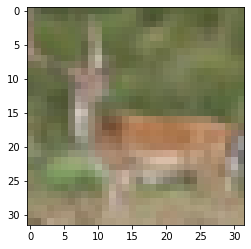

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


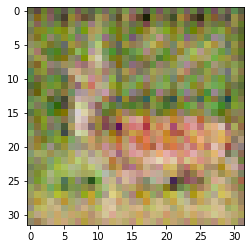

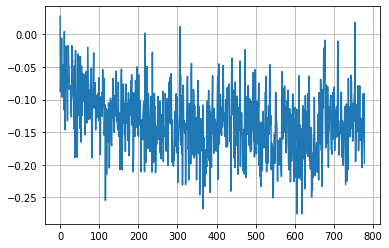

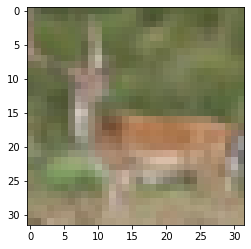

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


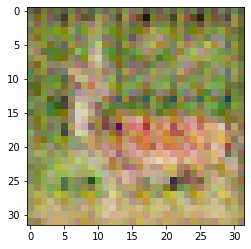

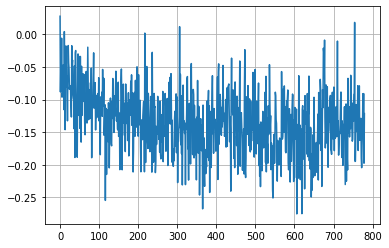

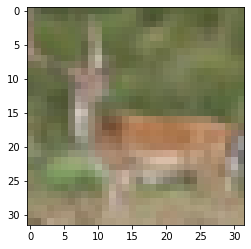

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


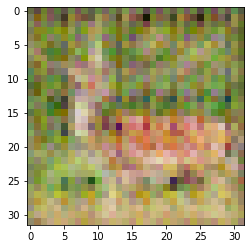

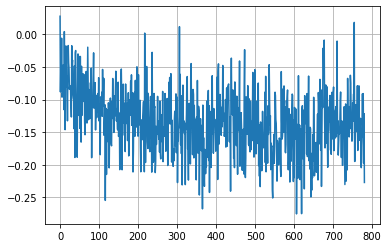

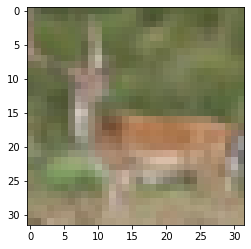

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


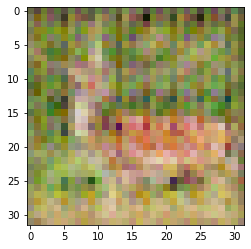

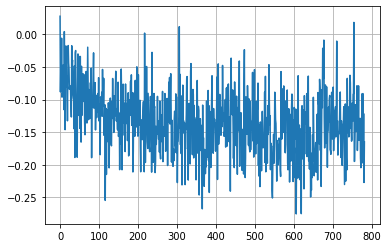

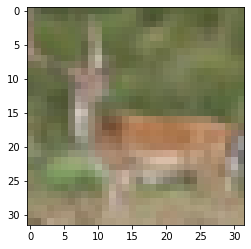

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


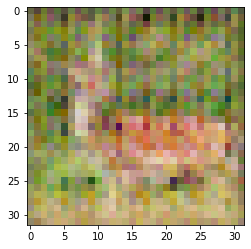

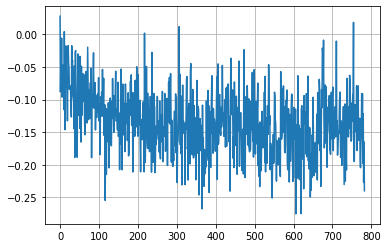

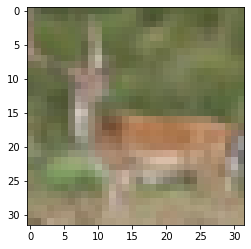

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


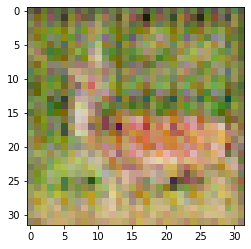

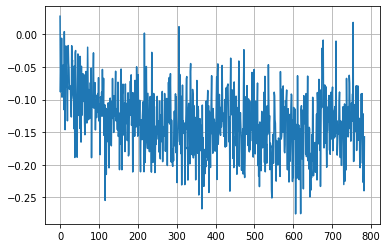

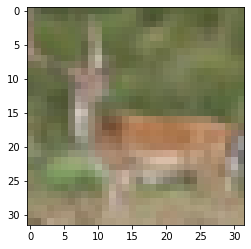

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


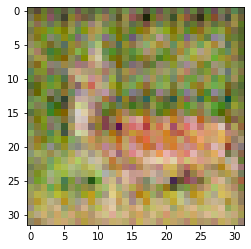

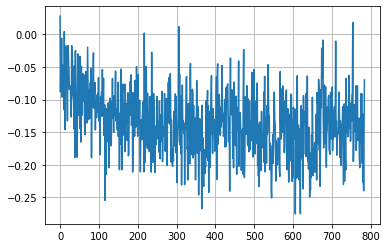

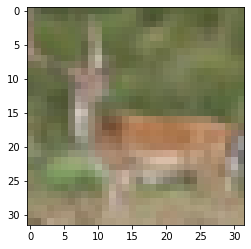

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


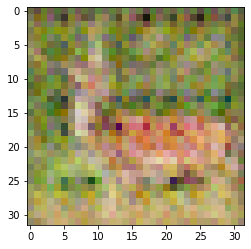

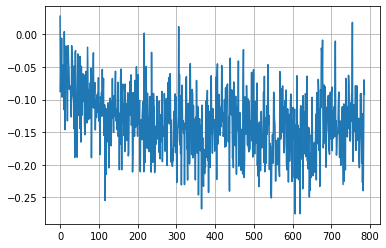

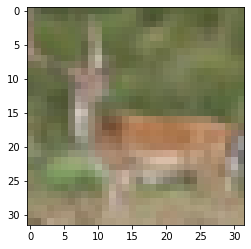

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


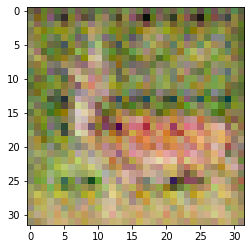

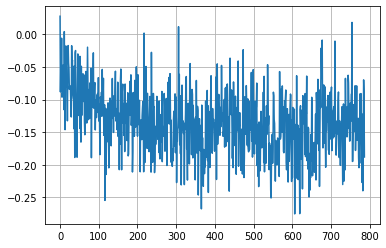

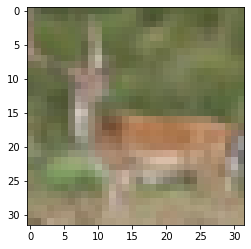

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


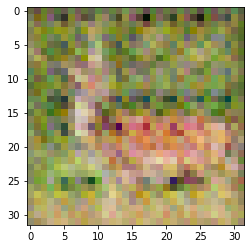

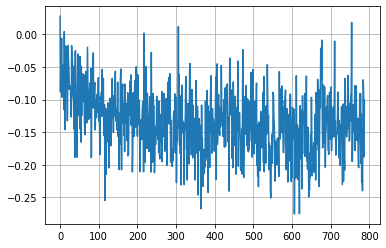

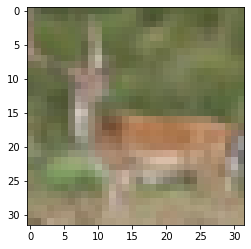

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


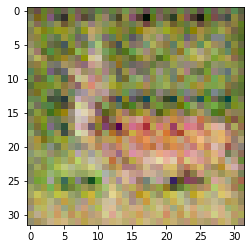

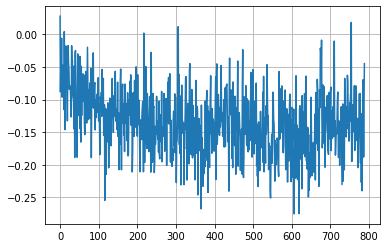

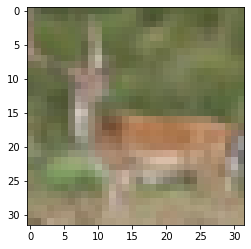

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


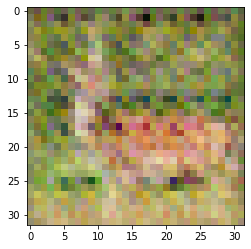

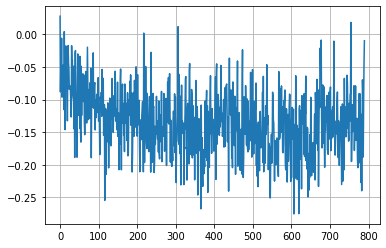

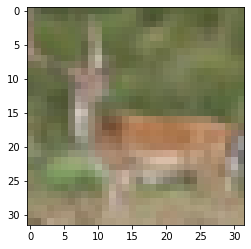

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


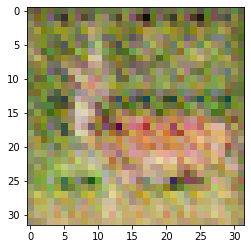

In [17]:
losses = []
gradient_losses = []
losses2 = []
n_epochs = 10
n_restarts = 1
class_criterion = nn.CrossEntropyLoss()
lr = 0.01
beta1 = 0.5
lr_adam = 1e-04
# Generator = UnetGenerator(input_nc, output_nc, 5, ngf, norm_layer=norm_layer, use_dropout=use_dropout).to(device)

optimizer_g = optim.Adam(Generator.parameters(), lr = lr_adam, betas = (beta1, 0.999))
# optimizer_g = optim.SGD(Generator.parameters(), lr = lr_adam, momentum=0.9)#, weight_decay=0.0002)
for restart in range(n_restarts):
#     net = VGG()
#     net.reset() 
#     net.train()            
#     w = torch.tensor(net.get_param().cpu().detach().numpy(), requires_grad = True).to(device) 
    w = w_list[0][0]
    w_mom = torch.zeros(w.size(), requires_grad = False).to(device) 
    imgs,labels = iter(cifar10_trainloader).next()
#     im_noise = torch.zeros(imgs.size(), requires_grad = True)
#     im_noise_mom = torch.zeros(imgs.size())
#     cifar10_trainloader, cifar10_valloader = split_dataset()
    for epoch in range(n_epochs):
        
        total = 0
        correct = 0
        count = 0
#         for batch in (cifar10_trainloader):

#             imgs, labels = batch
        imgs, labels = imgs.to(device), labels.to(device)
        cc = 0 
        for batch_test in cifar10_testloader:
            imgs_test, labels_test = batch_test
            imgs_test, labels_test = imgs_test.to(device), labels_test.to(device)

            ### autoencoder classifier
#             im_ae = Generator(imgs) + imgs             
            im_noise = Generator(imgs)      
            im_ae = im_noise  #+ imgs        
            loss_ae = criterionL1(im_noise,imgs)
            with torch.enable_grad():
                outputs = net.forward_with_param(im_ae, w)
                loss = class_criterion(outputs, labels)                
            gw, = torch.autograd.grad(loss, w, grad_outputs = torch.tensor(lr).to(device),create_graph=True) 

            ## test loss
            outputs = net.forward_with_param(imgs_test, w)
            loss_test = class_criterion(outputs, labels_test) 
            dw, = torch.autograd.grad(loss_test, (w,))
            gw1 = gw#(0.9 * w_mom + gw)
            Generator.zero_grad()
            l0 = - (gw1*dw).sum() / (torch.sqrt((gw1*gw1).sum()) * torch.sqrt((dw*dw).sum())) 

            l_full = l0 #+ loss_ae/5
            l_full.backward()

            optimizer_g.step()
            Generator.zero_grad()
            net.zero_grad()
            gradient_losses.append(l0.data)
#                 if cc == 0:
#                     dw0 = dw.detach()
#                     cc += 1
#             with torch.no_grad():
#                 w_mom = 0.9 * w_mom + dw0 * lr
#                 w = w.sub(w_mom).requires_grad_()
# #                 w.grad.zero_()

                # evaluate performance on testset at the end of each epoch
#             print("[%d/%d] [%d/%d]" %(epoch, n_epochs, count, 390))
            count+=1
            
            if count%100:                
                plt.plot(gradient_losses)
                plt.grid(True)
                plt.show()
                out_img = Generator(imgs)
                imshow(imgs[0,:,:,:].squeeze().cpu().detach().numpy())   
                imshow(out_img[0,:,:,:].squeeze().cpu().detach().numpy()) 
#             break
#         eval_target_net(net, cifar10_testloader, w, classes = classes)       

#                 w = w.sub(gw).requires_grad_()
#         
#         eval_target_net2(net, cifar10_valloader, w, classes = classes)
#             break
#     if epoch%10 == 0:
#         torch.save(net, 'CIFAR10_VGG_trained_robust%i.pt' %epoch)


In [32]:
# losses = []
# gradient_losses = []
# losses2 = []
# n_epochs = 1
# n_restarts = 1
# class_criterion = nn.CrossEntropyLoss()
# lr = 0.01
# beta1 = 0.5
# lr_adam = 1e-04
# # Generator = UnetGenerator(input_nc, output_nc, 5, ngf, norm_layer=norm_layer, use_dropout=use_dropout).to(device)

# optimizer_g = optim.Adam(Generator.parameters(), lr = lr_adam, betas = (beta1, 0.999))
# # optimizer_g = optim.SGD(Generator.parameters(), lr = lr_adam, momentum=0.9)#, weight_decay=0.0002)

# w = w_list[0][0]
# w_mom = torch.zeros(w.size(), requires_grad = False).to(device) 
# for batch in (cifar10_trainloader):
#     for batch_test in cifar10_testloader:
#         imgs_test, labels_test = batch_test
#         imgs_test, labels_test = imgs_test.to(device), labels_test.to(device)
#         break

#     ## test loss
#     outputs = net.forward_with_param(imgs_test, w)
#     loss_test = class_criterion(outputs, labels_test) 
#     dw, = torch.autograd.grad(loss_test, (w,))

#     net.zero_grad()

#     with torch.no_grad():
#         w_mom = 0.9 * w_mom + dw.detach() * lr
#         w = w.sub(w_mom).requires_grad_()

# eval_target_net(net, cifar10_testloader, w, classes = classes)       


Accuracy of airplane : 99.30 %
Accuracy of automobile : 99.80 %
Accuracy of bird : 99.40 %
Accuracy of cat : 97.70 %
Accuracy of deer : 99.60 %
Accuracy of dog : 99.60 %
Accuracy of frog : 99.80 %
Accuracy of horse : 99.20 %
Accuracy of ship : 99.40 %
Accuracy of truck : 98.60 %

Total accuracy = 99.24 %




99.24

[0/30]
Train Accuracy 93.204000


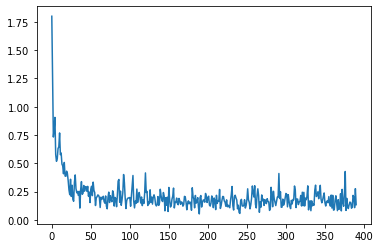

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


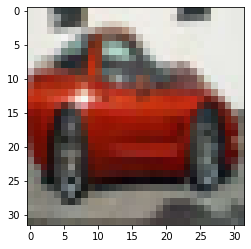

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


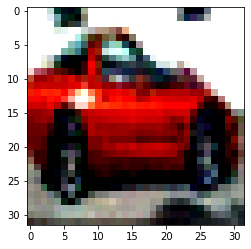


Total accuracy = 78.46 %


[1/30]
Train Accuracy 96.896000


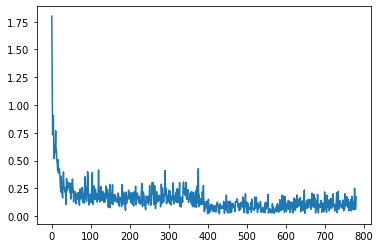

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


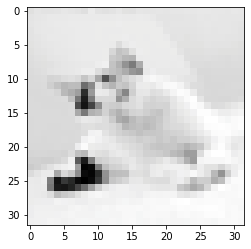

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


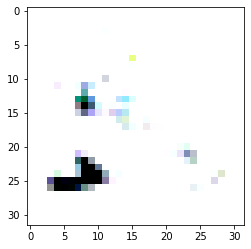


Total accuracy = 78.92 %


[2/30]
Train Accuracy 97.730000


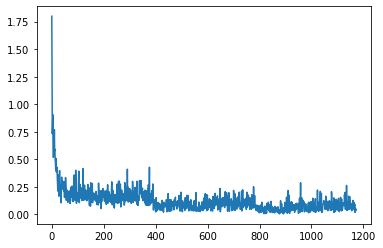

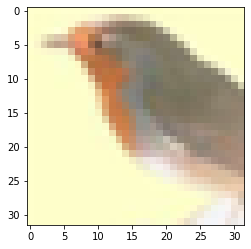

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


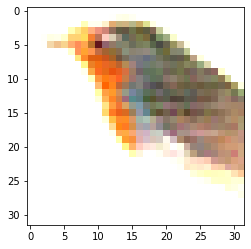


Total accuracy = 78.60 %


[3/30]
Train Accuracy 98.034000


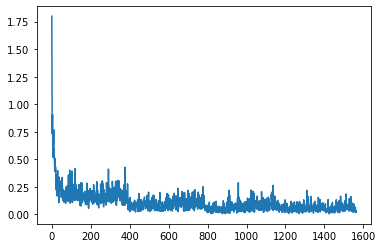

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


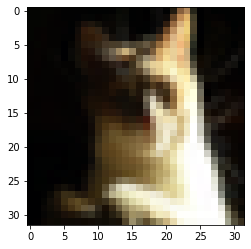

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


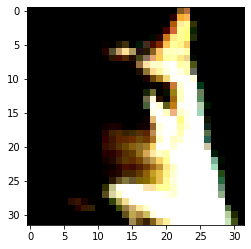


Total accuracy = 79.53 %


[4/30]
Train Accuracy 98.296000


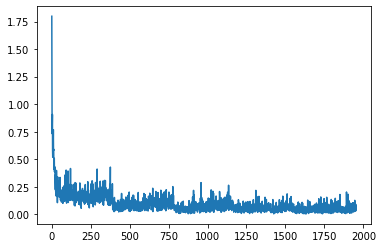

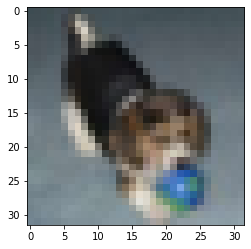

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


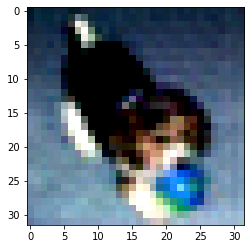


Total accuracy = 79.04 %


[5/30]
Train Accuracy 98.854000


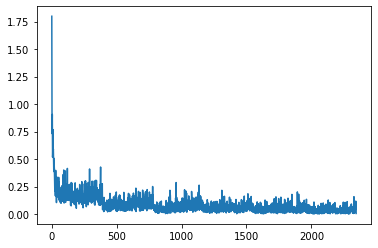

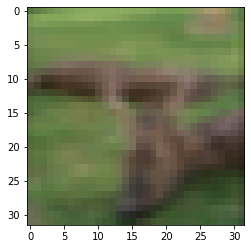

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


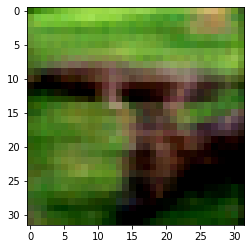


Total accuracy = 78.97 %


[6/30]
Train Accuracy 98.740000


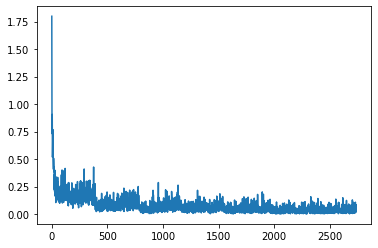

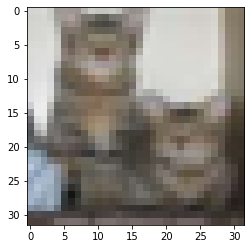

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


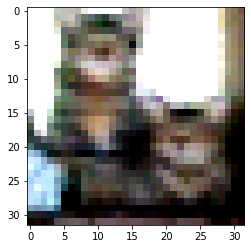


Total accuracy = 79.17 %


[7/30]
Train Accuracy 98.800000


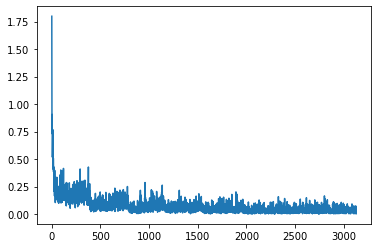

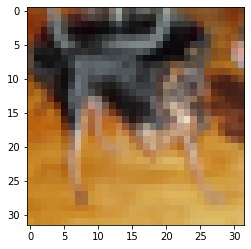

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


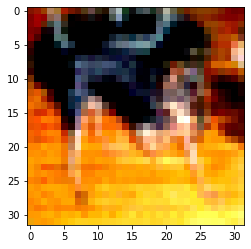


Total accuracy = 80.13 %


[8/30]
Train Accuracy 98.994000


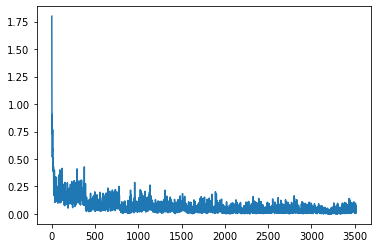

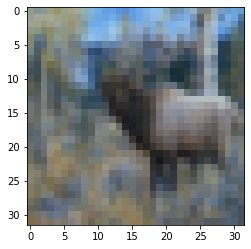

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


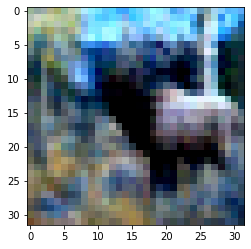


Total accuracy = 79.35 %


[9/30]
Train Accuracy 99.028000


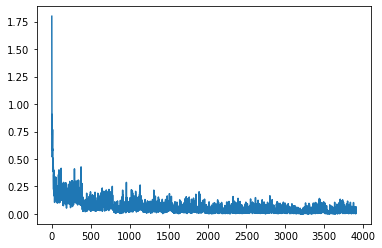

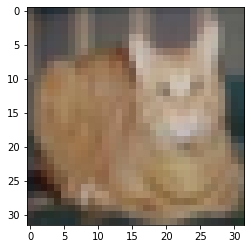

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


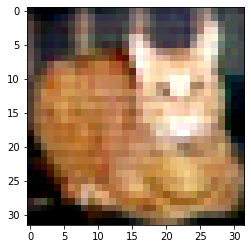


Total accuracy = 79.63 %


[10/30]
Train Accuracy 99.210000


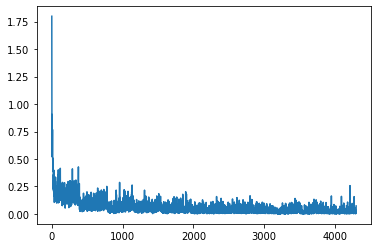

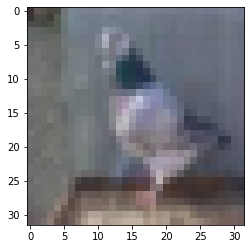

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


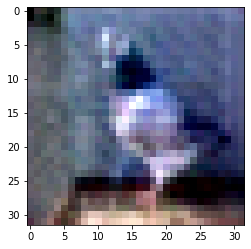


Total accuracy = 79.47 %


[11/30]
Train Accuracy 99.162000


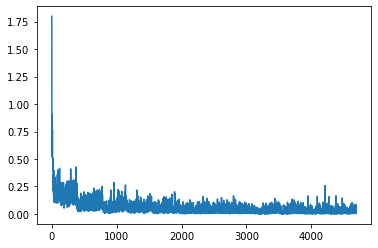

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


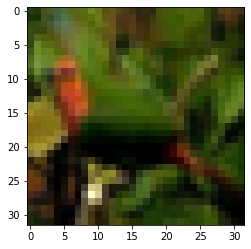

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


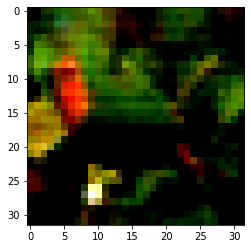


Total accuracy = 79.65 %


[12/30]
Train Accuracy 99.284000


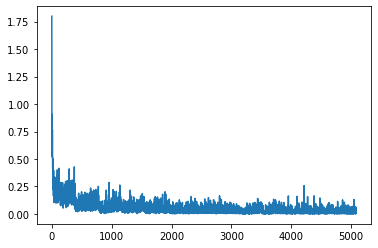

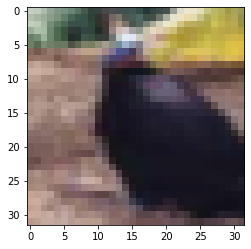

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


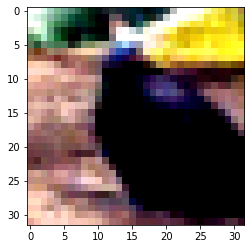


Total accuracy = 80.02 %


[13/30]
Train Accuracy 99.524000


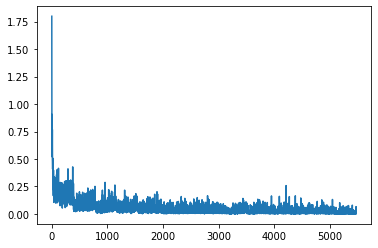

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


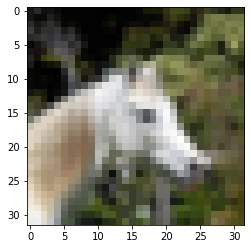

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


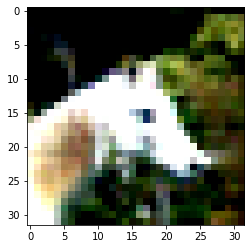


Total accuracy = 80.47 %


[14/30]
Train Accuracy 99.182000


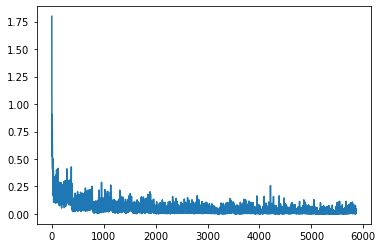

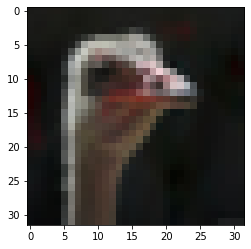

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


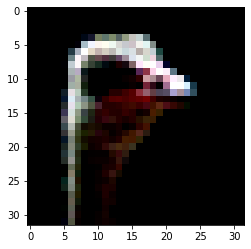


Total accuracy = 79.89 %


[15/30]
Train Accuracy 99.380000


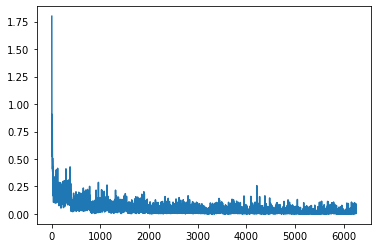

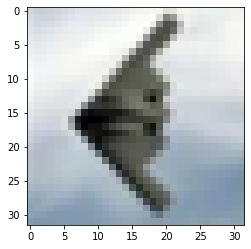

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


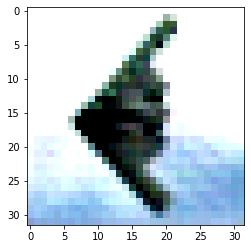


Total accuracy = 79.76 %


[16/30]
Train Accuracy 99.538000


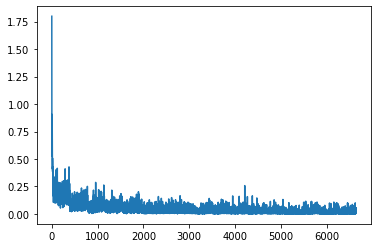

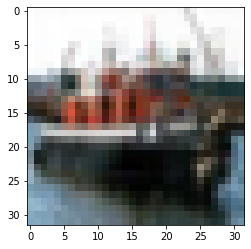

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


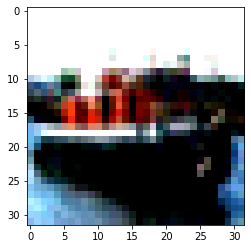


Total accuracy = 79.00 %


[17/30]
Train Accuracy 99.414000


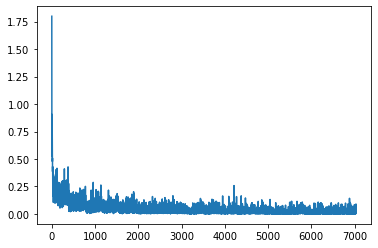

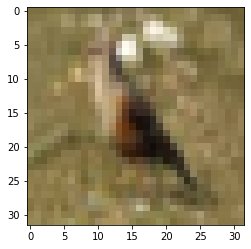

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


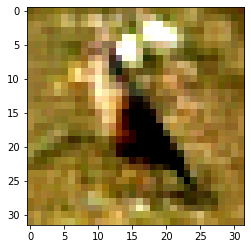


Total accuracy = 80.14 %


[18/30]
Train Accuracy 99.608000


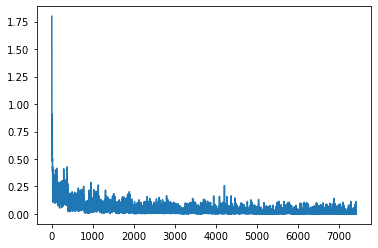

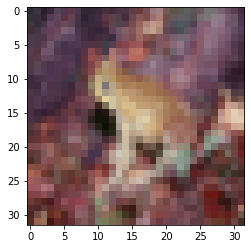

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


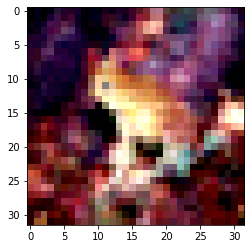


Total accuracy = 79.23 %


[19/30]
Train Accuracy 99.332000


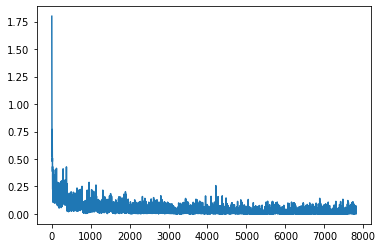

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


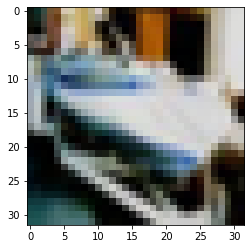

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


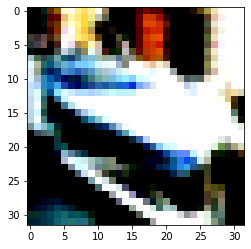


Total accuracy = 80.56 %


[20/30]
Train Accuracy 99.366000


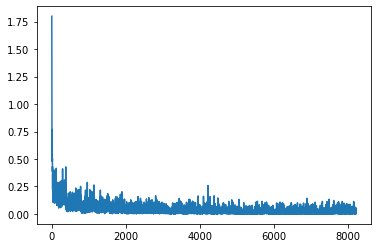

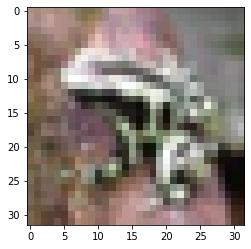

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


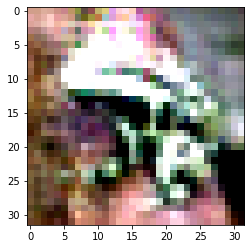


Total accuracy = 79.70 %


[21/30]
Train Accuracy 99.574000


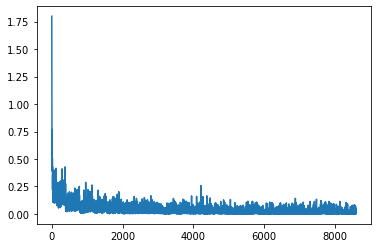

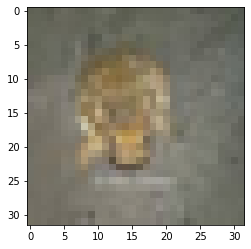

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


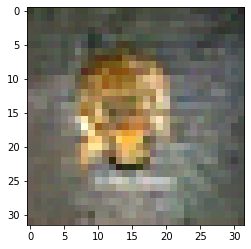


Total accuracy = 79.89 %


[22/30]
Train Accuracy 99.668000


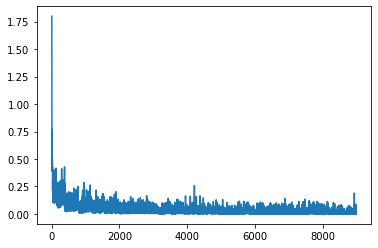

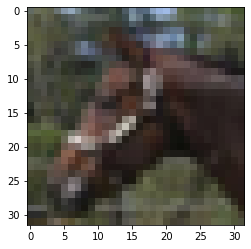

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


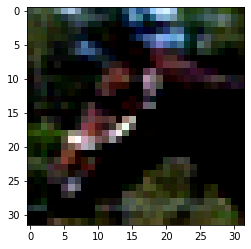


Total accuracy = 79.68 %


[23/30]
Train Accuracy 99.612000


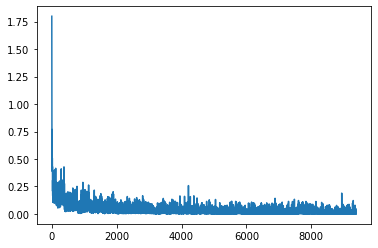

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


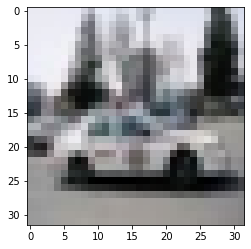

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


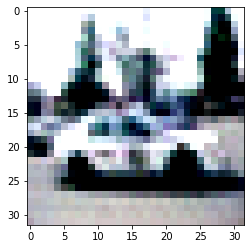


Total accuracy = 79.51 %


[24/30]
Train Accuracy 99.646000


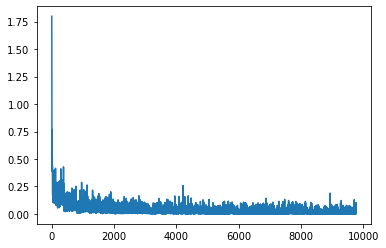

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


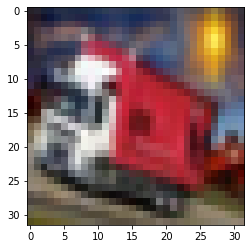

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


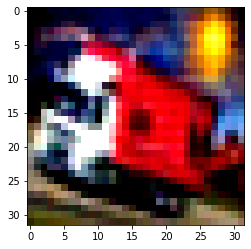


Total accuracy = 80.17 %


[25/30]
Train Accuracy 99.536000


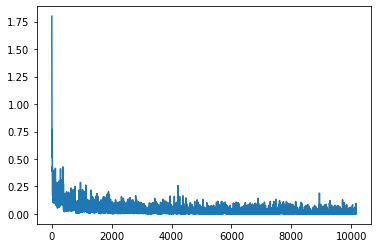

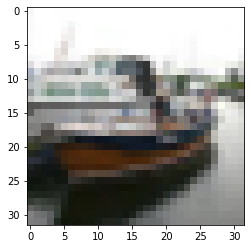

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


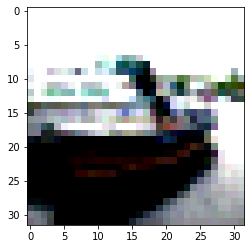


Total accuracy = 80.09 %


[26/30]
Train Accuracy 99.616000


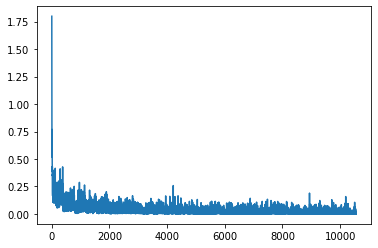

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


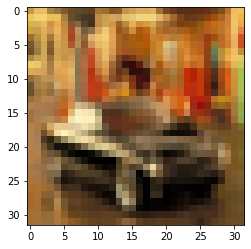

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


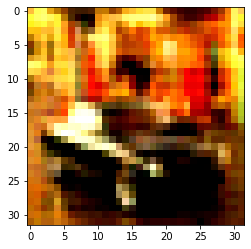


Total accuracy = 79.96 %


[27/30]
Train Accuracy 99.772000


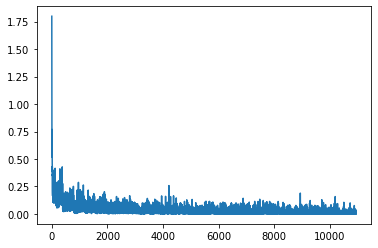

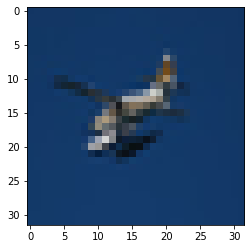

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


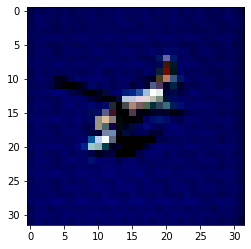


Total accuracy = 80.52 %




In [ ]:
lr = 0.01
class_criterion = nn.CrossEntropyLoss()
w = w_list[0][0]
w_mom = torch.zeros(w.size(), requires_grad = False).to(device) 
n_epochs = 30
losses = []
for epoch in range(n_epochs):

    total = 0
    correct = 0

    for batch in cifar10_trainloader:

        imgs, labels = batch
        imgs, labels = imgs.to(device), labels.to(device)

        ### autoencoder classifier

        im_noise = Generator(imgs)
        im_ae = im_noise  

        with torch.enable_grad():
            outputs = net.forward_with_param(im_ae, w)
            loss = class_criterion(outputs, labels)                
        gw, = torch.autograd.grad(loss, w, grad_outputs = torch.tensor(lr).to(device),create_graph=True) 
        losses.append(loss.data)

        with torch.no_grad():
            w_mom = 0.9 * w_mom + gw
            w = w.sub(w_mom).requires_grad_()

        ## accuracy calc
        predicted = outputs.argmax(dim=1)
        total += imgs.size(0)
        correct += predicted.eq(labels).sum().item() 

        # evaluate performance on testset at the end of each epoch
    print("[%d/%d]" %(epoch, n_epochs))
    print("Train Accuracy %f" %(correct/total*100))
    plt.plot(losses)
    plt.show()
    out_img = Generator(imgs) + imgs
    imshow(imgs[0,:,:,:].squeeze().cpu().detach().numpy())   
    imshow(out_img[0,:,:,:].squeeze().cpu().detach().numpy()) 
    eval_target_net(net, cifar10_testloader, w) 


In [31]:
with open('data_generalizability_AE.pickle', 'rb') as f:
    [losses, losses2, gradient_losses, out_img, imgs, w] = pickle.load(f)
    

UnpicklingError: pickle data was truncated

In [ ]:
plt.plot(losses)
plt.plot(losses2)
plt.show()
plt.plot(gradient_losses)
plt.grid(True)
plt.show()
# out_img = Generator(imgs) + imgs
imshow(imgs[0,:,:,:].squeeze().cpu().detach().numpy())   
imshow(out_img[0,:,:,:].squeeze().cpu().detach().numpy()) 

In [15]:
eval_target_net(net, cifar10_testloader, w)


Total accuracy = 79.54 %




79.54

In [23]:
Generator = torch.load('CIFAR10_VGG_AE_generalizability.pt')

[0/30]
Train Accuracy 95.494000


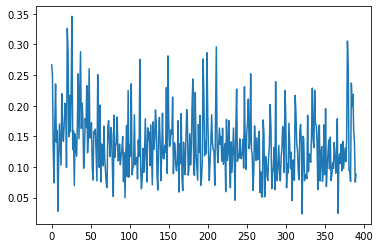

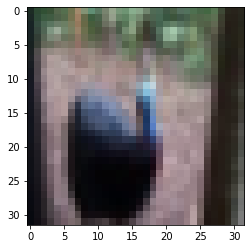

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


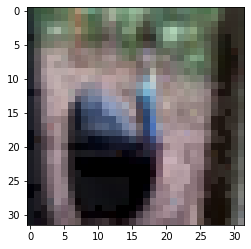


Total accuracy = 80.02 %


[1/30]
Train Accuracy 97.650000


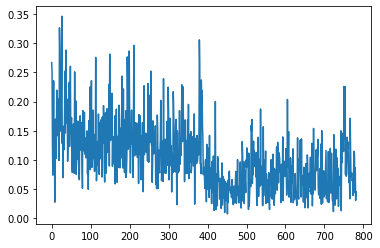

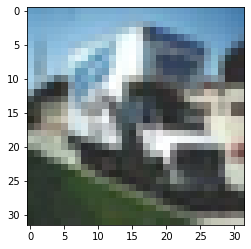

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


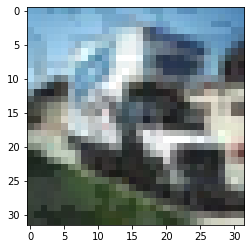


Total accuracy = 80.15 %


[2/30]
Train Accuracy 98.122000


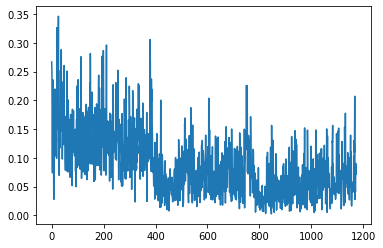

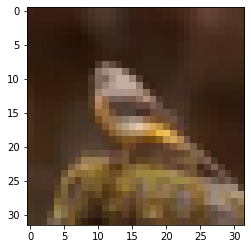

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


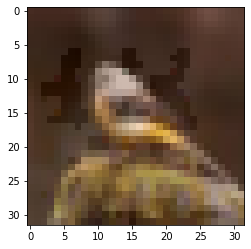


Total accuracy = 78.60 %


[3/30]
Train Accuracy 98.462000


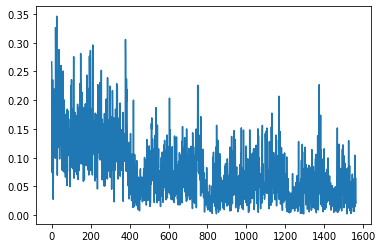

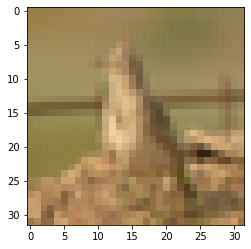

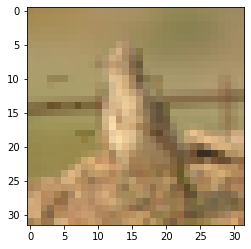


Total accuracy = 81.46 %


[4/30]
Train Accuracy 98.862000


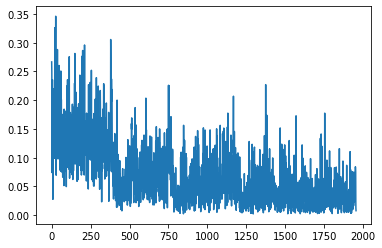

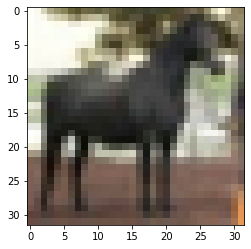

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


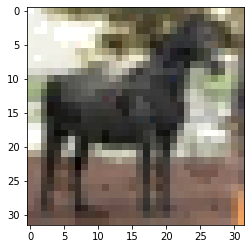


Total accuracy = 80.10 %


[5/30]
Train Accuracy 98.758000


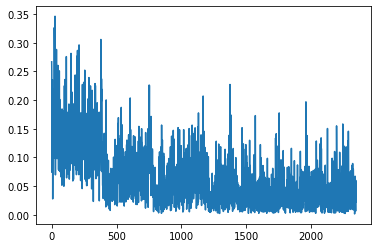

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


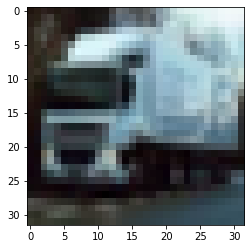

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


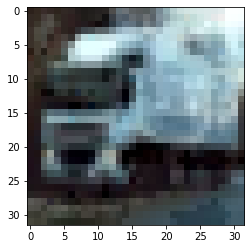


Total accuracy = 80.39 %


[6/30]
Train Accuracy 98.974000


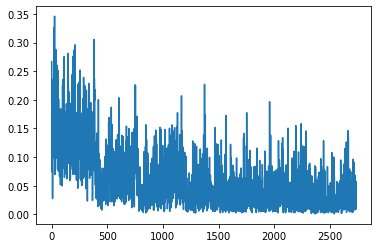

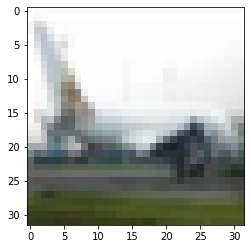

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


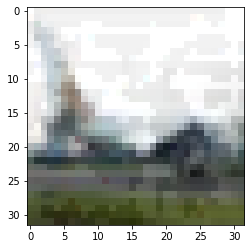


Total accuracy = 80.78 %


[7/30]
Train Accuracy 98.902000


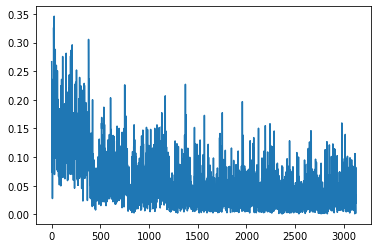

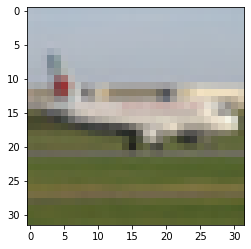

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


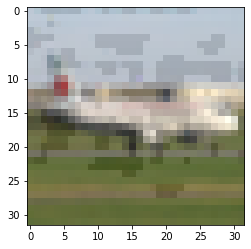


Total accuracy = 80.43 %


[8/30]
Train Accuracy 99.004000


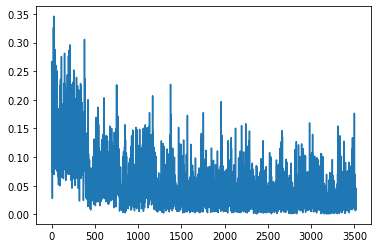

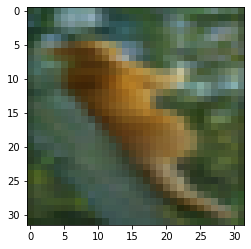

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


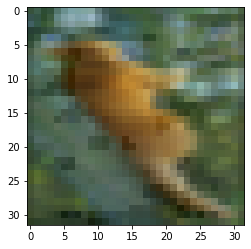


Total accuracy = 81.11 %


[9/30]
Train Accuracy 99.234000


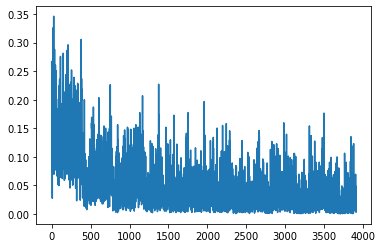

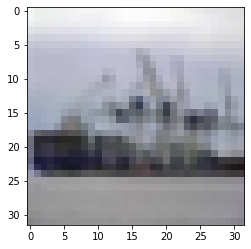

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


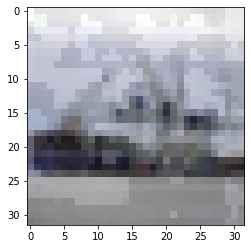


Total accuracy = 80.19 %


[10/30]
Train Accuracy 99.128000


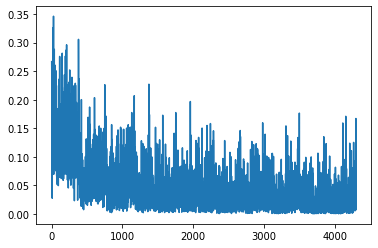

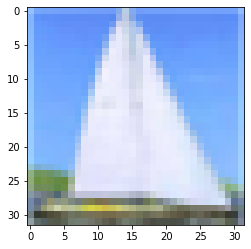

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


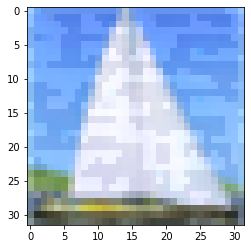


Total accuracy = 80.41 %


[11/30]
Train Accuracy 99.376000


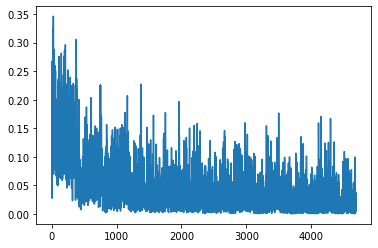

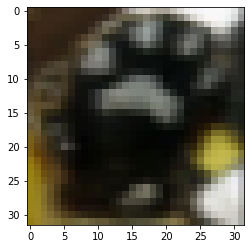

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


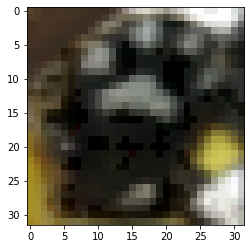


Total accuracy = 80.86 %


[12/30]
Train Accuracy 99.340000


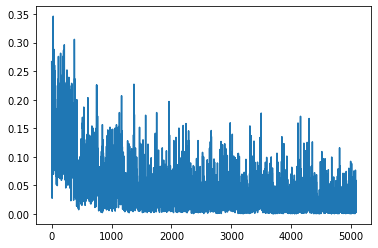

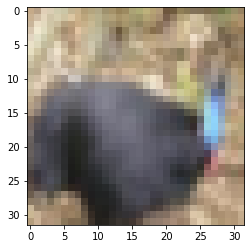

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


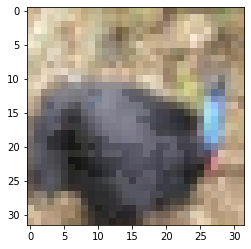


Total accuracy = 81.08 %


[13/30]
Train Accuracy 99.344000


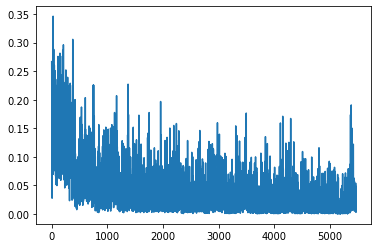

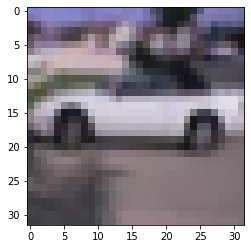

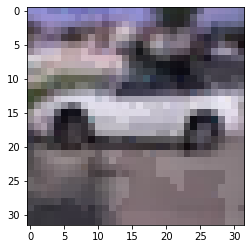


Total accuracy = 81.43 %


[14/30]
Train Accuracy 99.656000


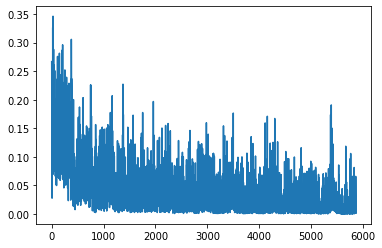

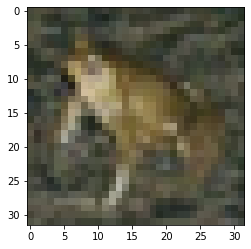

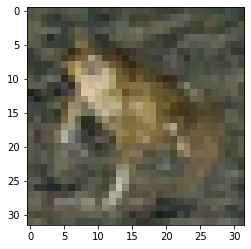


Total accuracy = 81.04 %


[15/30]
Train Accuracy 99.396000


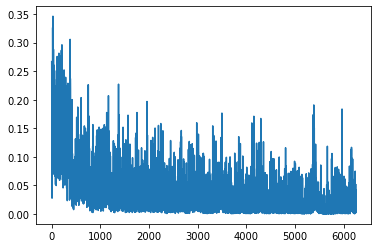

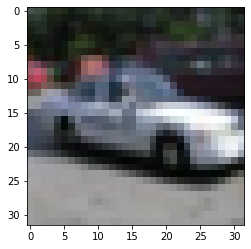

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


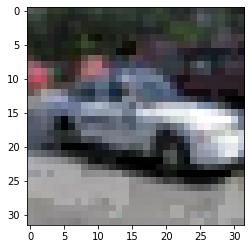


Total accuracy = 81.08 %


[16/30]
Train Accuracy 99.382000


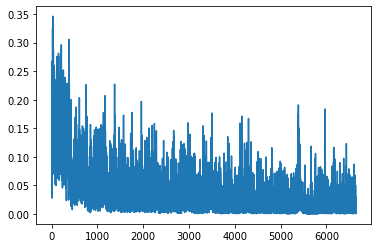

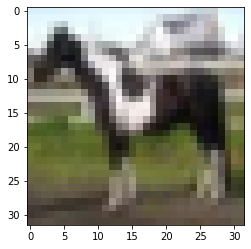

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


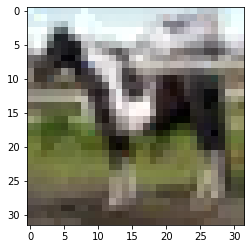


Total accuracy = 81.47 %


[17/30]
Train Accuracy 99.340000


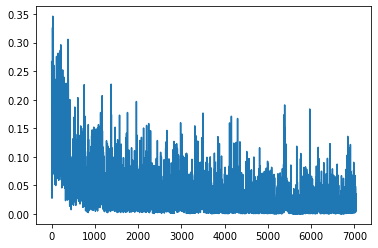

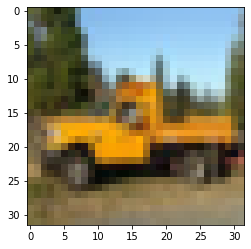

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


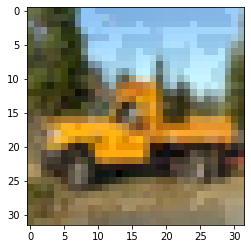


Total accuracy = 80.86 %


[18/30]
Train Accuracy 99.432000


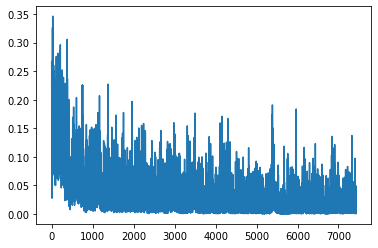

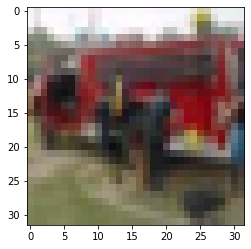

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


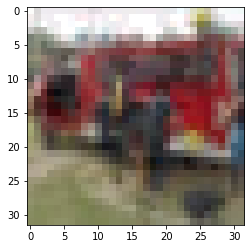


Total accuracy = 80.12 %


[19/30]
Train Accuracy 99.426000


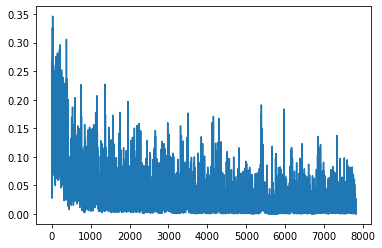

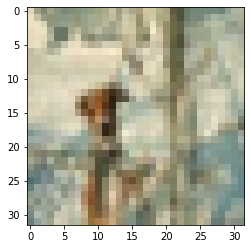

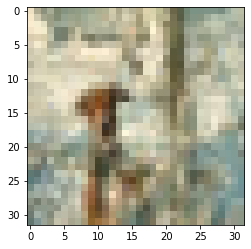


Total accuracy = 80.81 %


[20/30]
Train Accuracy 99.410000


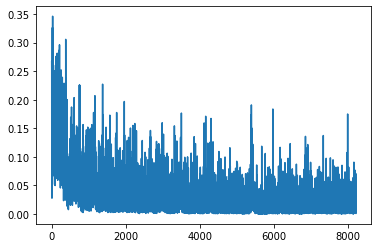

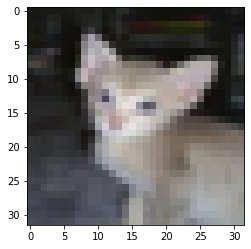

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


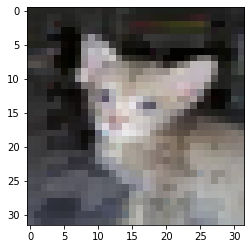


Total accuracy = 80.73 %


[21/30]
Train Accuracy 99.532000


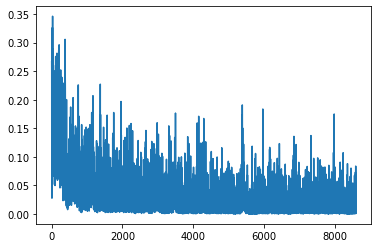

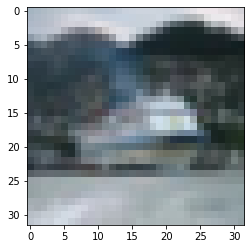

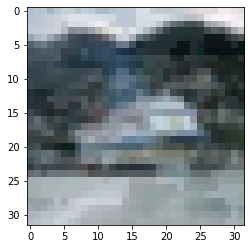


Total accuracy = 80.98 %


[22/30]
Train Accuracy 99.714000


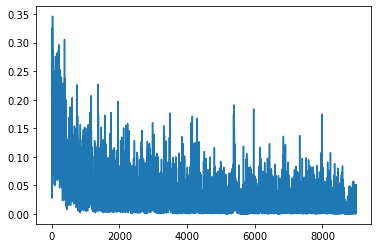

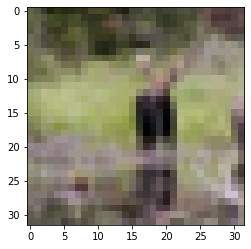

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


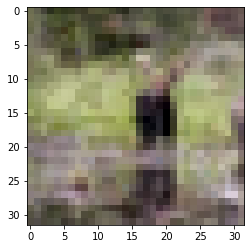


Total accuracy = 80.96 %


[23/30]
Train Accuracy 99.718000


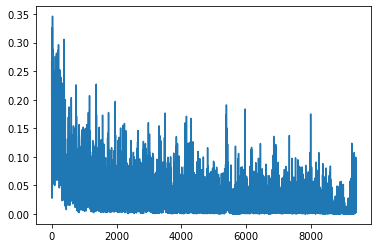

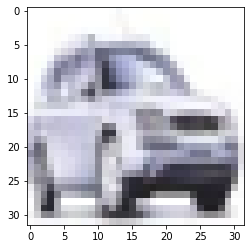

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


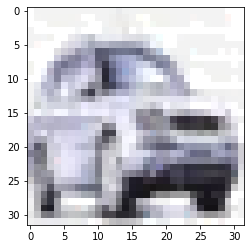


Total accuracy = 80.08 %


[24/30]
Train Accuracy 99.514000


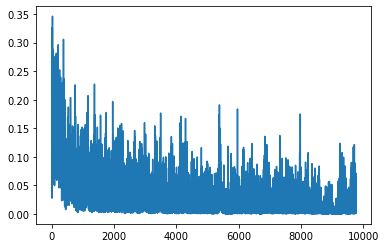

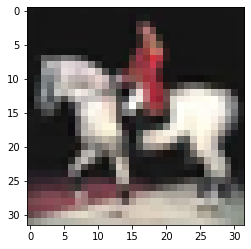

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


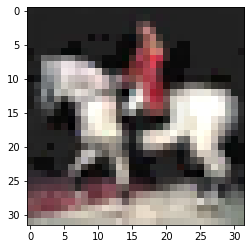


Total accuracy = 80.27 %


[25/30]
Train Accuracy 99.562000


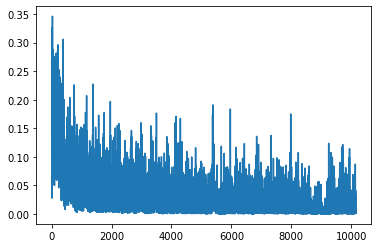

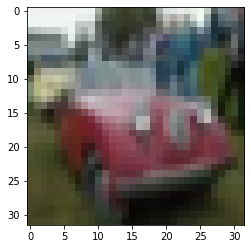

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


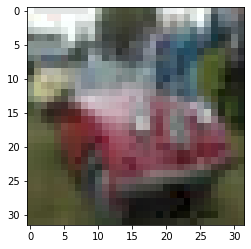


Total accuracy = 81.01 %


[26/30]
Train Accuracy 99.564000


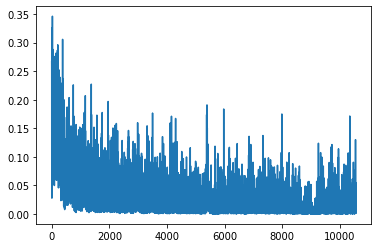

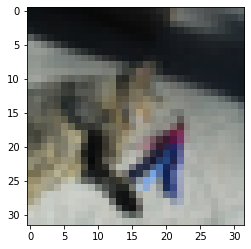

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


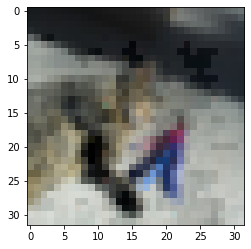


Total accuracy = 80.74 %


[27/30]
Train Accuracy 99.652000


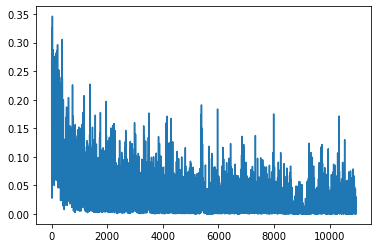

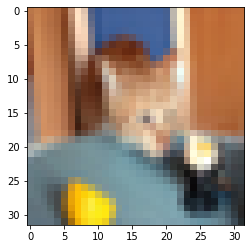

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


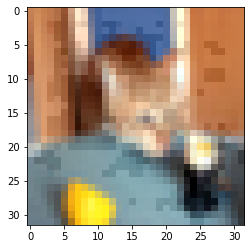


Total accuracy = 80.91 %


[28/30]
Train Accuracy 99.564000


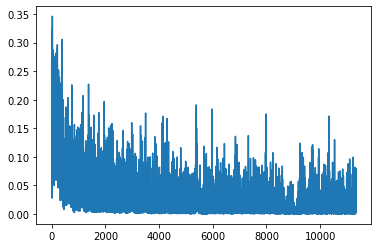

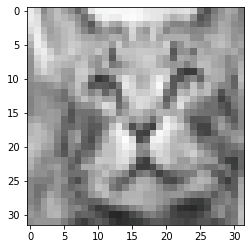

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


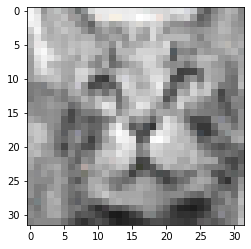


Total accuracy = 80.54 %


[29/30]
Train Accuracy 99.802000


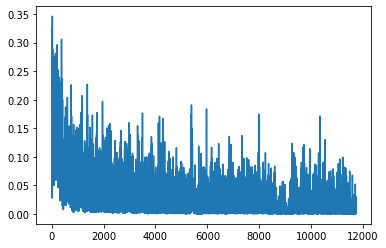

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


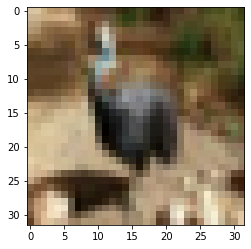

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


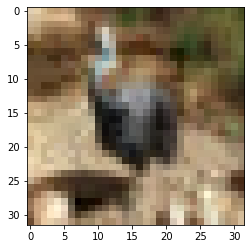


Total accuracy = 81.11 %




In [30]:
lr = 0.01
class_criterion = nn.CrossEntropyLoss()
w = w_list[0][0]
w_mom = torch.zeros(w.size(), requires_grad = False).to(device) 
n_epochs = 30
losses = []
for epoch in range(n_epochs):

    total = 0
    correct = 0

    for batch in cifar10_trainloader:

        imgs, labels = batch
        imgs, labels = imgs.to(device), labels.to(device)

        ### autoencoder classifier

        im_noise = Generator(imgs)
        im_ae = im_noise  + imgs  

        with torch.enable_grad():
            outputs = net.forward_with_param(im_ae, w)
            loss = class_criterion(outputs, labels)                
        gw, = torch.autograd.grad(loss, w, grad_outputs = torch.tensor(lr).to(device),create_graph=True) 
        losses.append(loss.data)

        with torch.no_grad():
            w_mom = 0.9 * w_mom + gw
            w = w.sub(w_mom).requires_grad_()

        ## accuracy calc
        predicted = outputs.argmax(dim=1)
        total += imgs.size(0)
        correct += predicted.eq(labels).sum().item() 

        # evaluate performance on testset at the end of each epoch
    print("[%d/%d]" %(epoch, n_epochs))
    print("Train Accuracy %f" %(correct/total*100))
    plt.plot(losses)
    plt.show()
    out_img = Generator(imgs) + imgs
    imshow(imgs[0,:,:,:].squeeze().cpu().detach().numpy())   
    imshow(out_img[0,:,:,:].squeeze().cpu().detach().numpy()) 
    eval_target_net(net, cifar10_testloader, w) 


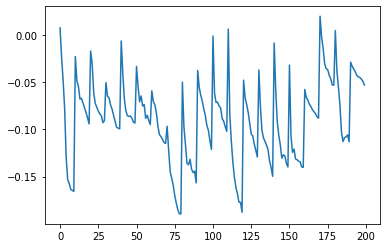

In [32]:
plt.plot(gradient_losses[1000:1200])
plt.show()

In [46]:
with open('data_generalizability.pickle', 'rb') as f:
    [losses, losses2, gradient_losses, out_img, imgs, im_noise_full] = pickle.load(f)

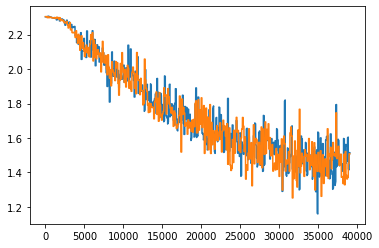

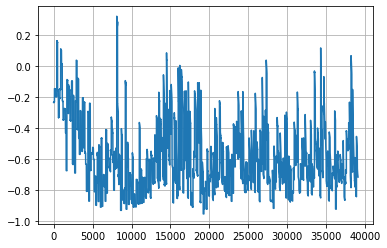

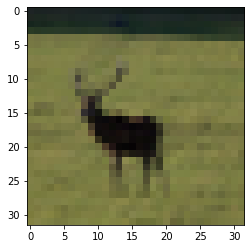

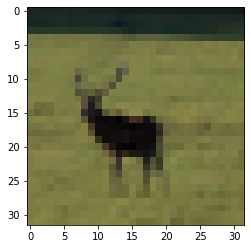

In [34]:
plt.plot(losses)
plt.plot(losses2)
plt.show()
plt.plot(gradient_losses)
plt.grid(True)
plt.show()
# out_img = Generator(imgs) + imgs
imshow(imgs[0,:,:,:].squeeze().cpu().detach().numpy())   
imshow(out_img[0,:,:,:].squeeze().cpu().detach().numpy()) 

Files already downloaded and verified


/home/fmejia/anaconda3/envs/pytorch1.4/lib/python3.6/site-packages/ipykernel_launcher.py:29: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).


[0/30]
Train Accuracy 32.386000


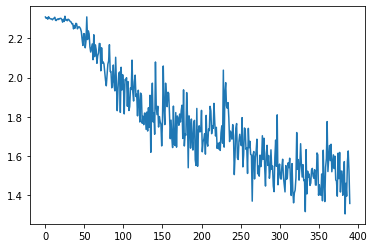


Total accuracy = 42.49 %


[1/30]
Train Accuracy 52.984000


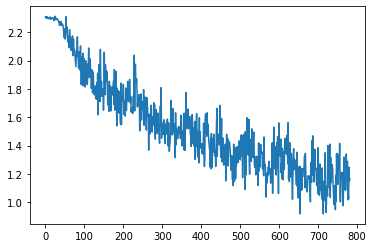


Total accuracy = 57.25 %


[2/30]
Train Accuracy 65.694000


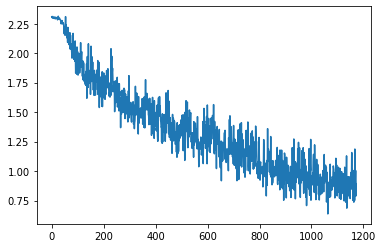


Total accuracy = 68.81 %


[3/30]
Train Accuracy 72.438000


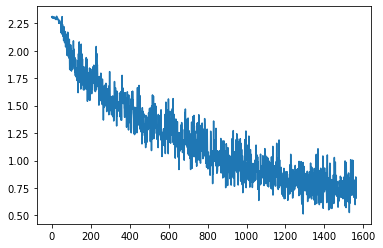


Total accuracy = 72.34 %


[4/30]
Train Accuracy 77.424000


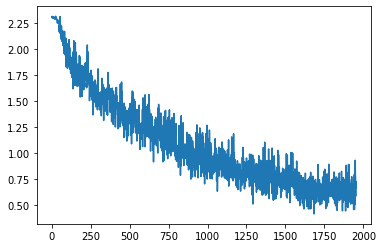


Total accuracy = 75.14 %


[5/30]
Train Accuracy 81.504000


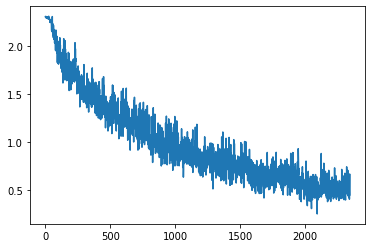


Total accuracy = 78.28 %


[6/30]
Train Accuracy 84.580000


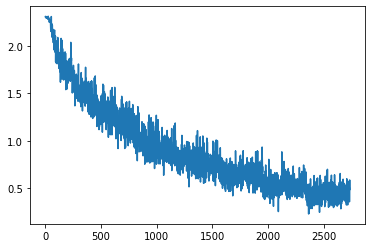


Total accuracy = 76.42 %


[7/30]
Train Accuracy 87.556000


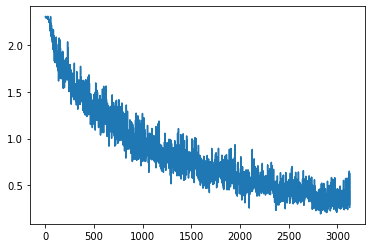


Total accuracy = 77.67 %


[8/30]
Train Accuracy 89.796000


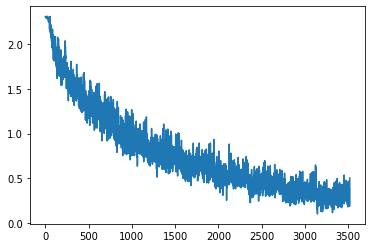


Total accuracy = 78.62 %


[9/30]
Train Accuracy 91.896000


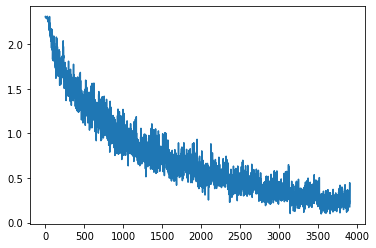


Total accuracy = 78.21 %


[10/30]
Train Accuracy 93.274000


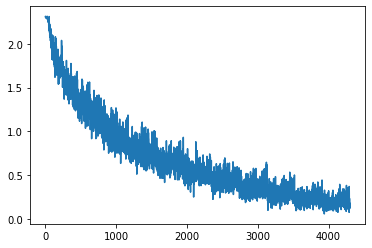


Total accuracy = 79.91 %


[11/30]
Train Accuracy 94.128000


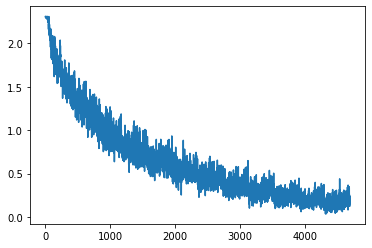


Total accuracy = 78.65 %


[12/30]
Train Accuracy 94.888000


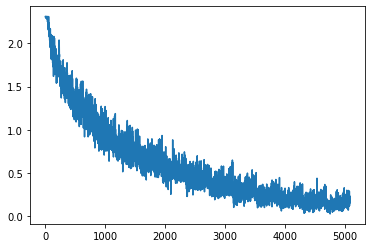


Total accuracy = 78.09 %


[13/30]
Train Accuracy 96.076000


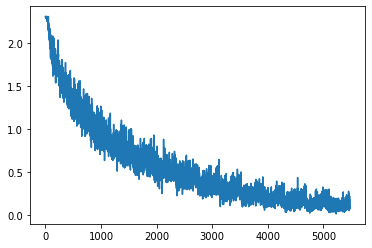


Total accuracy = 79.50 %


[14/30]
Train Accuracy 96.654000


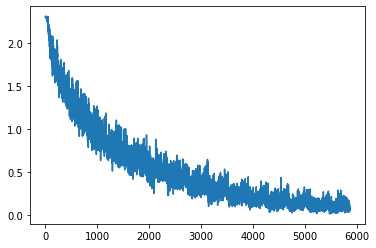


Total accuracy = 80.39 %


[15/30]
Train Accuracy 97.056000


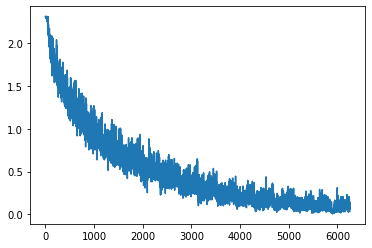


Total accuracy = 80.15 %


[16/30]
Train Accuracy 97.498000


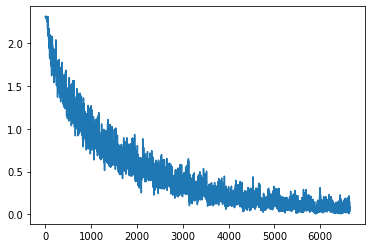


Total accuracy = 80.23 %


[17/30]
Train Accuracy 97.990000


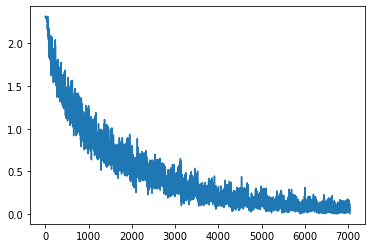


Total accuracy = 81.23 %


[18/30]
Train Accuracy 98.328000


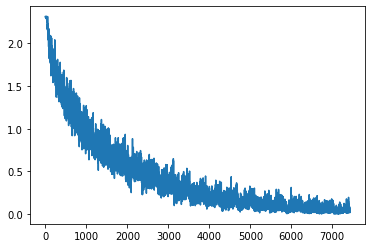


Total accuracy = 80.40 %


[19/30]
Train Accuracy 98.178000


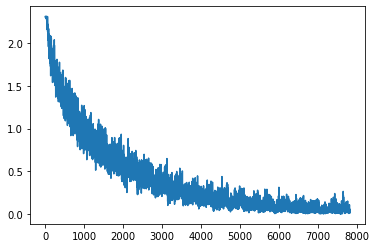


Total accuracy = 80.73 %


[20/30]
Train Accuracy 98.414000


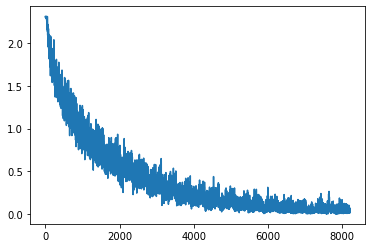


Total accuracy = 81.02 %


[21/30]
Train Accuracy 98.546000


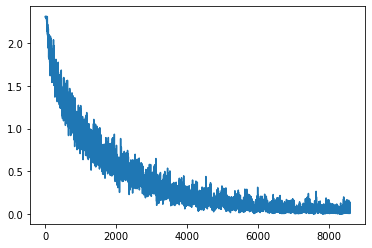


Total accuracy = 80.59 %


[22/30]
Train Accuracy 98.764000


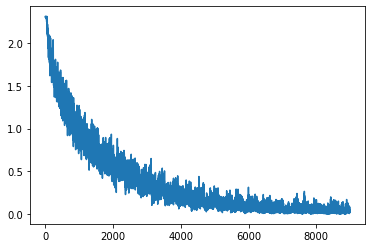


Total accuracy = 80.76 %


[23/30]
Train Accuracy 98.670000


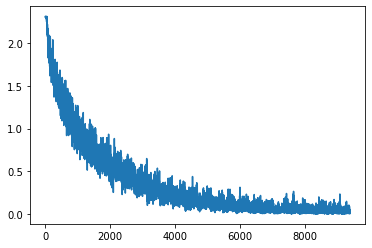


Total accuracy = 80.45 %


[24/30]
Train Accuracy 98.914000


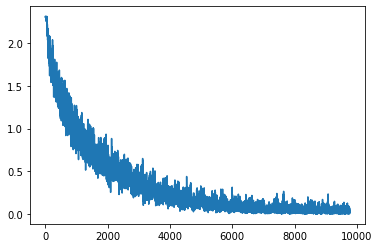


Total accuracy = 80.61 %


[25/30]
Train Accuracy 98.968000


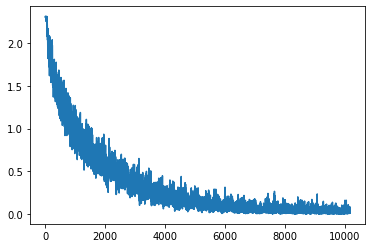


Total accuracy = 81.46 %


[26/30]
Train Accuracy 99.104000


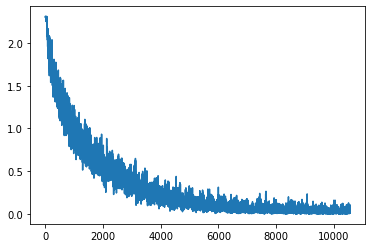


Total accuracy = 81.06 %


[27/30]
Train Accuracy 99.122000


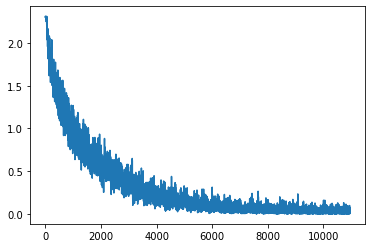


Total accuracy = 81.11 %


[28/30]
Train Accuracy 99.210000


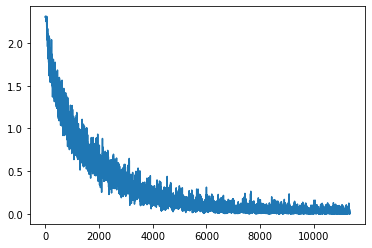


Total accuracy = 80.91 %


[29/30]
Train Accuracy 99.274000


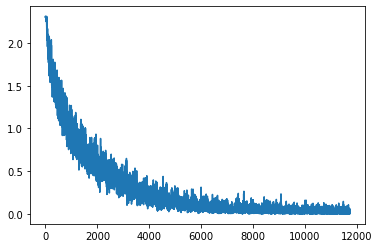


Total accuracy = 80.60 %




In [40]:
losses = []
gradient_losses = []
n_epochs = 30
n_restarts = 1
class_criterion = nn.CrossEntropyLoss()
lr = 0.01

net = VGG()
net.reset() 
net.train()            
w = torch.tensor(net.get_param().cpu().detach().numpy(), requires_grad = True).to(device) 

cifar10_trainset = torchvision.datasets.CIFAR10('/home/fmejia/fmejia/Cypercat/cyphercat/datasets//', train=True, transform=transform, download=True)
trainset = MyDataset(cifar10_trainset)
cifar10_trainloader = torch.utils.data.DataLoader(trainset, batch_size = batch_size, 
                                                      shuffle = True, num_workers=2)

for epoch in range(n_epochs):

    total = 0
    correct = 0

    for batch in cifar10_trainloader:

        imgs, labels, im_ind = batch
        imgs, labels = imgs.to(device), labels.to(device)

        im_noise = torch.tensor(im_noise_full[im_ind,:,:,:], requires_grad = True)

        ### autoencoder classifier       
        im_ae = im_noise  + imgs        

        with torch.enable_grad():
            outputs = net.forward_with_param(im_ae, w)
            loss = class_criterion(outputs, labels)                
        gw, = torch.autograd.grad(loss, w, grad_outputs = torch.tensor(lr).to(device),create_graph=True) 
        losses.append(loss.data)



        ## accuracy calc
        predicted = outputs.argmax(dim=1)
        total += imgs.size(0)
        correct += predicted.eq(labels).sum().item() 
        with torch.no_grad():
            w_mom = 0.9 * w_mom + gw
            w = w.sub(w_mom).requires_grad_()

    # evaluate performance on testset at the end of each epoch
    print("[%d/%d]" %(epoch, n_epochs))
    print("Train Accuracy %f" %(correct/total*100))
    plt.plot(losses)
    plt.plot(losses2)
    plt.show()

    eval_target_net(net, cifar10_testloader, w)



In [41]:
len(losses)

11730

In [44]:
40000/(50000/128)

102.4

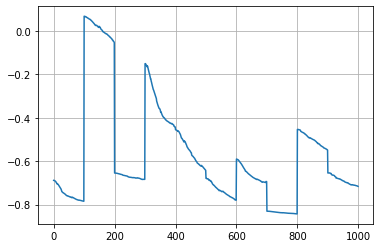

In [48]:
plt.plot(gradient_losses[-1000:])
plt.grid(True)
plt.show()

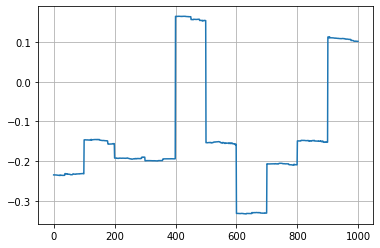

In [51]:
plt.plot(gradient_losses[0:1000])
plt.grid(True)
plt.show()